GAN은 데이터를 생성하는 모델을 만들고 싶을 때 사용

Generator : 가짜 데이터를 생성하는 모델

Discriminator : 생성된 데이터가 진짜인지 가짜인지 구분하는 모델

Generator

- 무작위 숫자를 입력하면 64x64x3 사이즈의 사람얼굴 이미지를 생성함

- 생성한 데이터를 discriminator에 전해줌"



Discriminator

- 64x64x3 사람 이미지를 입력해서 이 이미지가 진짜인지 가짜인지 판단하는 모델임


< GAN>

1. 랜덤숫자를 generator에 집어넣어서 가짜 이미지 50장을 생성

2. 진짜 사람 이미지 50장을 데이터셋에서 가져옴

3. discriminator 모델에 train_on_batch() 함수를 써서 이미지 100장으로 트레이닝

4. 랜덤숫자 noise를 1로 라벨링한 (진짜이미지로 라벨링) 데이터셋을 만들기

5. 그 데이터셋으로 GAN 전체를 train_on_batch() 함수를 써서 트레이닝하기 (이게 generator 트레이닝)

6. epoch



In [ ]:
import os
os.environ['KAGGLE_CONFIG_DIR'] = "/content/drive/MyDrive/빅웨이브/"
!kaggle datasets download -d jessicali9530/celeba-dataset
!unzip -q celeba-dataset.zip -d .

100% 1.32G/1.33G [00:13<00:00, 159MB/s]
100% 1.33G/1.33G [00:13<00:00, 105MB/s]


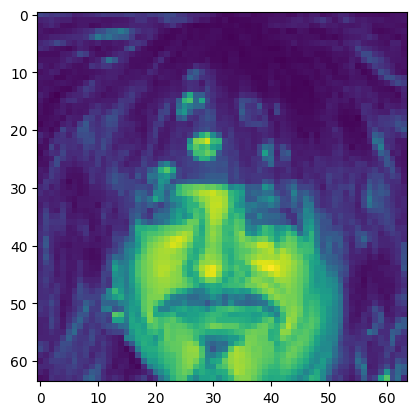

(50000, 64, 64, 1)


In [ ]:
import numpy as np
from PIL import Image

경로들 = os.listdir('/content/img_align_celeba/img_align_celeba') # os.listdir 특정 폴더내의 모든 파일을 리스트로 담아줌

images = []

for I in 경로들[0:50000]:
  숫자화된거 = Image.open('/content/img_align_celeba/img_align_celeba/' + I).crop((20,30,160,180)).convert('L').resize((64,64))
  images.append( np.array(숫자화된거) )

import matplotlib.pyplot as plt
plt.imshow(images[1])
plt.show()

# PIL.Image.open 이미지를 쉽게 숫자로 바꿀 수 있음, 리사이징이나 crop도 쉽게 가능
# crop((20, 30, 160, 180)) 사진 가로폭을 가운데 20px~160px 부분만 남기고 사진 세로폭을 30px~180px 부분만 남기고 자르라는 뜻
# 배경을 자르고 얼굴만 남김


images = np.array(images)
images = np.divide(images, 255) # 모든 값을 0~1사이로 축약하려고 255로 나눈겁

images = images.reshape( 50000,64,64,1 )
# color shape (50000, 64, 64, 3)
# 흑백 images shape (50000, 64, 64)
# Conv2D 레이어를 사용할 것인데 인풋이 4차원 데이터야 한다.
# 흑백이미지 데이터셋을 reshape로 4차원 데이터로 만들어줌
print(images.shape)

In [ ]:
import tensorflow as tf

discriminator = tf.keras.models.Sequential([
  tf.keras.layers.Conv2D(64, (3,3), strides=(2, 2), padding='same', input_shape=[64,64,1]), # 이미지 분석을 위한 Conv2D 레이어
  tf.keras.layers.LeakyReLU(alpha=0.2), # ReLU는 음의 값을 0으로 만들어줌, LeakyReLU 0미만의 값을 다 0으로 바꾸는게 아니라 0.01을 곱해서 작게만 만들어줍니다.
  tf.keras.layers.Dropout(0.4),
  tf.keras.layers.Conv2D(64, (3,3), strides=(2, 2), padding='same'),
  tf.keras.layers.LeakyReLU(alpha=0.2),
  tf.keras.layers.Dropout(0.4),
  tf.keras.layers.Flatten(),
  tf.keras.layers.Dense(1, activation='sigmoid') # 이미지 입력하면 진짜/가짜 판정해줄
])

In [ ]:
generator = tf.keras.models.Sequential([
  tf.keras.layers.Dense(4 * 4 * 256, input_shape=(100,) ),
  tf.keras.layers.Reshape((4, 4, 256)),
  tf.keras.layers.Conv2DTranspose(256, 3, strides=2, padding='same'),
  tf.keras.layers.LeakyReLU(alpha=0.2),
  tf.keras.layers.BatchNormalization(),
  tf.keras.layers.Conv2DTranspose(128, 3, strides=2, padding='same'),
  tf.keras.layers.LeakyReLU(alpha=0.2),
  tf.keras.layers.BatchNormalization(),
  tf.keras.layers.Conv2DTranspose(64, 3, strides=2, padding='same'),
  tf.keras.layers.LeakyReLU(alpha=0.2),
  tf.keras.layers.BatchNormalization(),
  tf.keras.layers.Conv2DTranspose(1, 3, strides=2, padding='same', activation='sigmoid')
])

generator.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_1 (Dense)             (None, 4096)              413696    
                                                                 
 reshape (Reshape)           (None, 4, 4, 256)         0         
                                                                 
 conv2d_transpose (Conv2DTra  (None, 8, 8, 256)        590080    
 nspose)                                                         
                                                                 
 leaky_re_lu_2 (LeakyReLU)   (None, 8, 8, 256)         0         
                                                                 
 batch_normalization (BatchN  (None, 8, 8, 256)        1024      
 ormalization)                                                   
                                                                 
 conv2d_transpose_1 (Conv2DT  (None, 16, 16, 128)     

In [ ]:
GAN = tf.keras.models.Sequential([generator, discriminator])

discriminator.compile(optimizer='adam',loss='binary_crossentropy')
print(discriminator.trainable)

In [ ]:
GAN = tf.keras.models.Sequential([generator, discriminator])

discriminator.compile(optimizer='adam',loss='binary_crossentropy')

discriminator.trainable = False #
GAN.compile(optimizer='adam', loss='binary_crossentropy')

In [ ]:
def predict_pic():
  랜덤숫자 = np.random.uniform(-1,1,size=(10,100))
  예측 = generator.predict(랜덤숫자)

  for i in range(10):
    plt.subplot(2, 5, i+1)
    plt.imshow(예측[i].reshape(64,64), cmap='gray')
    plt.axis('off')
  plt.tight_layout()
  plt.show()

지금 epoch 몇회냐면 0
1/1 [==============================] - 0s 20ms/step


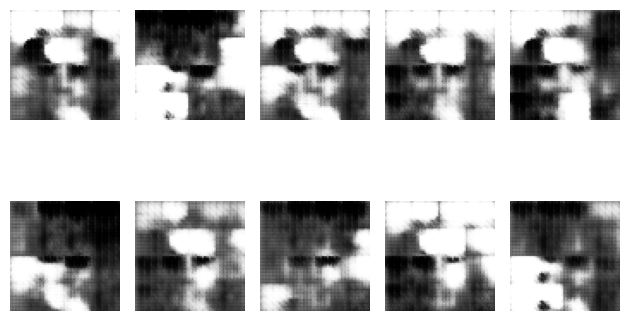

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.11435067653656 GAN 0.8406146764755249
지금 epoch 몇회냐면 1
1/1 [==============================] - 0s 20ms/step


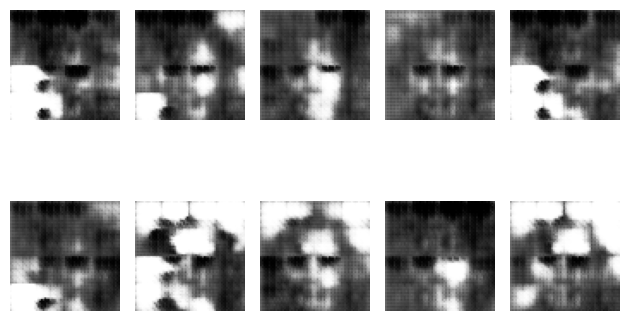

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0884010195732117 GAN 0.8314669728279114
지금 epoch 몇회냐면 2
1/1 [==============================] - 0s 20ms/step


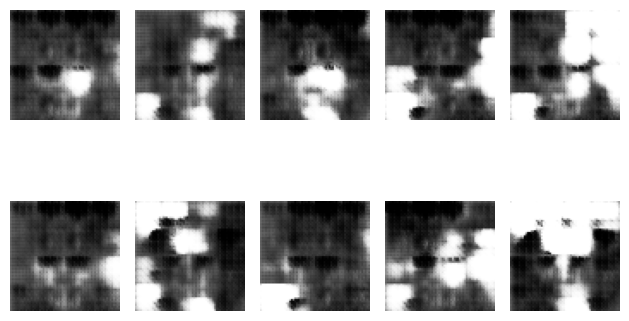

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 7ms/step
이번 epoch의 최종 loss는 Discriminator 1.1123194694519043 GAN 0.8455163836479187
지금 epoch 몇회냐면 3
1/1 [==============================] - 0s 28ms/step


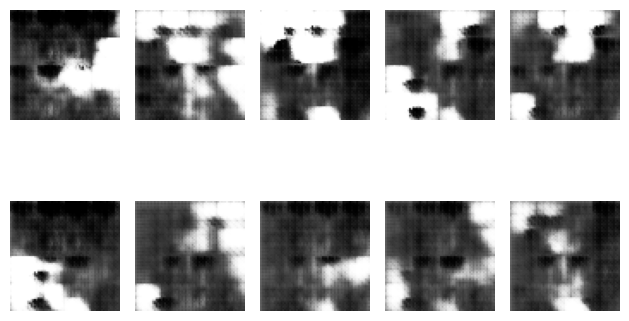

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.1157538890838623 GAN 0.9084572792053223
지금 epoch 몇회냐면 4
1/1 [==============================] - 0s 24ms/step


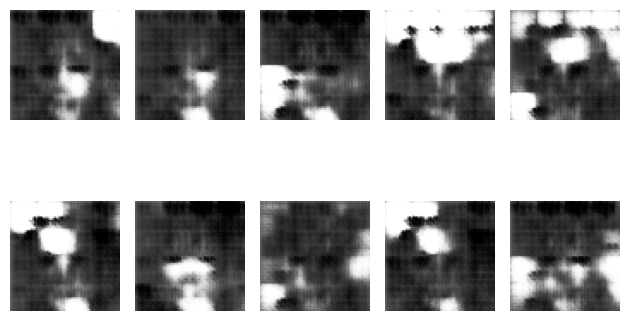

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.0604283809661865 GAN 1.0969629287719727
지금 epoch 몇회냐면 5
1/1 [==============================] - 0s 20ms/step


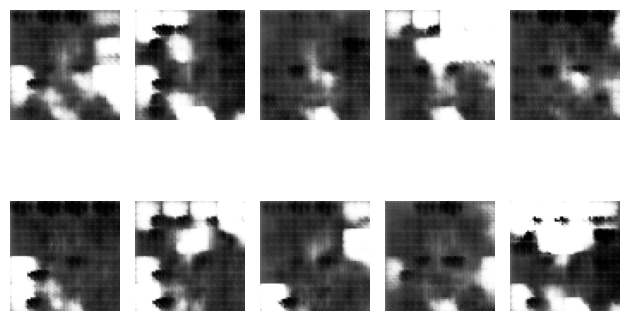

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.025574803352356 GAN 1.045172929763794
지금 epoch 몇회냐면 6
1/1 [==============================] - 0s 25ms/step


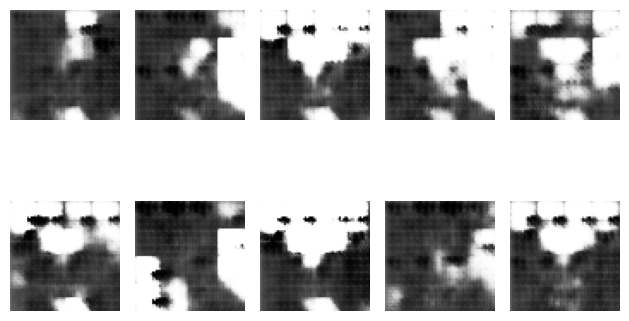

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0260581970214844 GAN 1.1294872760772705
지금 epoch 몇회냐면 7
1/1 [==============================] - 0s 42ms/step


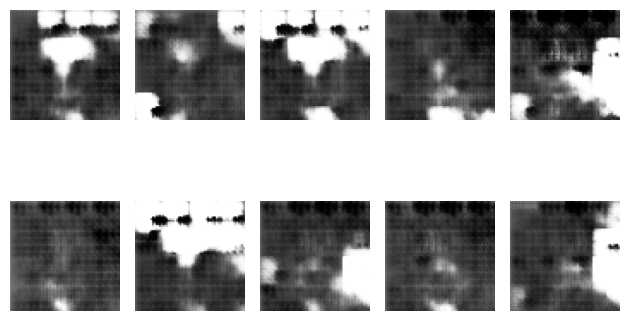

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 0.9596087336540222 GAN 1.1653610467910767
지금 epoch 몇회냐면 8
1/1 [==============================] - 0s 41ms/step


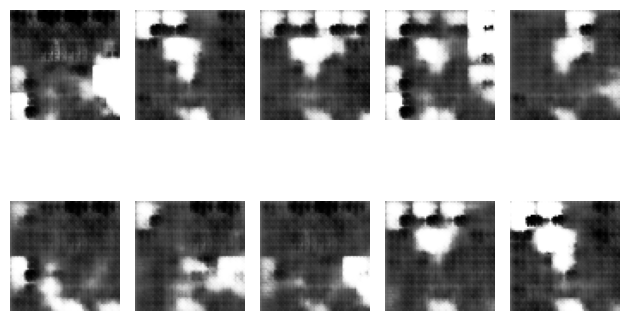

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0136115550994873 GAN 1.333406686782837
지금 epoch 몇회냐면 9
1/1 [==============================] - 0s 20ms/step


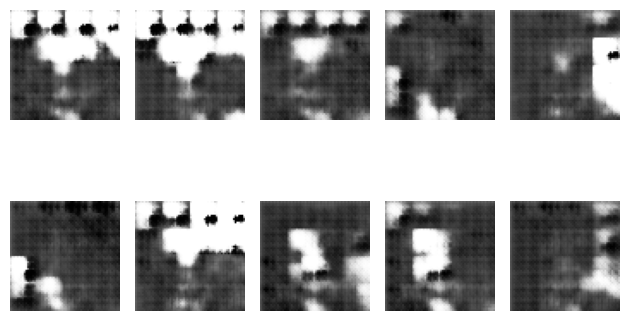

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 8ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.0936325192451477 GAN 1.1553536653518677
지금 epoch 몇회냐면 10
1/1 [==============================] - 0s 30ms/step


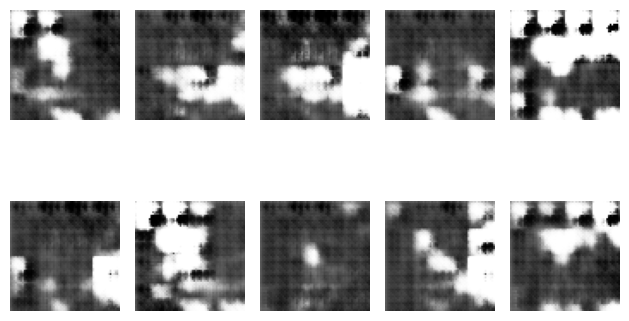

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.290558934211731 GAN 1.2074488401412964
지금 epoch 몇회냐면 11
1/1 [==============================] - 0s 22ms/step


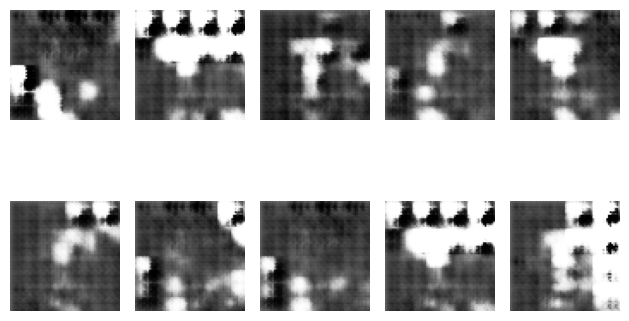

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 3ms/step
이번 epoch의 최종 loss는 Discriminator 1.1937373876571655 GAN 1.1494171619415283
지금 epoch 몇회냐면 12
1/1 [==============================] - 0s 25ms/step


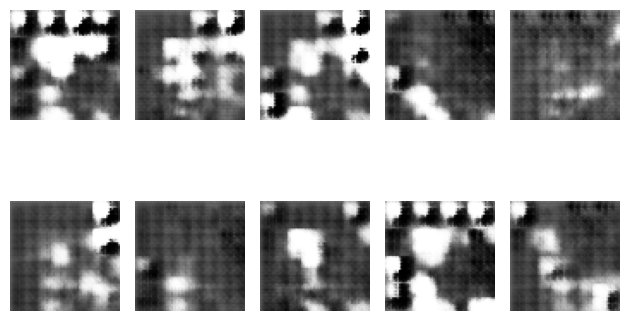

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.1360989809036255 GAN 1.3013761043548584
지금 epoch 몇회냐면 13
1/1 [==============================] - 0s 26ms/step


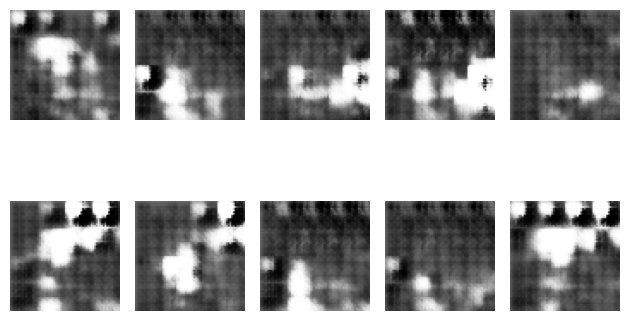

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.051145851612091 GAN 1.2579642534255981
지금 epoch 몇회냐면 14
1/1 [==============================] - 0s 20ms/step


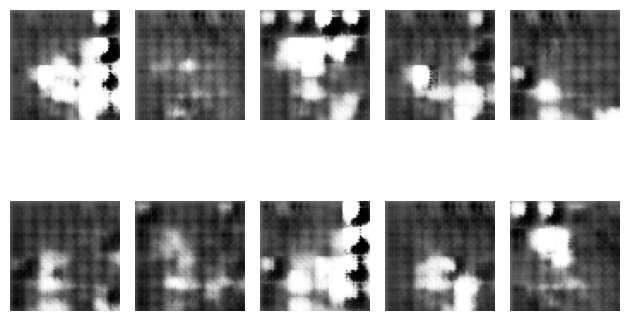

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 8ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 7ms/step
이번 epoch의 최종 loss는 Discriminator 1.0241427719593048 GAN 1.2342870235443115
지금 epoch 몇회냐면 15
1/1 [==============================] - 0s 21ms/step


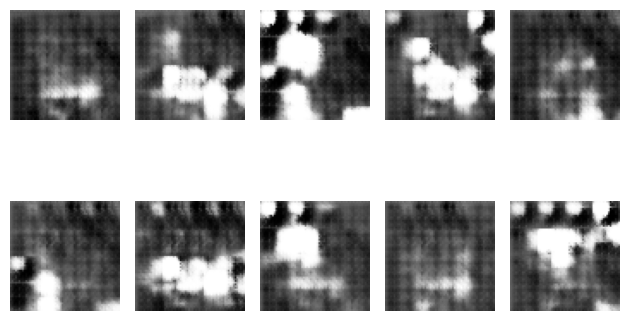

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 7ms/step
이번 epoch의 최종 loss는 Discriminator 0.9755885303020477 GAN 1.4145106077194214
지금 epoch 몇회냐면 16
1/1 [==============================] - 0s 38ms/step


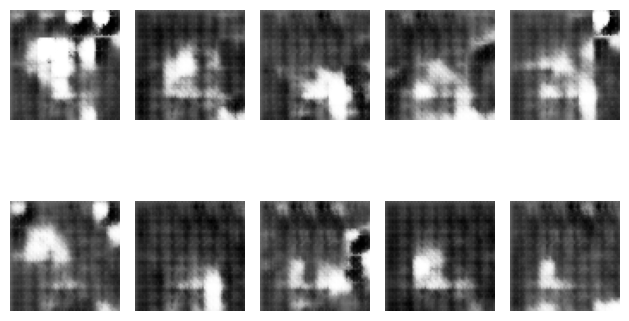

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.0099428296089172 GAN 1.1024564504623413
지금 epoch 몇회냐면 17
1/1 [==============================] - 0s 59ms/step


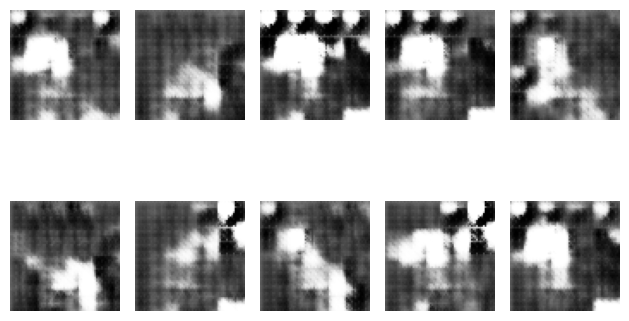

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 0.9814214408397675 GAN 1.3533791303634644
지금 epoch 몇회냐면 18
1/1 [==============================] - 0s 49ms/step


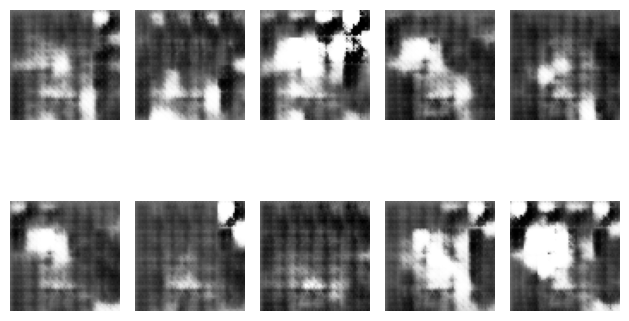

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0202493965625763 GAN 1.1657365560531616
지금 epoch 몇회냐면 19
1/1 [==============================] - 0s 41ms/step


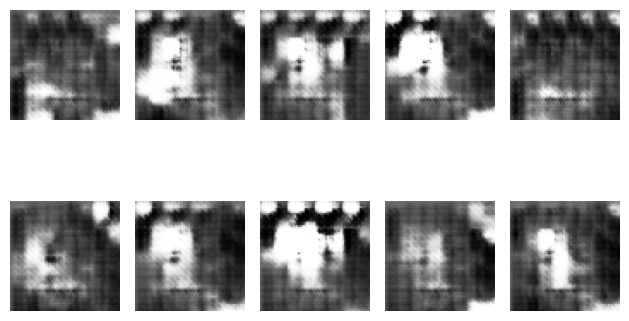

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 0.9841586053371429 GAN 1.162454605102539
지금 epoch 몇회냐면 20
1/1 [==============================] - 0s 23ms/step


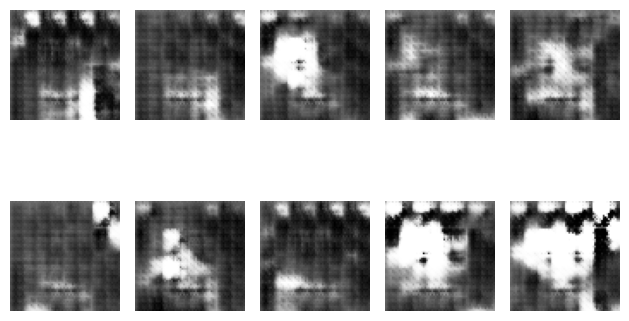

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.1177393794059753 GAN 1.0979431867599487
지금 epoch 몇회냐면 21
1/1 [==============================] - 0s 18ms/step


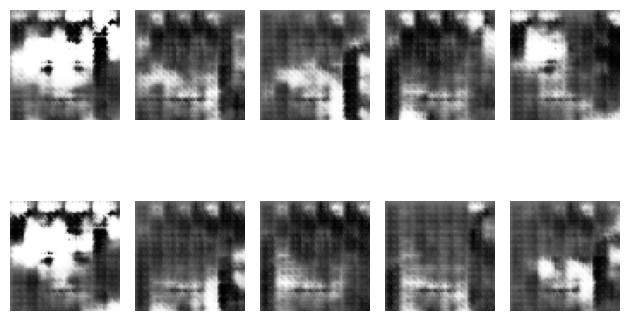

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 9ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 8ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.218446969985962 GAN 1.0824012756347656
지금 epoch 몇회냐면 22
1/1 [==============================] - 0s 24ms/step


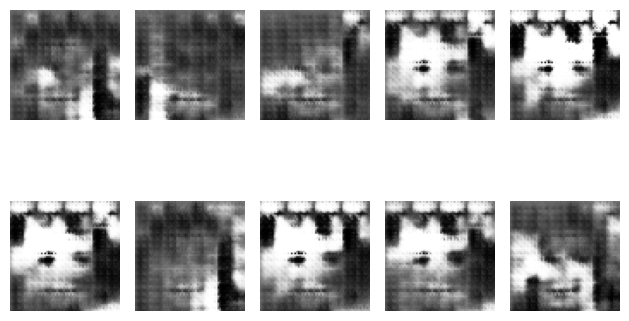

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 10ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.2305007576942444 GAN 0.9552109241485596
지금 epoch 몇회냐면 23
1/1 [==============================] - 0s 19ms/step


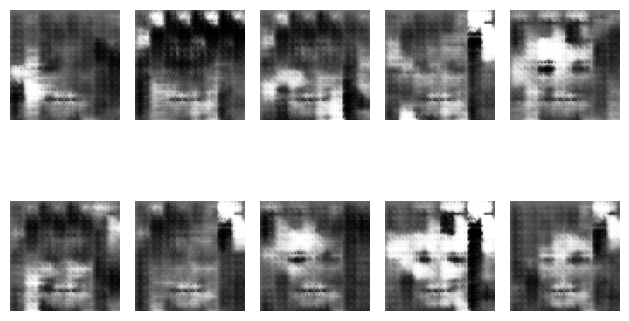

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.1999472975730896 GAN 0.8833039402961731
지금 epoch 몇회냐면 24
1/1 [==============================] - 0s 29ms/step


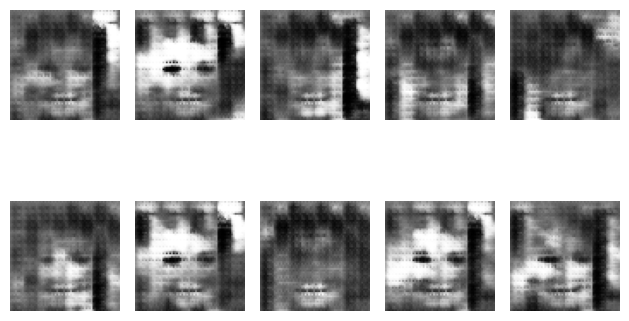

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.152517020702362 GAN 0.9531108736991882
지금 epoch 몇회냐면 25
1/1 [==============================] - 0s 21ms/step


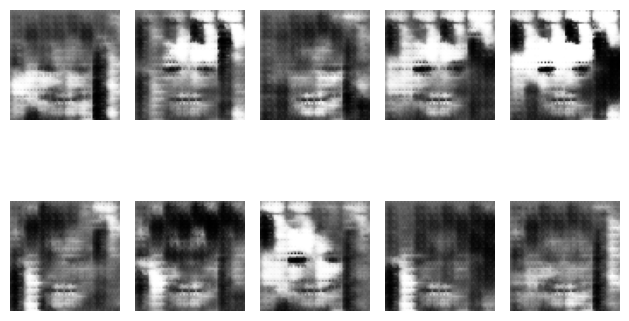

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.1764581203460693 GAN 0.9381186366081238
지금 epoch 몇회냐면 26
1/1 [==============================] - 0s 21ms/step


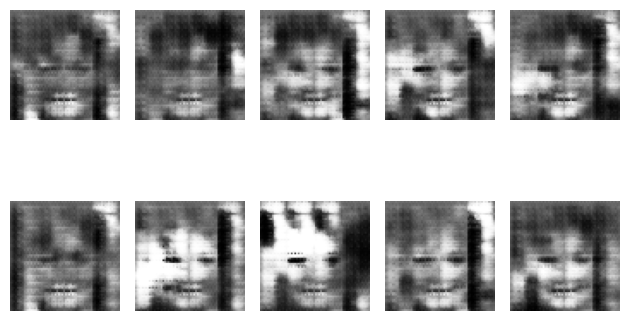

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 7ms/step
이번 epoch의 최종 loss는 Discriminator 1.358140230178833 GAN 0.9885700941085815
지금 epoch 몇회냐면 27
1/1 [==============================] - 0s 54ms/step


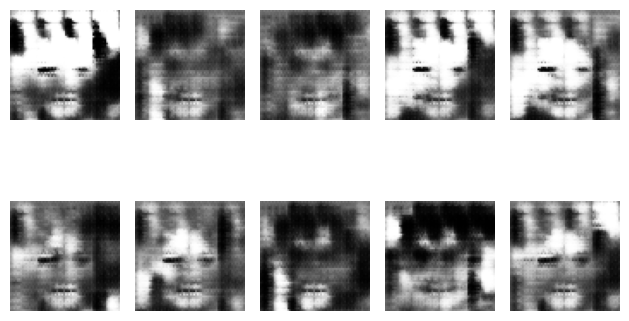

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.4544123411178589 GAN 0.992508053779602
지금 epoch 몇회냐면 28
1/1 [==============================] - 0s 41ms/step


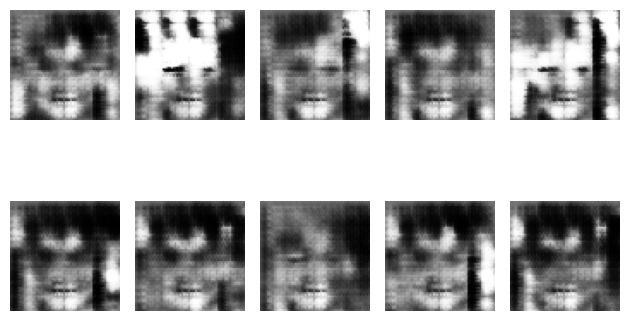

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.9477328062057495 GAN 0.7638830542564392
지금 epoch 몇회냐면 29
1/1 [==============================] - 0s 54ms/step


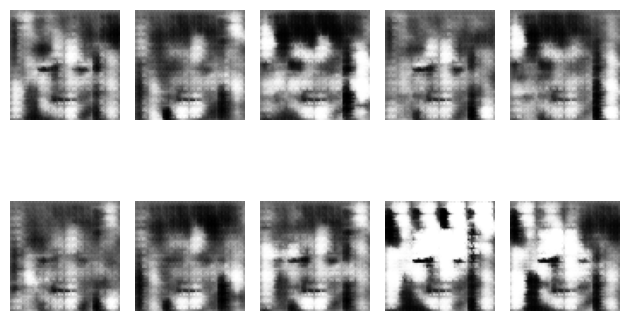

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 2.175390064716339 GAN 0.7694302797317505
지금 epoch 몇회냐면 30
1/1 [==============================] - 0s 32ms/step


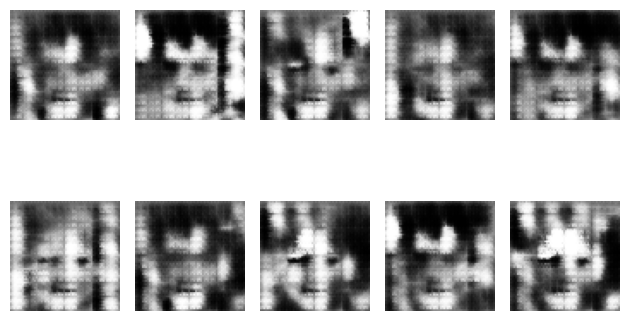

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.9301352500915527 GAN 1.0369718074798584
지금 epoch 몇회냐면 31
1/1 [==============================] - 0s 29ms/step


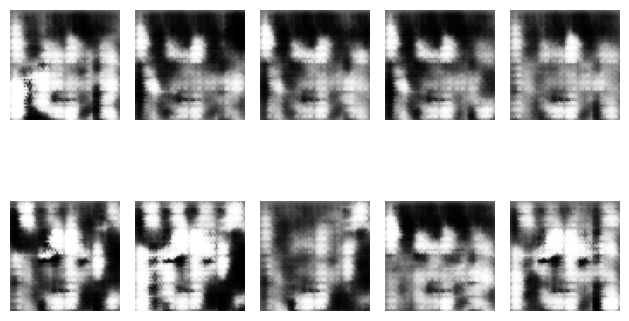

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.466796100139618 GAN 1.2098338603973389
지금 epoch 몇회냐면 32
1/1 [==============================] - 0s 32ms/step


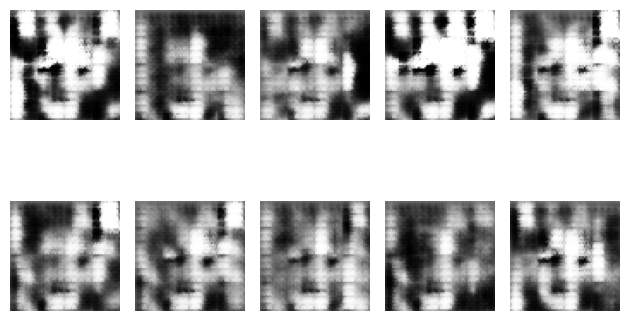

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0769140124320984 GAN 1.326192855834961
지금 epoch 몇회냐면 33
1/1 [==============================] - 0s 31ms/step


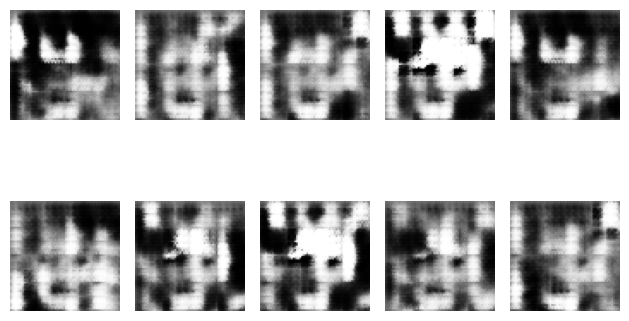

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 0.8960571885108948 GAN 1.3888249397277832
지금 epoch 몇회냐면 34
1/1 [==============================] - 0s 31ms/step


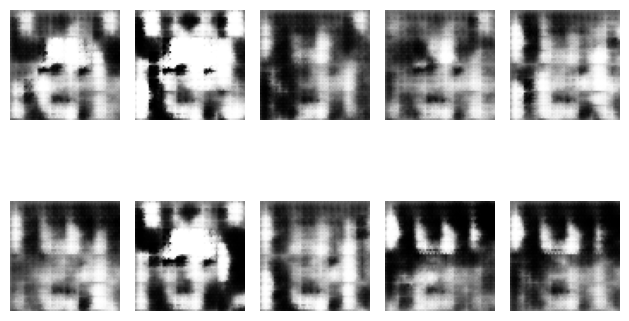

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.0106156170368195 GAN 1.3572734594345093
지금 epoch 몇회냐면 35
1/1 [==============================] - 0s 31ms/step


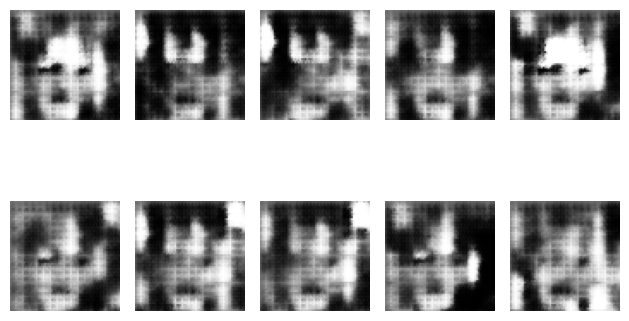

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.2539278268814087 GAN 1.190739393234253
지금 epoch 몇회냐면 36
1/1 [==============================] - 0s 29ms/step


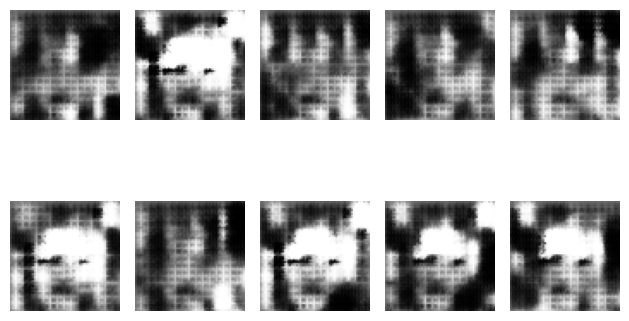

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 7ms/step
이번 epoch의 최종 loss는 Discriminator 1.277030885219574 GAN 0.9737470149993896
지금 epoch 몇회냐면 37
1/1 [==============================] - 0s 42ms/step


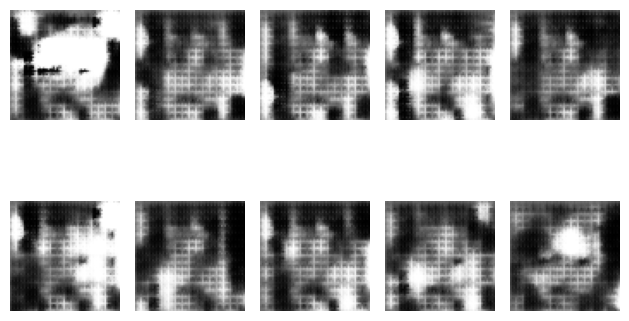

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.1589423418045044 GAN 0.9953926205635071
지금 epoch 몇회냐면 38
1/1 [==============================] - 0s 49ms/step


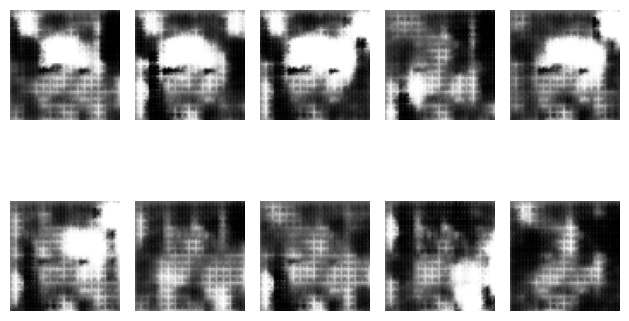

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.147481381893158 GAN 0.9997828602790833
지금 epoch 몇회냐면 39
1/1 [==============================] - 0s 51ms/step


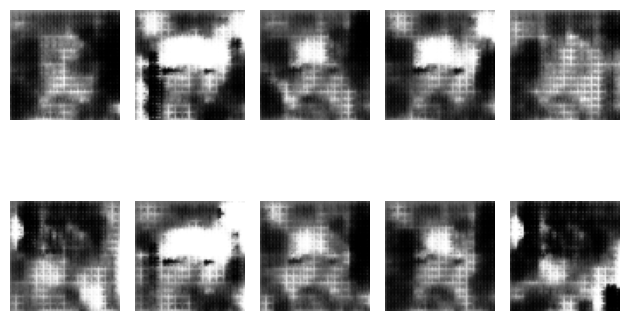

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 9ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.293756127357483 GAN 0.9511408805847168
지금 epoch 몇회냐면 40
1/1 [==============================] - 0s 64ms/step


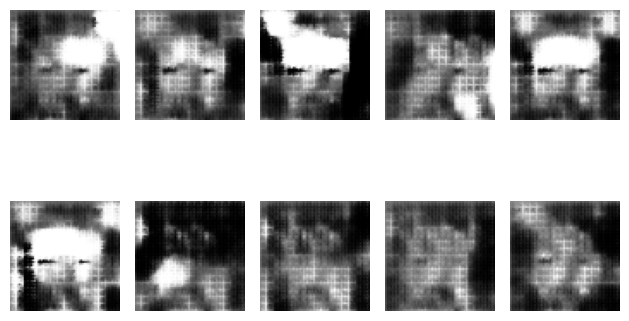

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.399025022983551 GAN 0.7988596558570862
지금 epoch 몇회냐면 41
1/1 [==============================] - 0s 32ms/step


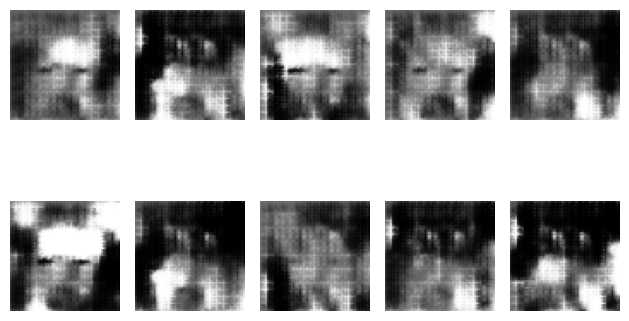

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.5013753175735474 GAN 0.8170562386512756
지금 epoch 몇회냐면 42
1/1 [==============================] - 0s 33ms/step


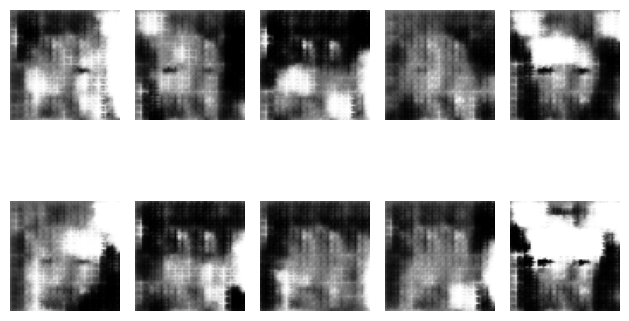

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 8ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.606224536895752 GAN 0.7972453236579895
지금 epoch 몇회냐면 43
1/1 [==============================] - 0s 32ms/step


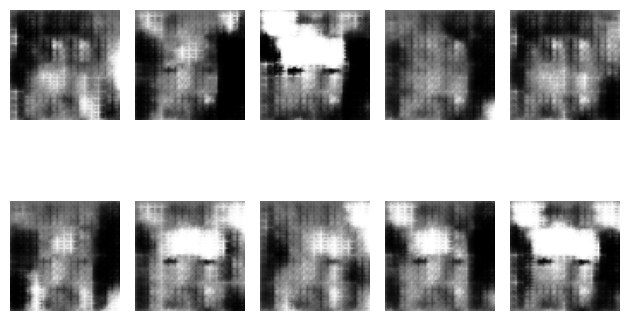

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.5176637172698975 GAN 0.8995597958564758
지금 epoch 몇회냐면 44
1/1 [==============================] - 0s 33ms/step


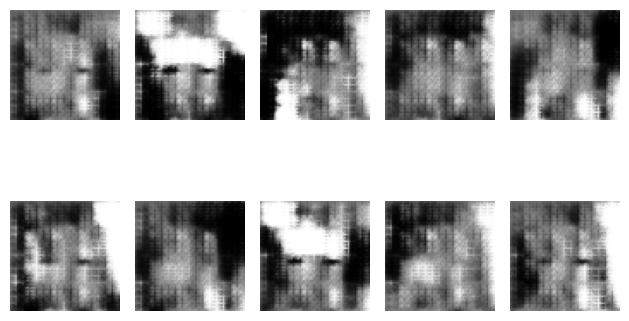

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.3796245455741882 GAN 0.8912367820739746
지금 epoch 몇회냐면 45
1/1 [==============================] - 0s 27ms/step


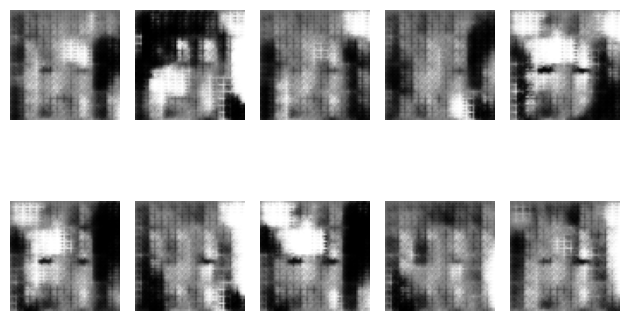

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.155171811580658 GAN 1.042048692703247
지금 epoch 몇회냐면 46
1/1 [==============================] - 0s 30ms/step


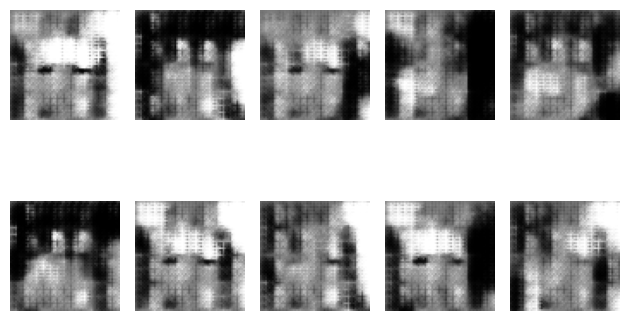

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.1048895120620728 GAN 1.0647830963134766
지금 epoch 몇회냐면 47
1/1 [==============================] - 0s 36ms/step


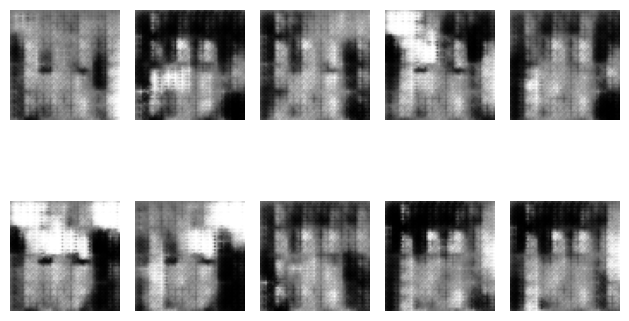

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.036086618900299 GAN 1.1563074588775635
지금 epoch 몇회냐면 48
1/1 [==============================] - 0s 43ms/step


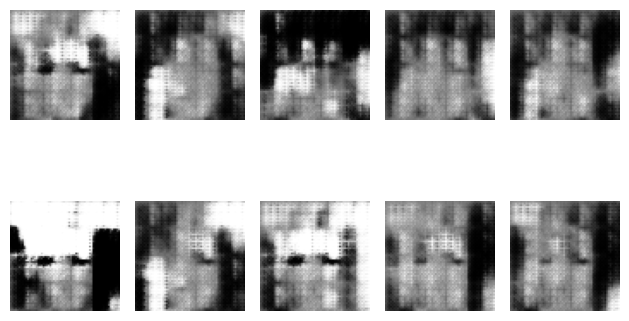

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.9118471741676331 GAN 1.1307765245437622
지금 epoch 몇회냐면 49
1/1 [==============================] - 0s 65ms/step


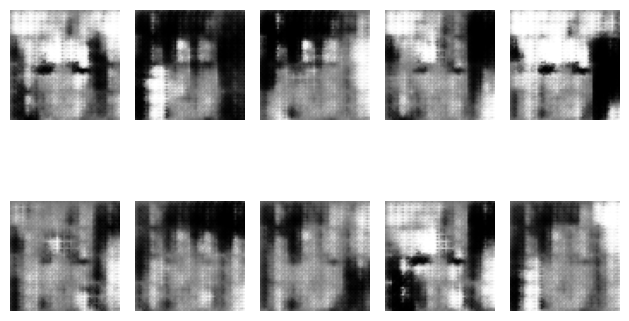

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 0.9357447028160095 GAN 1.1220147609710693
지금 epoch 몇회냐면 50
1/1 [==============================] - 0s 30ms/step


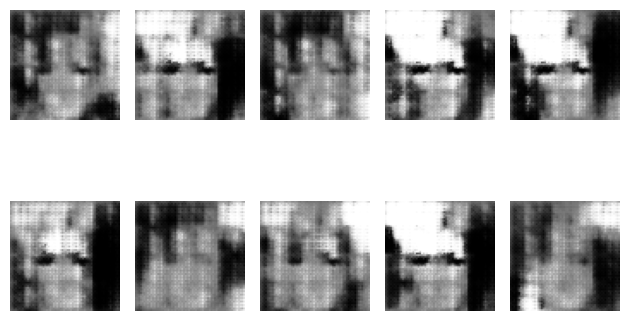

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0063612461090088 GAN 0.9805799722671509
지금 epoch 몇회냐면 51
1/1 [==============================] - 0s 37ms/step


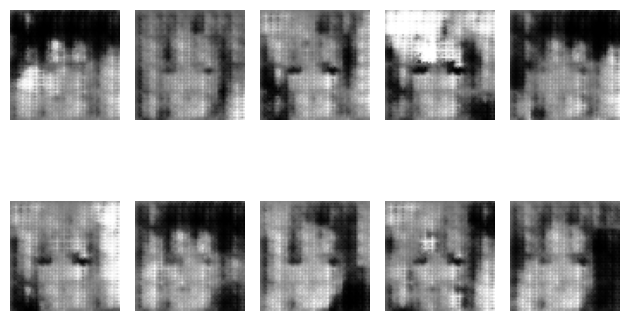

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0949019193649292 GAN 1.035865068435669
지금 epoch 몇회냐면 52
1/1 [==============================] - 0s 41ms/step


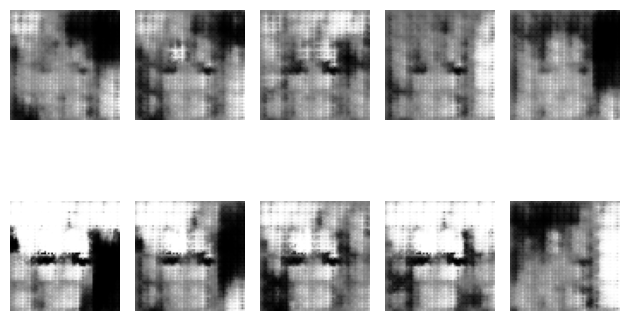

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.2051507234573364 GAN 0.9695523977279663
지금 epoch 몇회냐면 53
1/1 [==============================] - 0s 30ms/step


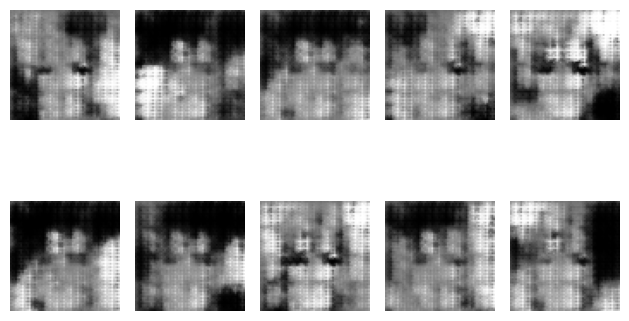

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.392702341079712 GAN 0.9480001330375671
지금 epoch 몇회냐면 54
1/1 [==============================] - 0s 29ms/step


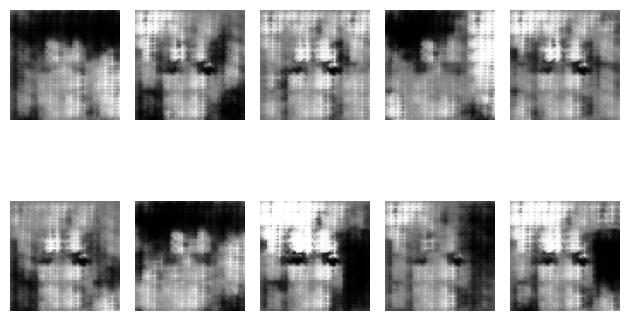

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.4135841727256775 GAN 0.8919047117233276
지금 epoch 몇회냐면 55
1/1 [==============================] - 0s 32ms/step


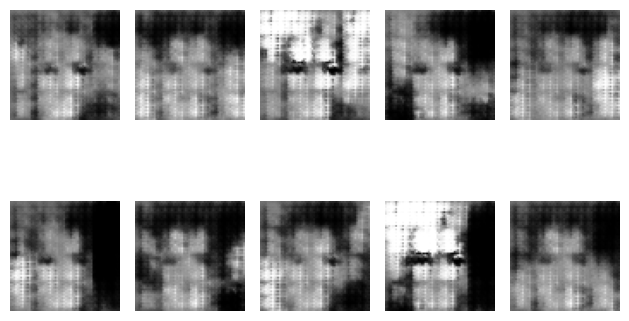

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 7ms/step
이번 epoch의 최종 loss는 Discriminator 1.3669604063034058 GAN 0.9045872092247009
지금 epoch 몇회냐면 56
1/1 [==============================] - 0s 49ms/step


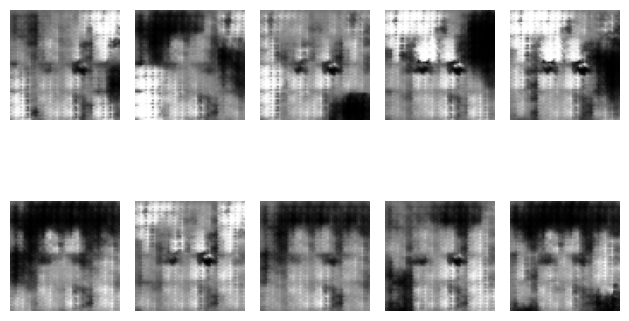

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 10ms/step
이번 epoch의 최종 loss는 Discriminator 1.3510474562644958 GAN 0.8714703917503357
지금 epoch 몇회냐면 57
1/1 [==============================] - 0s 66ms/step


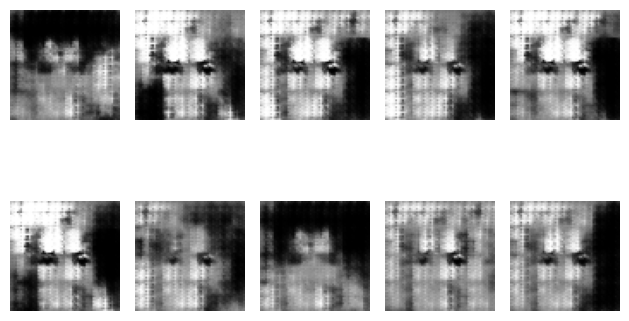

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.3346704840660095 GAN 0.9161450862884521
지금 epoch 몇회냐면 58
1/1 [==============================] - 0s 47ms/step


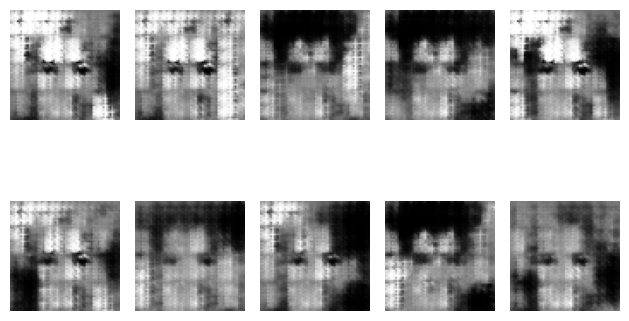

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.2882157564163208 GAN 0.908711314201355
지금 epoch 몇회냐면 59
1/1 [==============================] - 0s 31ms/step


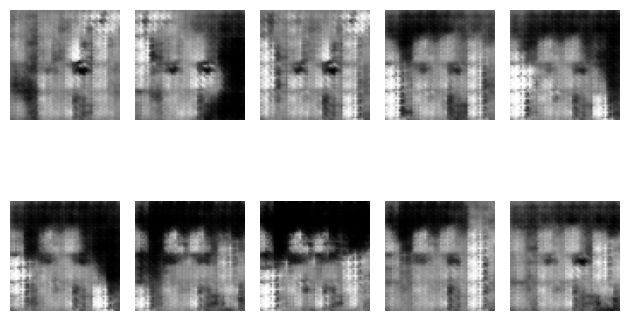

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.15033757686615 GAN 0.9551488161087036
지금 epoch 몇회냐면 60
1/1 [==============================] - 0s 30ms/step


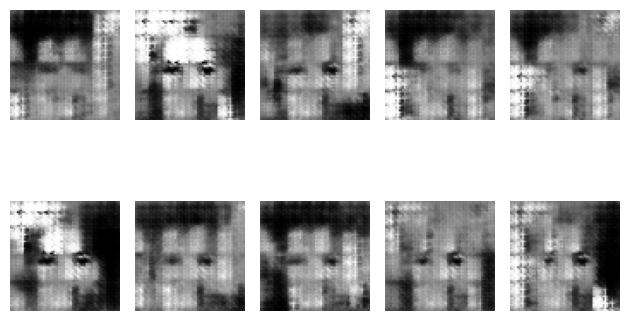

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.1793334484100342 GAN 1.023977279663086
지금 epoch 몇회냐면 61
1/1 [==============================] - 0s 30ms/step


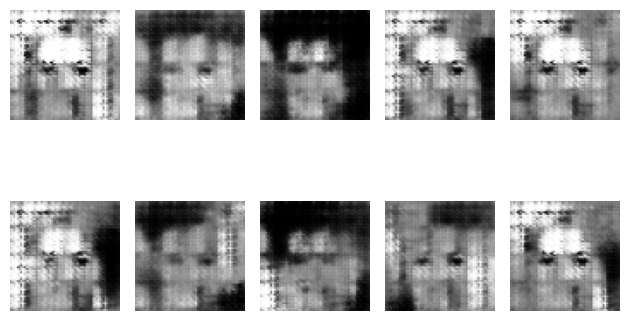

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.2297282218933105 GAN 0.9045225977897644
지금 epoch 몇회냐면 62
1/1 [==============================] - 0s 31ms/step


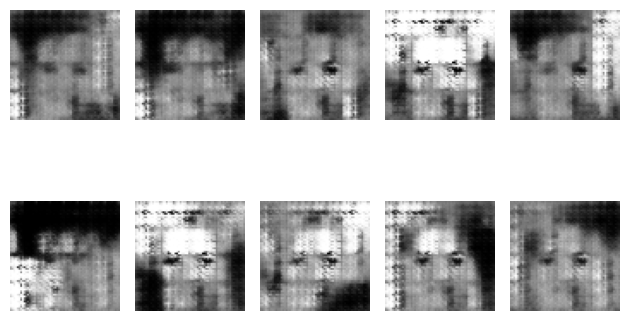

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.2533459663391113 GAN 0.9489444494247437
지금 epoch 몇회냐면 63
1/1 [==============================] - 0s 30ms/step


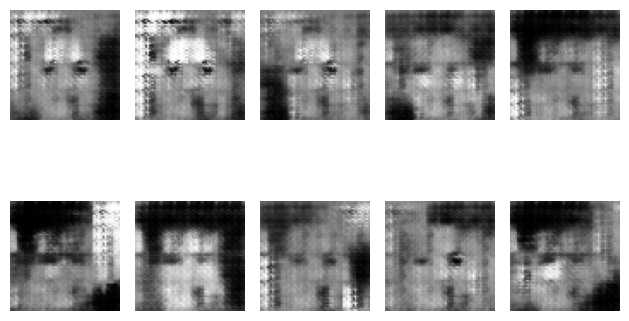

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.3929660320281982 GAN 0.6874683499336243
지금 epoch 몇회냐면 64
1/1 [==============================] - 0s 30ms/step


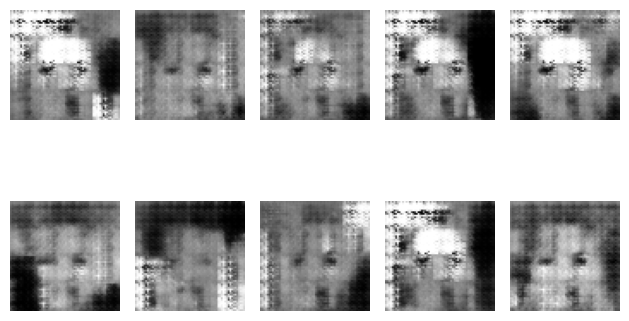

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.4590641260147095 GAN 0.7232438325881958
지금 epoch 몇회냐면 65
1/1 [==============================] - 0s 62ms/step


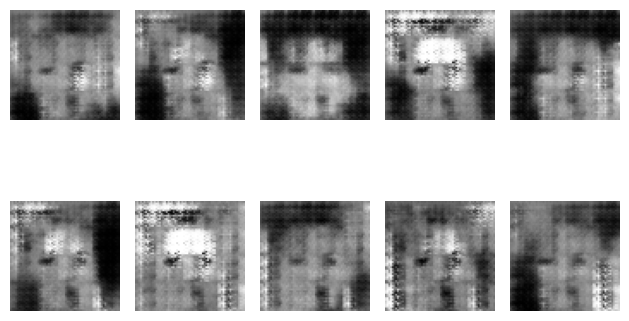

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.3960933685302734 GAN 0.7750602960586548
지금 epoch 몇회냐면 66
1/1 [==============================] - 0s 63ms/step


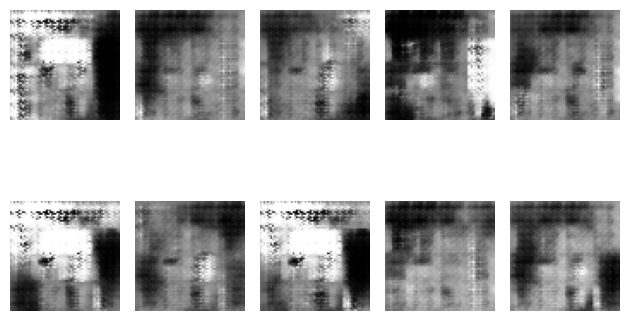

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.4068105220794678 GAN 0.7202494144439697
지금 epoch 몇회냐면 67
1/1 [==============================] - 0s 76ms/step


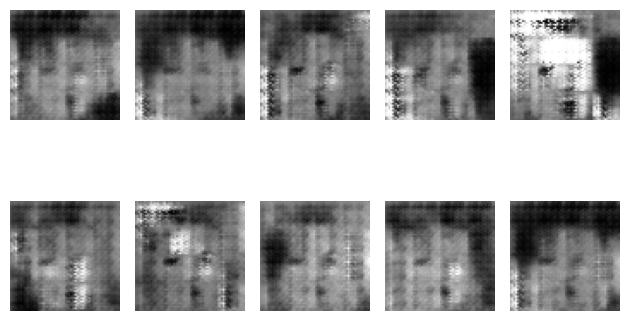

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.3807829022407532 GAN 0.7858214378356934
지금 epoch 몇회냐면 68
1/1 [==============================] - 0s 48ms/step


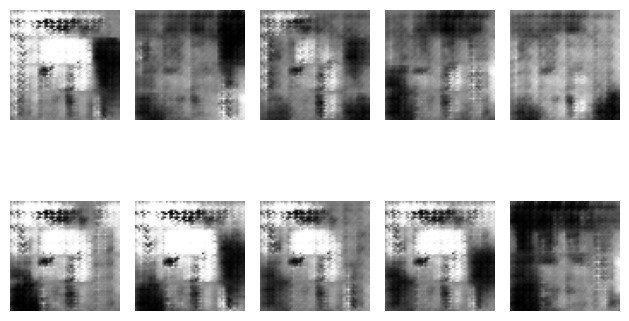

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 7ms/step
이번 epoch의 최종 loss는 Discriminator 1.3271724581718445 GAN 0.8426647186279297
지금 epoch 몇회냐면 69
1/1 [==============================] - 0s 37ms/step


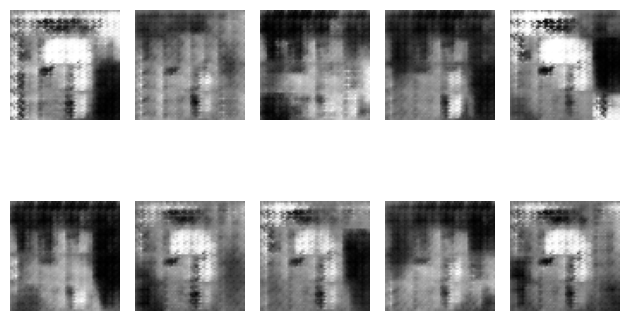

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.31801438331604 GAN 0.856788694858551
지금 epoch 몇회냐면 70
1/1 [==============================] - 0s 27ms/step


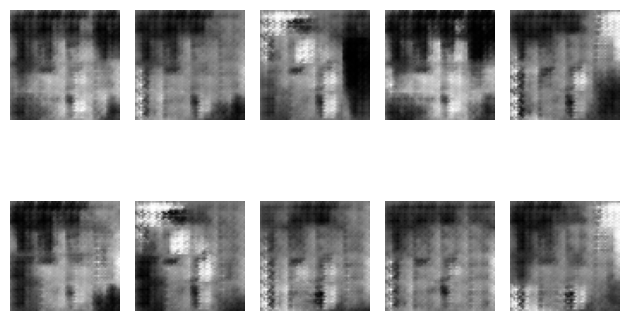

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.2668907046318054 GAN 0.9021188020706177
지금 epoch 몇회냐면 71
1/1 [==============================] - 0s 29ms/step


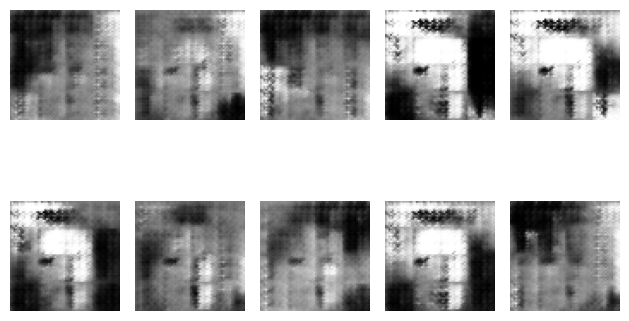

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.193379521369934 GAN 0.9042879343032837
지금 epoch 몇회냐면 72
1/1 [==============================] - 0s 36ms/step


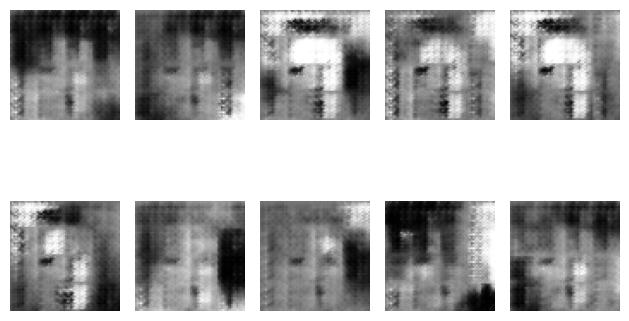

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.1199100613594055 GAN 1.0608420372009277
지금 epoch 몇회냐면 73
1/1 [==============================] - 0s 30ms/step


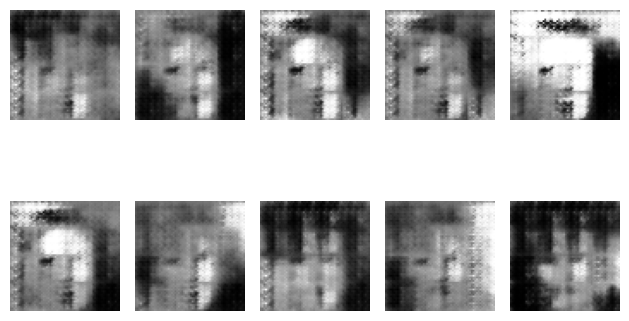

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.1427081227302551 GAN 1.005368947982788
지금 epoch 몇회냐면 74
1/1 [==============================] - 0s 46ms/step


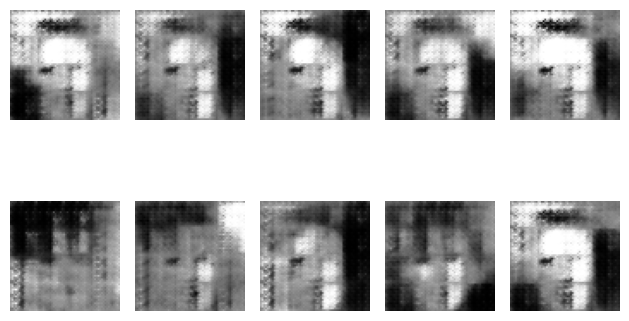

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 8ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.1448805332183838 GAN 1.0480138063430786
지금 epoch 몇회냐면 75
1/1 [==============================] - 0s 44ms/step


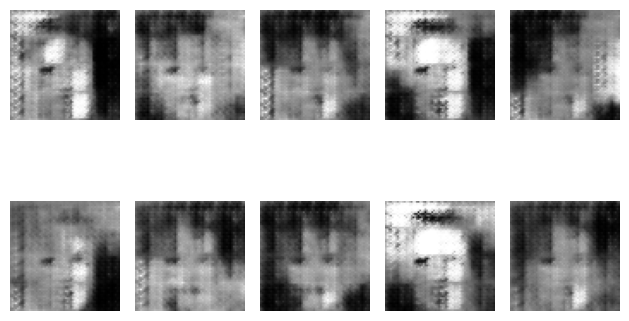

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.164913833141327 GAN 1.0565391778945923
지금 epoch 몇회냐면 76
1/1 [==============================] - 0s 34ms/step


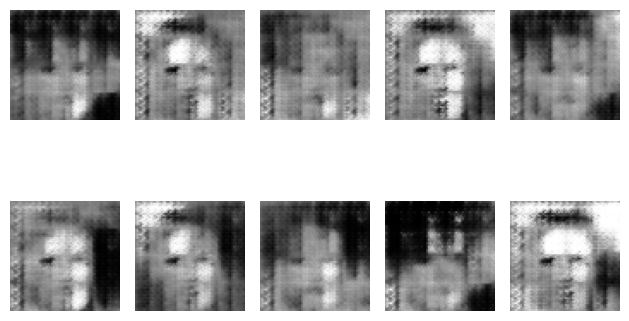

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.197249174118042 GAN 1.0402363538742065
지금 epoch 몇회냐면 77
1/1 [==============================] - 0s 40ms/step


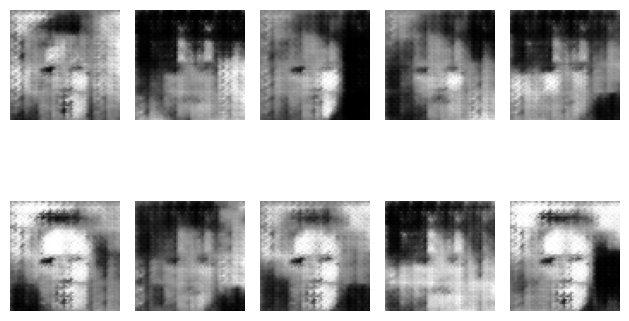

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.1855432987213135 GAN 1.0621414184570312
지금 epoch 몇회냐면 78
1/1 [==============================] - 0s 30ms/step


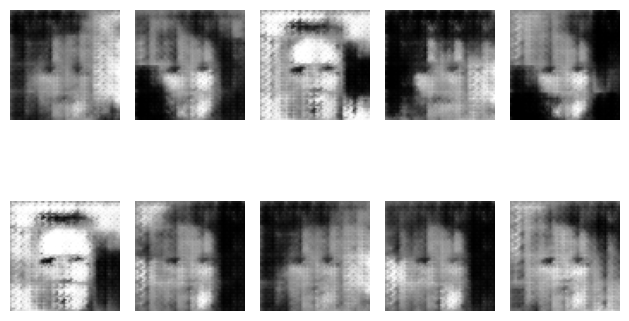

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 9ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.2440363764762878 GAN 0.9591876268386841
지금 epoch 몇회냐면 79
1/1 [==============================] - 0s 43ms/step


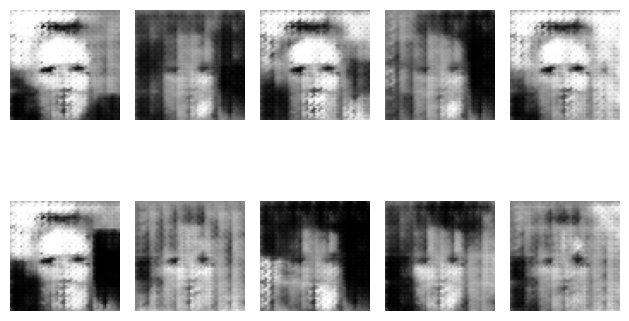

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.3188564777374268 GAN 0.8922454714775085
지금 epoch 몇회냐면 80
1/1 [==============================] - 0s 31ms/step


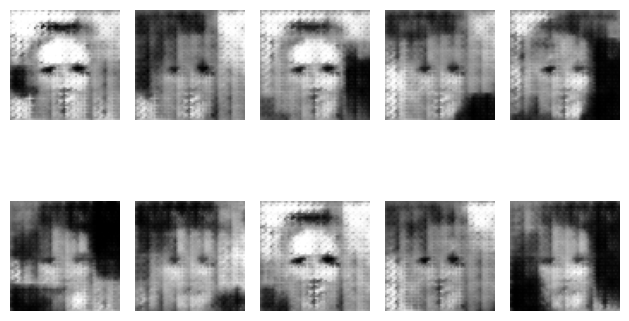

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.3620738983154297 GAN 0.8579981327056885
지금 epoch 몇회냐면 81
1/1 [==============================] - 0s 32ms/step


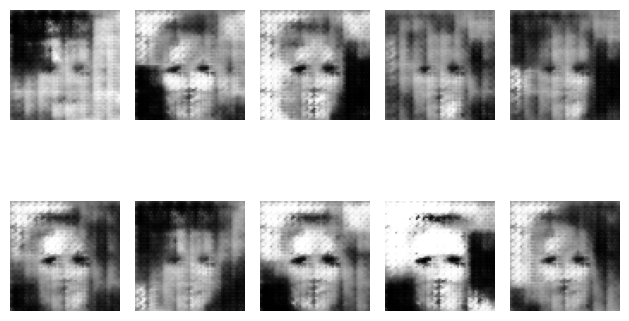

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.3047816157341003 GAN 0.8279731273651123
지금 epoch 몇회냐면 82
1/1 [==============================] - 0s 32ms/step


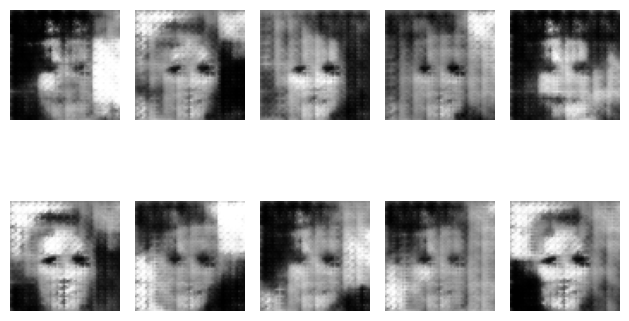

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.4619382619857788 GAN 0.7061775326728821
지금 epoch 몇회냐면 83
1/1 [==============================] - 0s 31ms/step


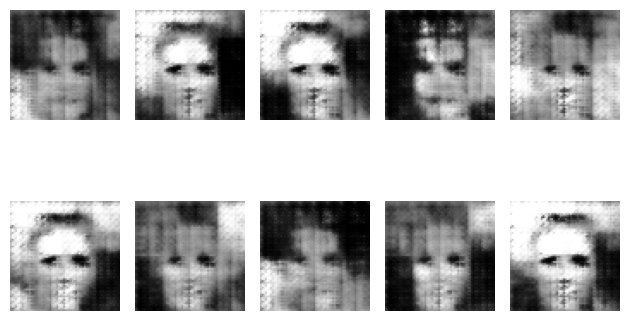

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 8ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.473526120185852 GAN 0.7012540698051453
지금 epoch 몇회냐면 84
1/1 [==============================] - 0s 37ms/step


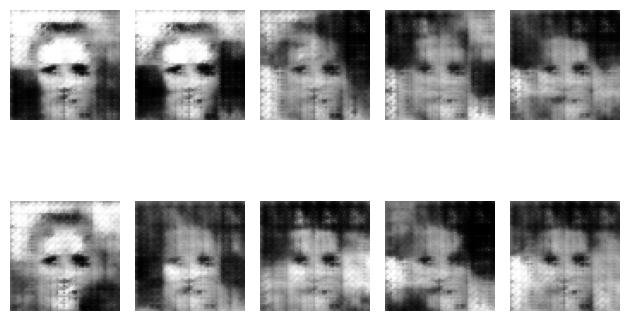

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.5365699529647827 GAN 0.7066637277603149
지금 epoch 몇회냐면 85
1/1 [==============================] - 0s 67ms/step


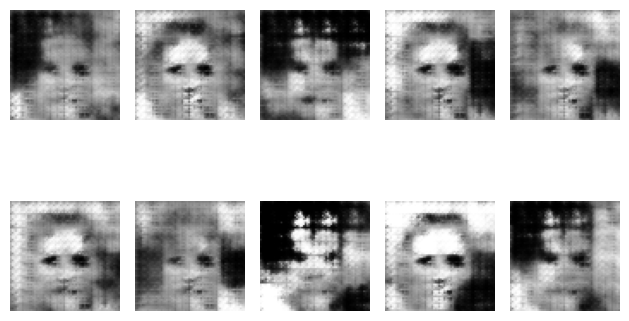

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.527830958366394 GAN 0.6940206289291382
지금 epoch 몇회냐면 86
1/1 [==============================] - 0s 36ms/step


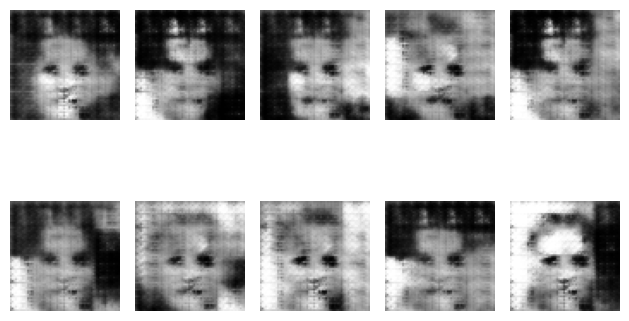

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.5483933687210083 GAN 0.7017498016357422
지금 epoch 몇회냐면 87
1/1 [==============================] - 0s 44ms/step


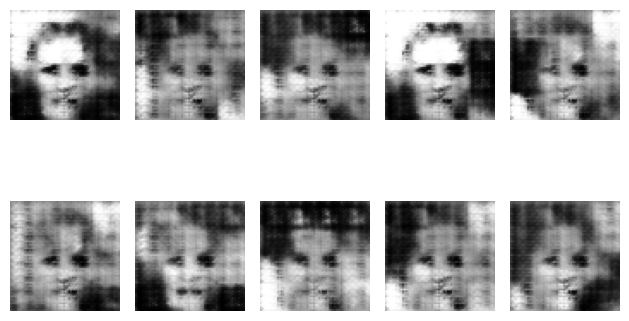

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.53424072265625 GAN 0.7633387446403503
지금 epoch 몇회냐면 88
1/1 [==============================] - 0s 32ms/step


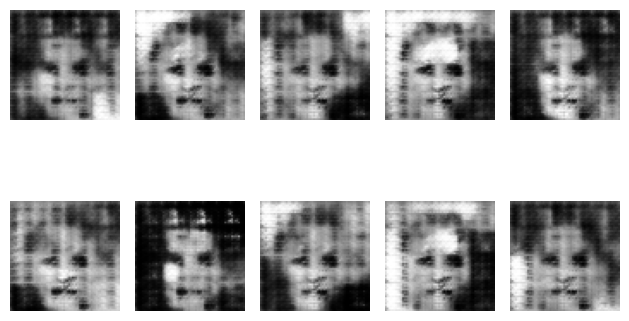

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.4999644756317139 GAN 0.8307949304580688
지금 epoch 몇회냐면 89
1/1 [==============================] - 0s 36ms/step


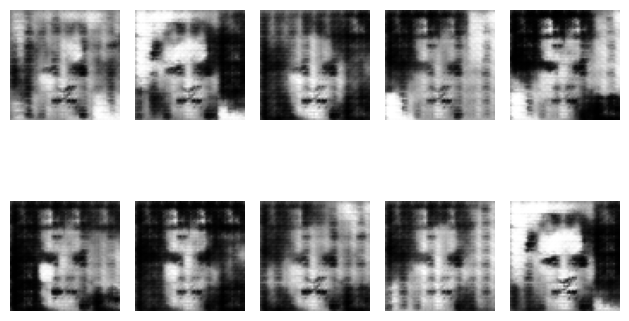

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.4256921410560608 GAN 0.9710716009140015
지금 epoch 몇회냐면 90
1/1 [==============================] - 0s 31ms/step


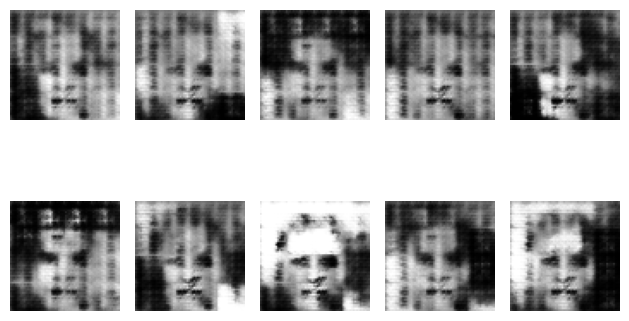

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.3606278896331787 GAN 0.9676944613456726
지금 epoch 몇회냐면 91
1/1 [==============================] - 0s 30ms/step


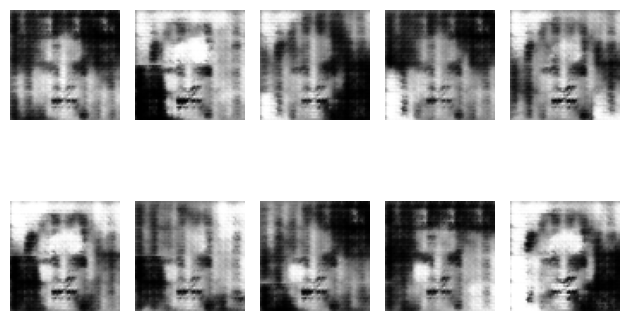

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.3411993384361267 GAN 1.05764901638031
지금 epoch 몇회냐면 92
1/1 [==============================] - 0s 29ms/step


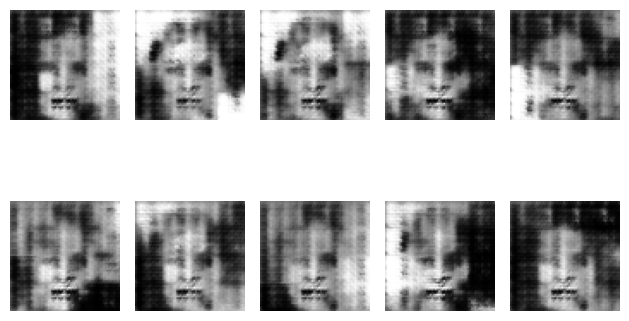

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.3353180885314941 GAN 1.0084846019744873
지금 epoch 몇회냐면 93
1/1 [==============================] - 0s 34ms/step


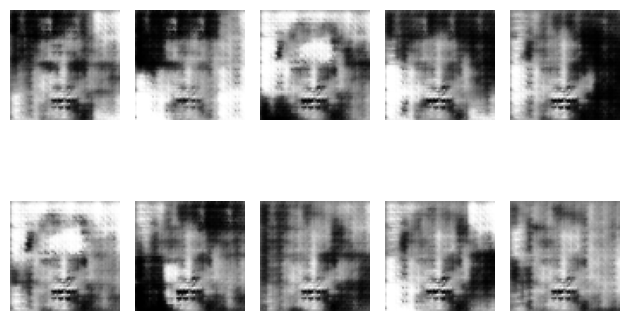

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 8ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.4498146176338196 GAN 1.061766505241394
지금 epoch 몇회냐면 94
1/1 [==============================] - 0s 38ms/step


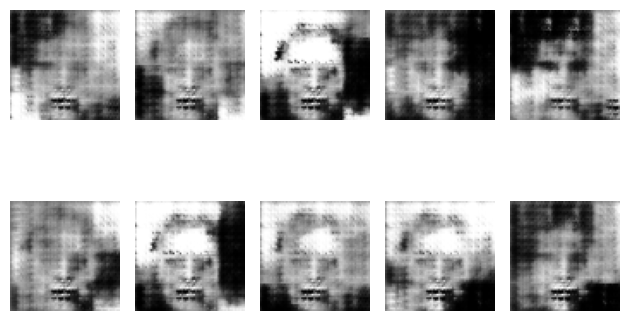

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.3957329988479614 GAN 0.9270027875900269
지금 epoch 몇회냐면 95
1/1 [==============================] - 0s 31ms/step


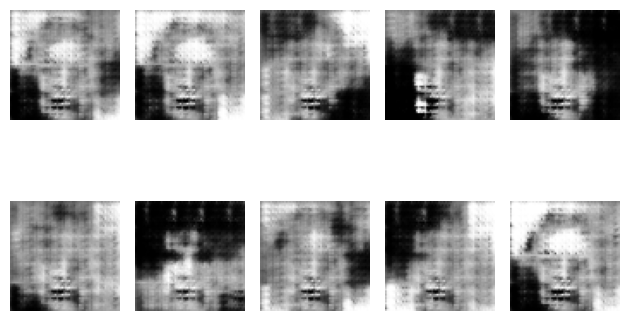

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 8ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.4532257914543152 GAN 0.9539743065834045
지금 epoch 몇회냐면 96
1/1 [==============================] - 0s 72ms/step


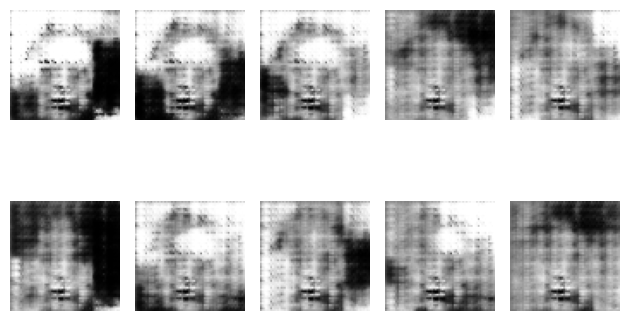

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.477005124092102 GAN 0.8796638250350952
지금 epoch 몇회냐면 97
1/1 [==============================] - 0s 32ms/step


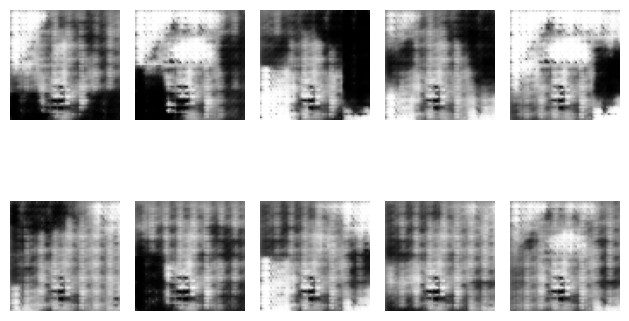

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.3629016280174255 GAN 0.9044510126113892
지금 epoch 몇회냐면 98
1/1 [==============================] - 0s 30ms/step


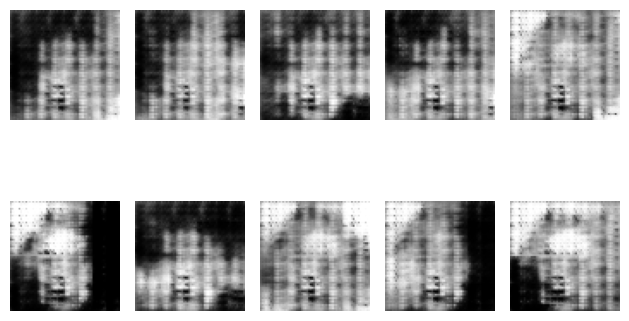

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.321960687637329 GAN 0.8651152849197388
지금 epoch 몇회냐면 99
1/1 [==============================] - 0s 29ms/step


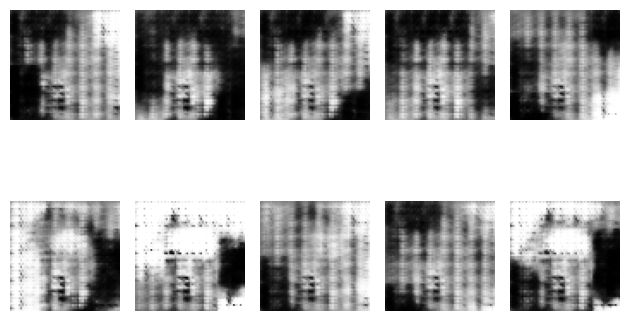

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.2705872058868408 GAN 0.8334122896194458
지금 epoch 몇회냐면 100
1/1 [==============================] - 0s 29ms/step


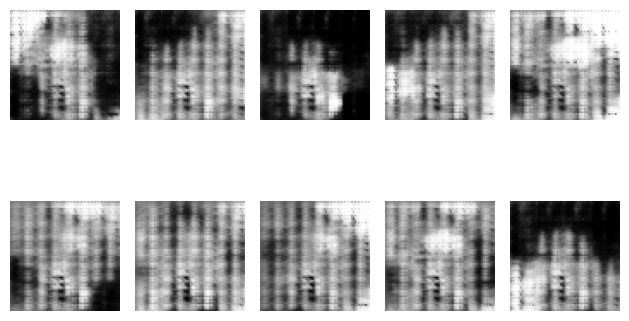

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.2518818974494934 GAN 0.8329634666442871
지금 epoch 몇회냐면 101
1/1 [==============================] - 0s 47ms/step


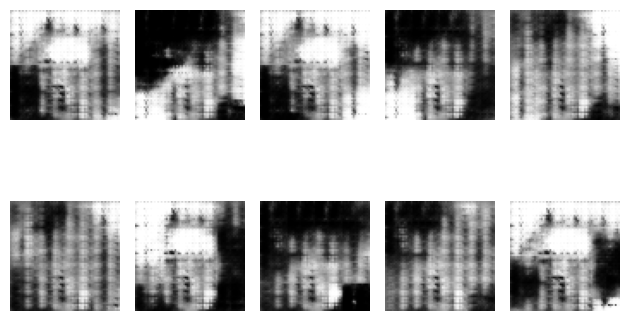

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.1493701934814453 GAN 0.9237778782844543
지금 epoch 몇회냐면 102
1/1 [==============================] - 0s 31ms/step


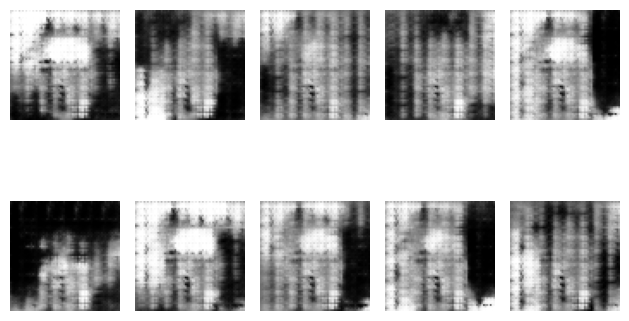

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.104928731918335 GAN 0.8397889733314514
지금 epoch 몇회냐면 103
1/1 [==============================] - 0s 32ms/step


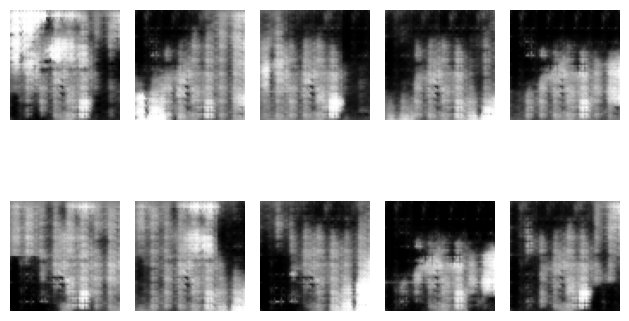

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 8ms/step
이번 epoch의 최종 loss는 Discriminator 1.0547924041748047 GAN 0.8690797090530396
지금 epoch 몇회냐면 104
1/1 [==============================] - 0s 59ms/step


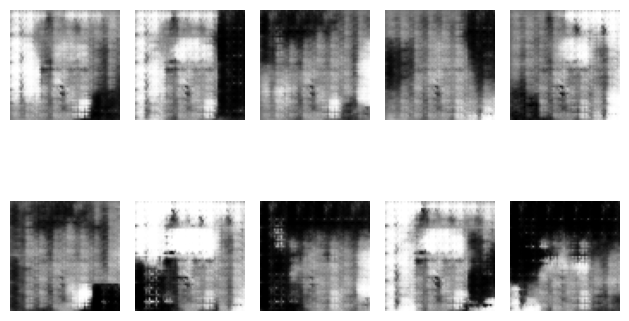

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 8ms/step
이번 epoch의 최종 loss는 Discriminator 1.1240730285644531 GAN 0.7955310344696045
지금 epoch 몇회냐면 105
1/1 [==============================] - 0s 41ms/step


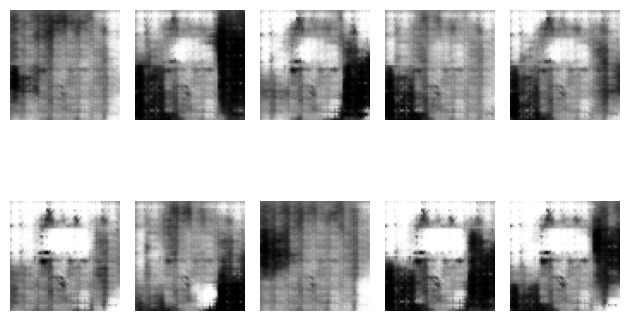

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 7ms/step
이번 epoch의 최종 loss는 Discriminator 1.183023750782013 GAN 0.7189364433288574
지금 epoch 몇회냐면 106
1/1 [==============================] - 0s 31ms/step


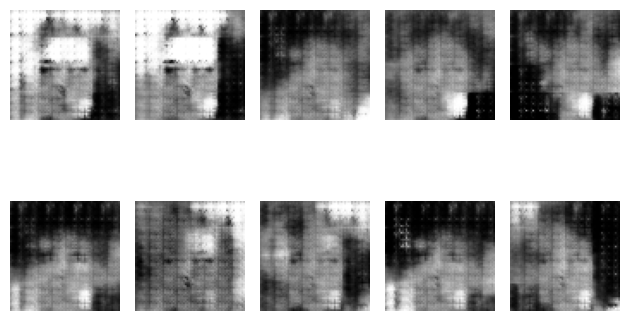

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.2170166373252869 GAN 0.7351956367492676
지금 epoch 몇회냐면 107
1/1 [==============================] - 0s 31ms/step


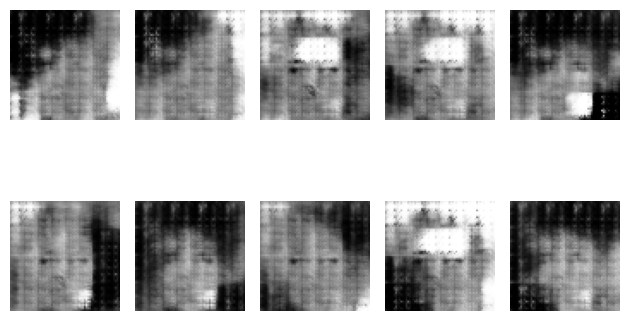

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.254048466682434 GAN 0.7193535566329956
지금 epoch 몇회냐면 108
1/1 [==============================] - 0s 30ms/step


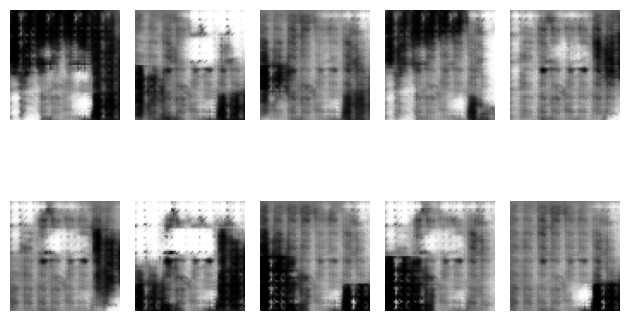

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.2673078775405884 GAN 0.6801328659057617
지금 epoch 몇회냐면 109
1/1 [==============================] - 0s 28ms/step


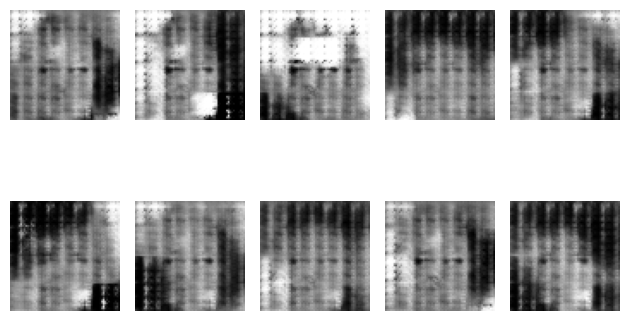

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.143939197063446 GAN 0.8972650766372681
지금 epoch 몇회냐면 110
1/1 [==============================] - 0s 36ms/step


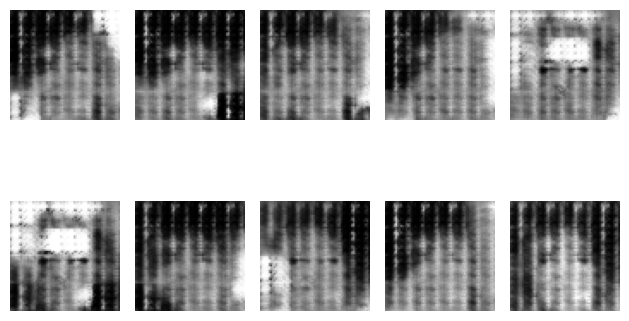

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.0255116820335388 GAN 0.9129943251609802
지금 epoch 몇회냐면 111
1/1 [==============================] - 0s 30ms/step


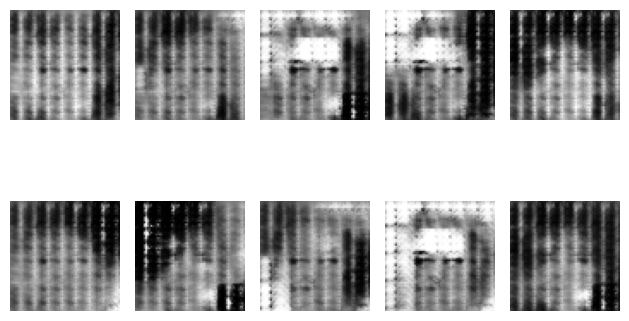

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 0.8500617146492004 GAN 1.145382046699524
지금 epoch 몇회냐면 112
1/1 [==============================] - 0s 32ms/step


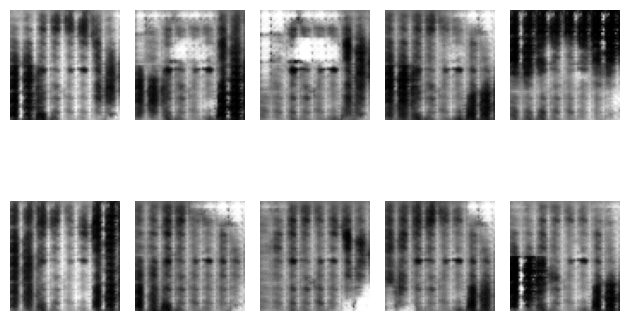

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 7ms/step
이번 epoch의 최종 loss는 Discriminator 0.6836435198783875 GAN 1.2490030527114868
지금 epoch 몇회냐면 113
1/1 [==============================] - 0s 44ms/step


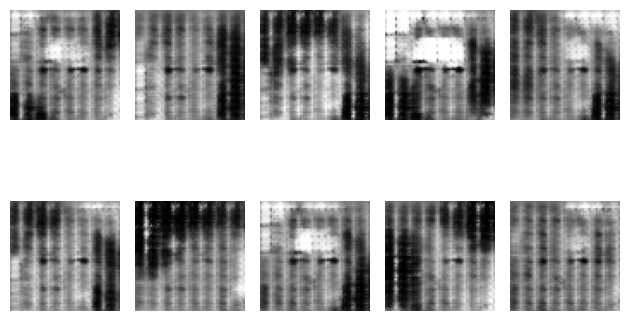

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 0.6542828679084778 GAN 1.3621079921722412
지금 epoch 몇회냐면 114
1/1 [==============================] - 0s 47ms/step


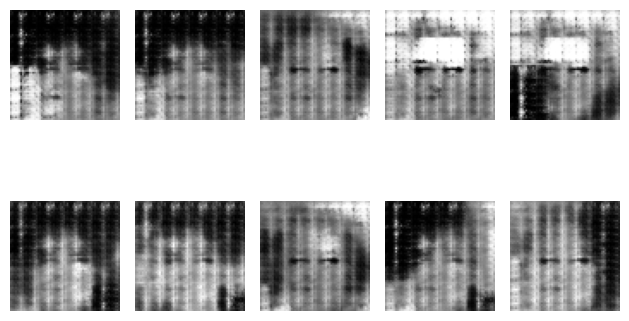

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 0.7467861771583557 GAN 1.2890350818634033
지금 epoch 몇회냐면 115
1/1 [==============================] - 0s 47ms/step


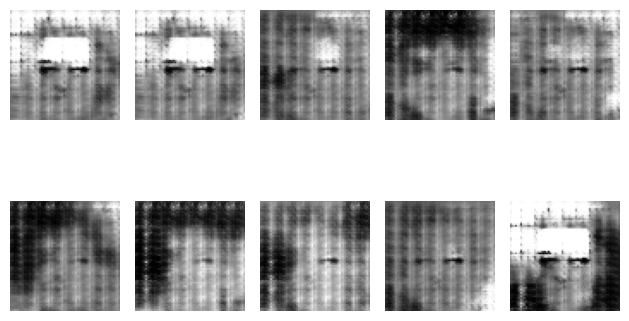

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.9843484461307526 GAN 1.0120790004730225
지금 epoch 몇회냐면 116
1/1 [==============================] - 0s 32ms/step


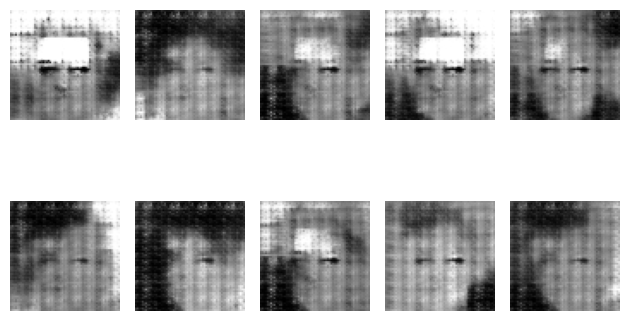

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.2826592922210693 GAN 0.9404959678649902
지금 epoch 몇회냐면 117
1/1 [==============================] - 0s 32ms/step


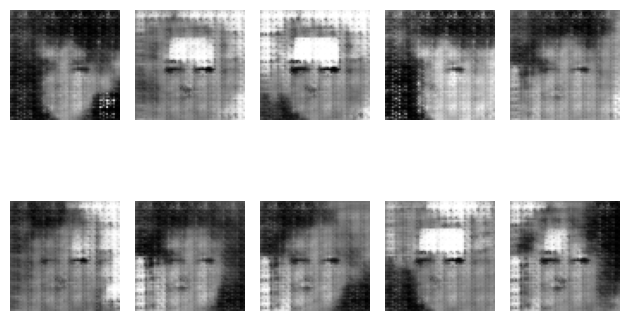

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.473073422908783 GAN 0.7967482805252075
지금 epoch 몇회냐면 118
1/1 [==============================] - 0s 28ms/step


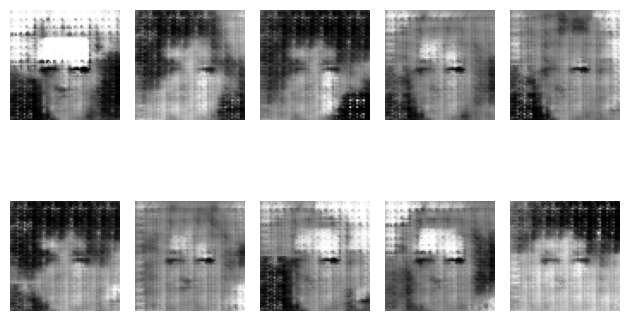

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.4827929735183716 GAN 0.8789353370666504
지금 epoch 몇회냐면 119
1/1 [==============================] - 0s 28ms/step


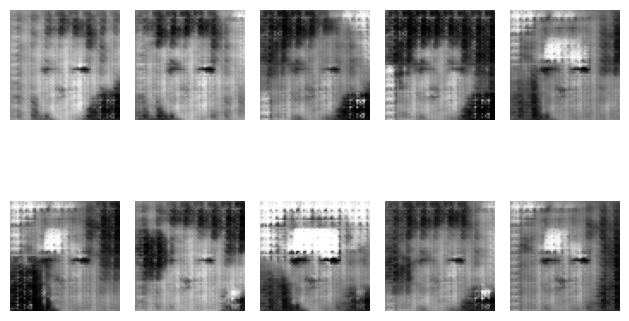

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.4039918184280396 GAN 0.950680136680603
지금 epoch 몇회냐면 120
1/1 [==============================] - 0s 31ms/step


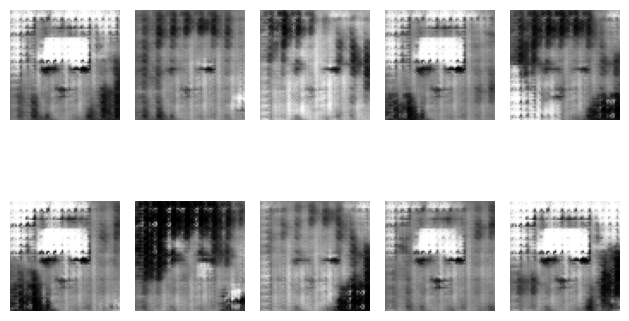

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.22673499584198 GAN 0.9617339372634888
지금 epoch 몇회냐면 121
1/1 [==============================] - 0s 28ms/step


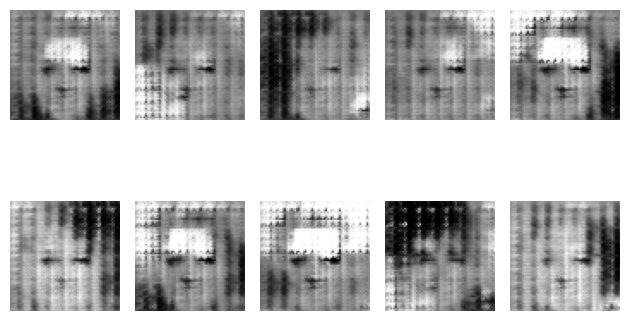

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.1364668607711792 GAN 1.1236202716827393
지금 epoch 몇회냐면 122
1/1 [==============================] - 0s 30ms/step


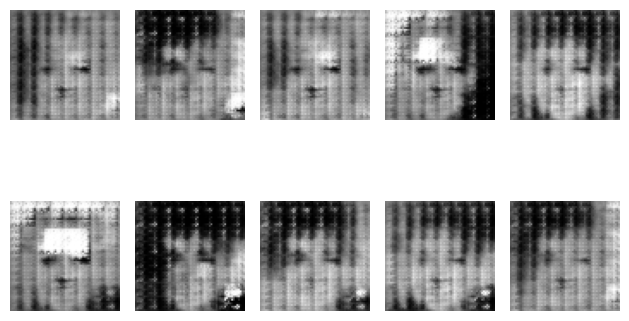

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.12578284740448 GAN 1.1220409870147705
지금 epoch 몇회냐면 123
1/1 [==============================] - 0s 43ms/step


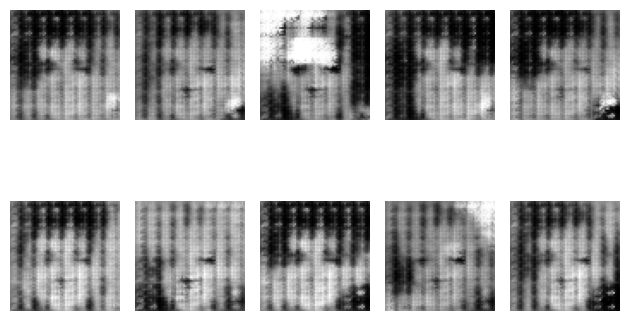

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.1742545366287231 GAN 1.0872950553894043
지금 epoch 몇회냐면 124
1/1 [==============================] - 0s 67ms/step


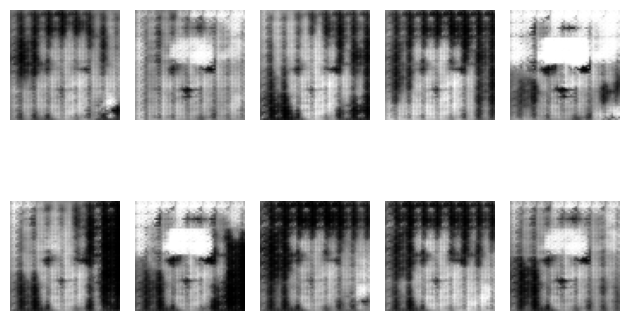

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.1206568479537964 GAN 1.1032495498657227
지금 epoch 몇회냐면 125
1/1 [==============================] - 0s 58ms/step


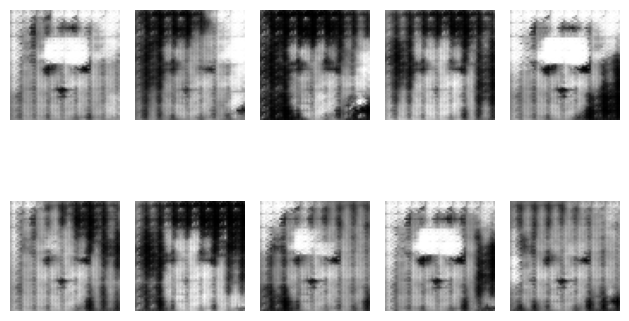

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.1645678877830505 GAN 0.9588231444358826
지금 epoch 몇회냐면 126
1/1 [==============================] - 0s 33ms/step


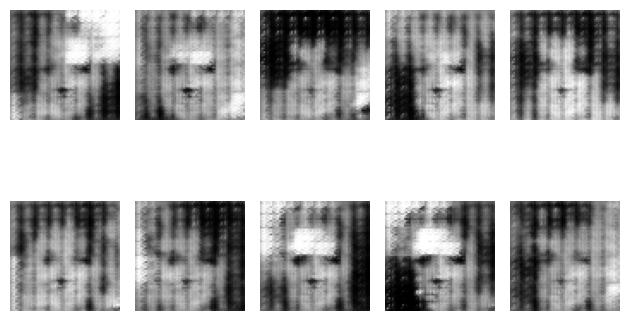

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.275389313697815 GAN 1.071684718132019
지금 epoch 몇회냐면 127
1/1 [==============================] - 0s 30ms/step


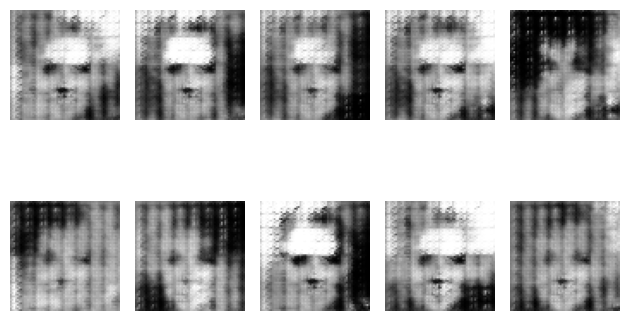

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.310538649559021 GAN 0.988994300365448
지금 epoch 몇회냐면 128
1/1 [==============================] - 0s 30ms/step


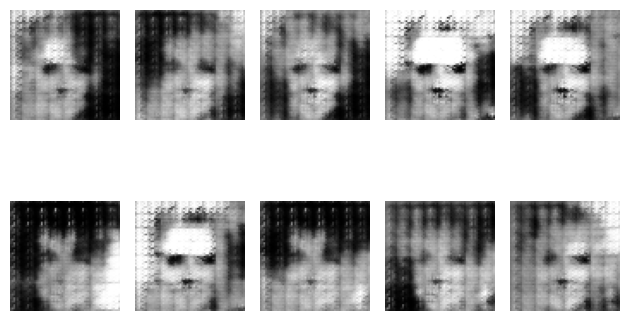

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.3274857997894287 GAN 0.9419049024581909
지금 epoch 몇회냐면 129
1/1 [==============================] - 0s 33ms/step


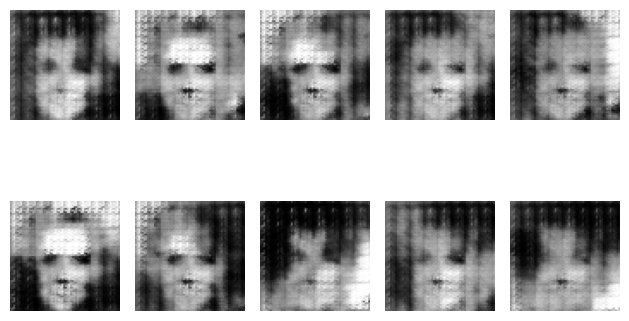

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.2826620936393738 GAN 1.0339879989624023
지금 epoch 몇회냐면 130
1/1 [==============================] - 0s 29ms/step


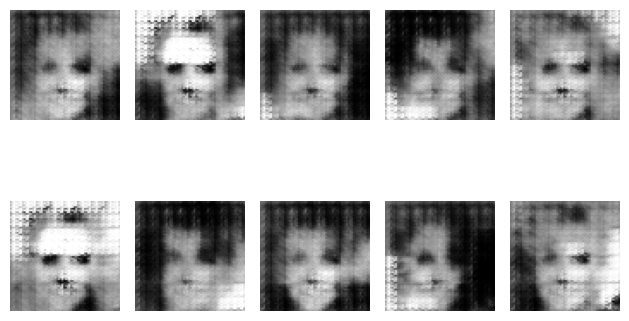

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.2501869201660156 GAN 1.0076701641082764
지금 epoch 몇회냐면 131
1/1 [==============================] - 0s 33ms/step


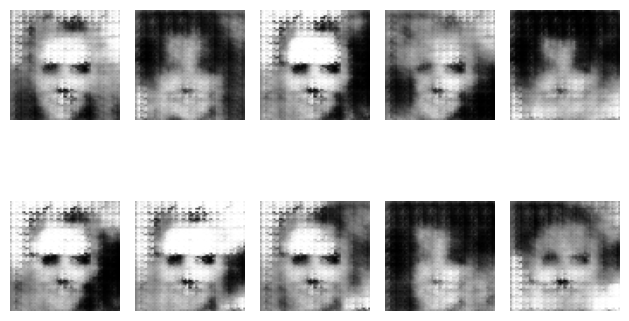

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 8ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.1796178817749023 GAN 1.104154109954834
지금 epoch 몇회냐면 132
1/1 [==============================] - 0s 28ms/step


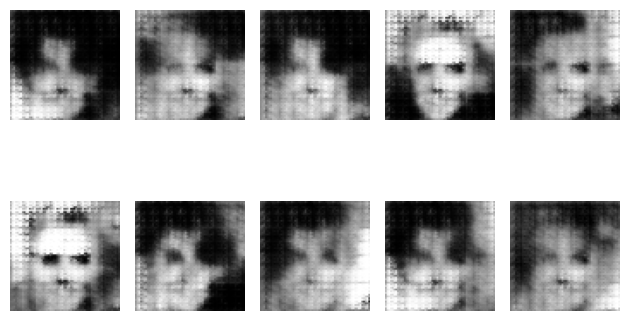

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.1529382467269897 GAN 1.1261265277862549
지금 epoch 몇회냐면 133
1/1 [==============================] - 0s 31ms/step


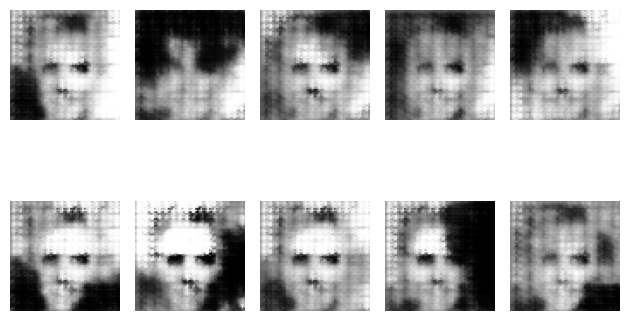

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 7ms/step
이번 epoch의 최종 loss는 Discriminator 1.2126334309577942 GAN 1.1153768301010132
지금 epoch 몇회냐면 134
1/1 [==============================] - 0s 37ms/step


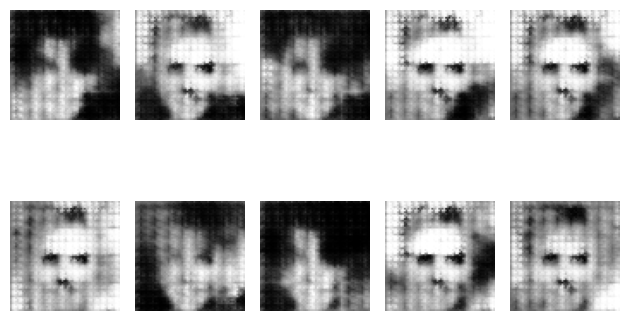

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.2572143077850342 GAN 1.0614813566207886
지금 epoch 몇회냐면 135
1/1 [==============================] - 0s 28ms/step


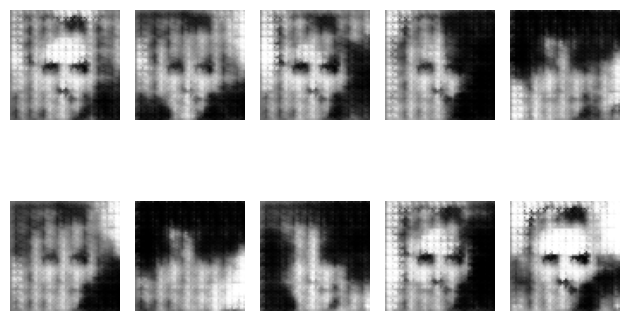

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.2237443923950195 GAN 1.0503380298614502
지금 epoch 몇회냐면 136
1/1 [==============================] - 0s 30ms/step


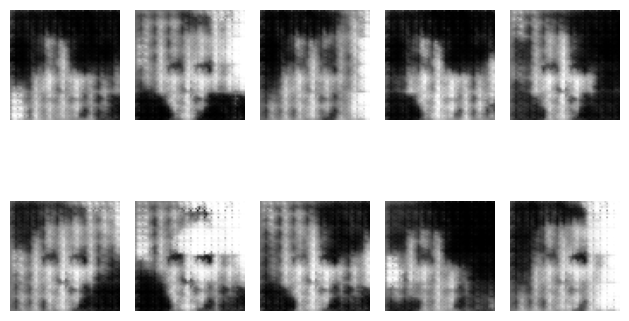

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.1645578145980835 GAN 1.0539593696594238
지금 epoch 몇회냐면 137
1/1 [==============================] - 0s 36ms/step


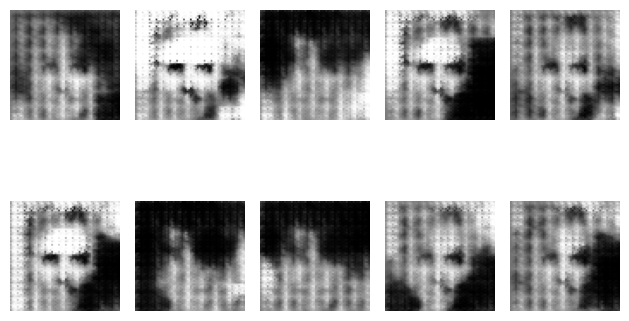

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.1348645091056824 GAN 0.9853782653808594
지금 epoch 몇회냐면 138
1/1 [==============================] - 0s 64ms/step


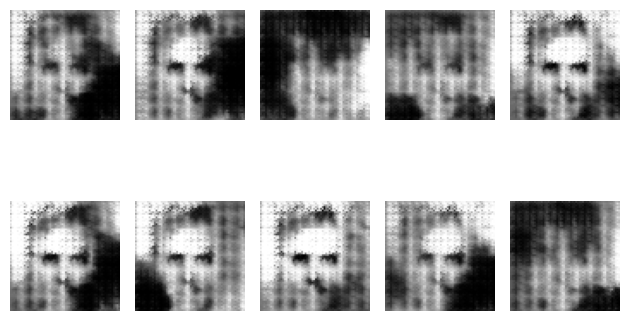

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0189765095710754 GAN 1.0104901790618896
지금 epoch 몇회냐면 139
1/1 [==============================] - 0s 31ms/step


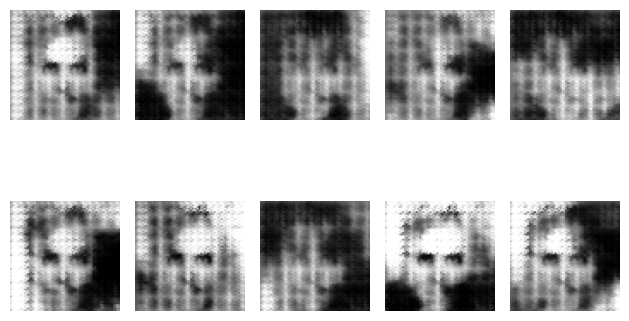

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.9870775640010834 GAN 1.0821852684020996
지금 epoch 몇회냐면 140
1/1 [==============================] - 0s 34ms/step


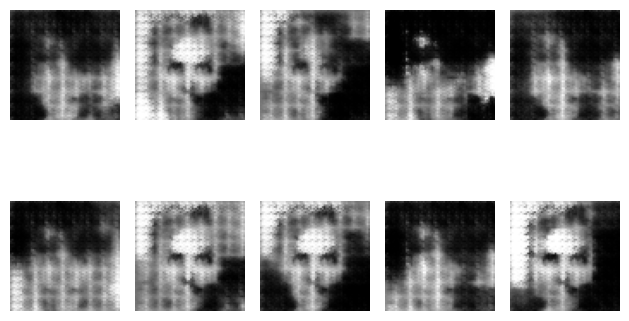

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.0196163058280945 GAN 1.0405372381210327
지금 epoch 몇회냐면 141
1/1 [==============================] - 0s 63ms/step


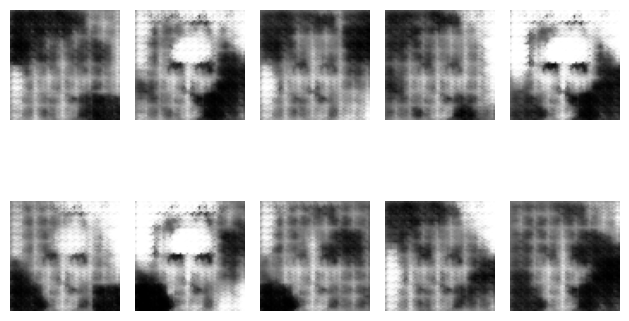

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.041515588760376 GAN 1.0529332160949707
지금 epoch 몇회냐면 142
1/1 [==============================] - 0s 45ms/step


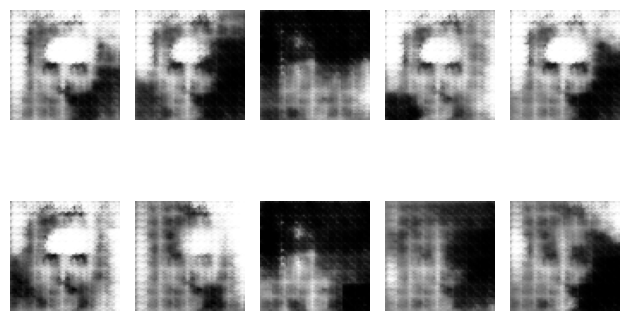

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.0924113392829895 GAN 0.9690791964530945
지금 epoch 몇회냐면 143
1/1 [==============================] - 0s 64ms/step


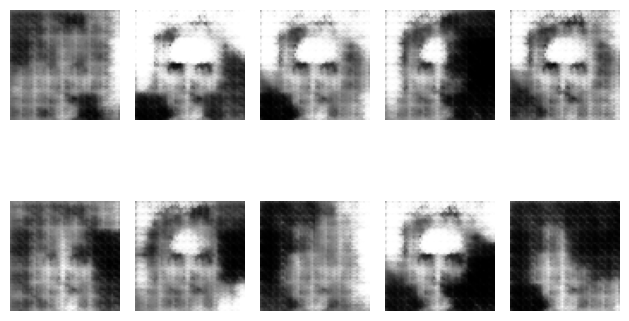

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0756984949111938 GAN 1.0302140712738037
지금 epoch 몇회냐면 144
1/1 [==============================] - 0s 65ms/step


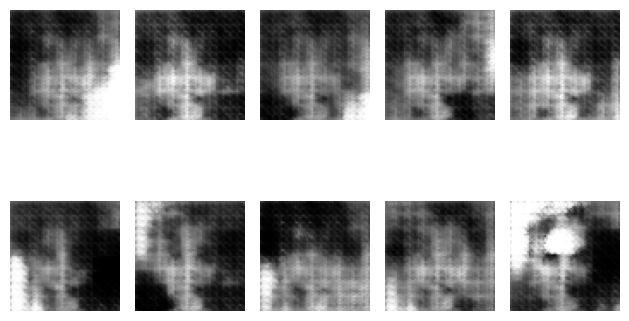

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0571210980415344 GAN 0.9277327060699463
지금 epoch 몇회냐면 145
1/1 [==============================] - 0s 27ms/step


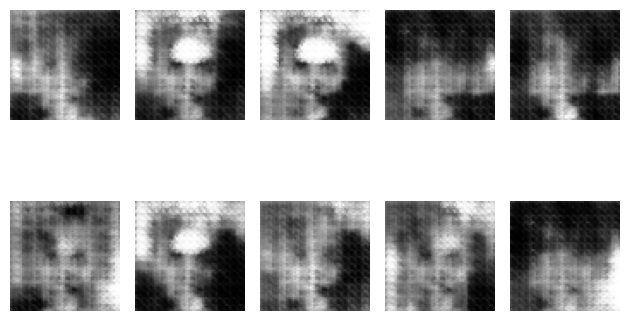

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0138899385929108 GAN 0.9303881525993347
지금 epoch 몇회냐면 146
1/1 [==============================] - 0s 28ms/step


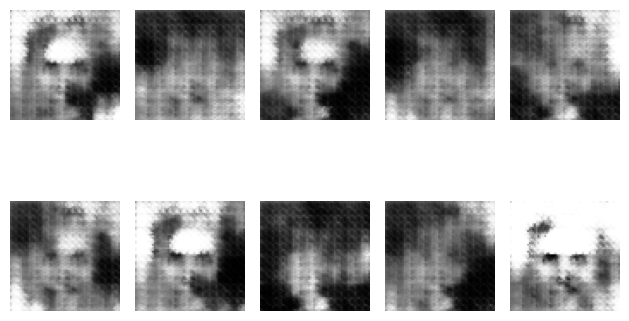

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.082014560699463 GAN 0.9630172252655029
지금 epoch 몇회냐면 147
1/1 [==============================] - 0s 45ms/step


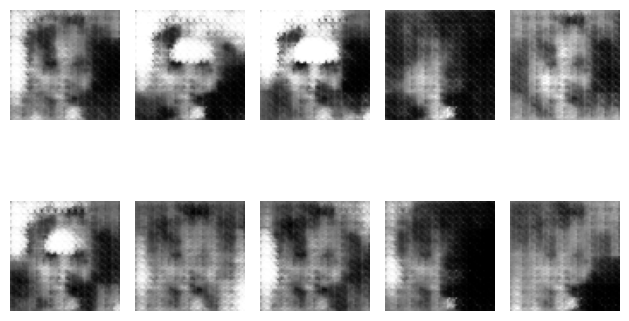

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.0781551003456116 GAN 0.9214524030685425
지금 epoch 몇회냐면 148
1/1 [==============================] - 0s 34ms/step


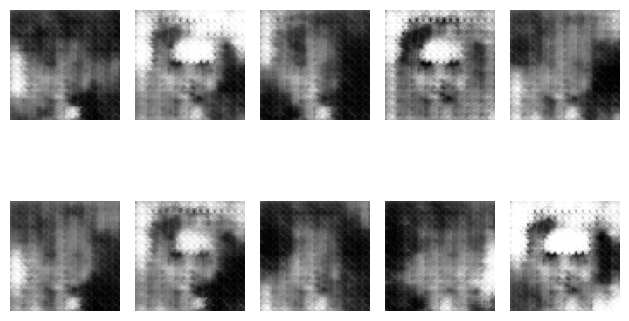

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.105570137500763 GAN 1.041783332824707
지금 epoch 몇회냐면 149
1/1 [==============================] - 0s 27ms/step


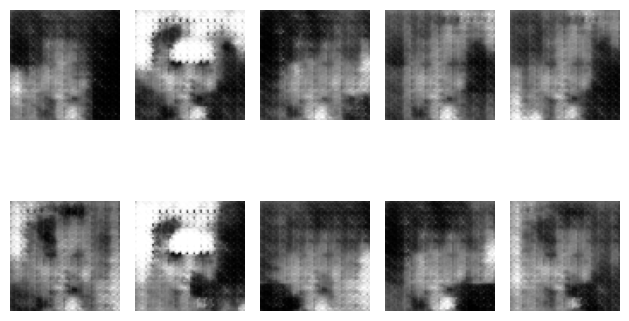

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0687081813812256 GAN 1.0398370027542114
지금 epoch 몇회냐면 150
1/1 [==============================] - 0s 35ms/step


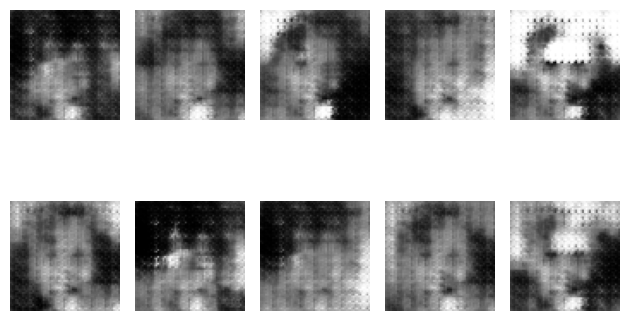

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 7ms/step
이번 epoch의 최종 loss는 Discriminator 1.0065253376960754 GAN 1.0465855598449707
지금 epoch 몇회냐면 151
1/1 [==============================] - 0s 40ms/step


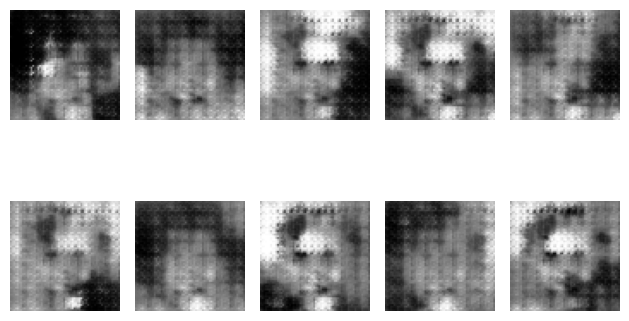

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.0246975421905518 GAN 1.0764567852020264
지금 epoch 몇회냐면 152
1/1 [==============================] - 0s 51ms/step


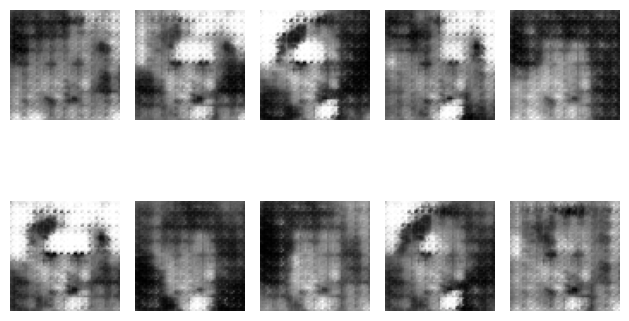

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 8ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.0721295475959778 GAN 1.0700035095214844
지금 epoch 몇회냐면 153
1/1 [==============================] - 0s 36ms/step


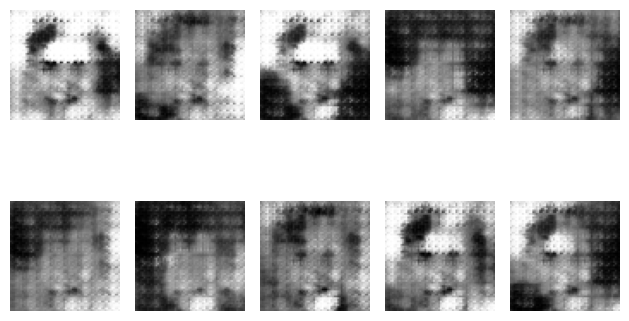

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.0068824291229248 GAN 1.0796490907669067
지금 epoch 몇회냐면 154
1/1 [==============================] - 0s 30ms/step


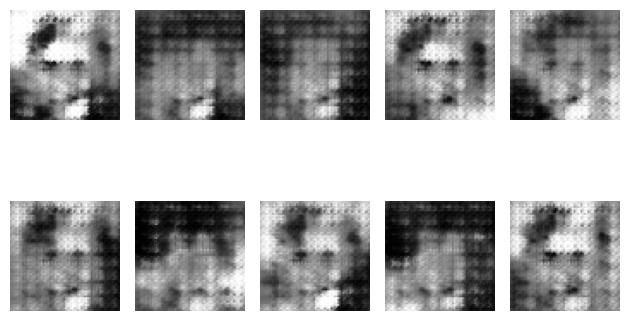

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.947189450263977 GAN 1.0837911367416382
지금 epoch 몇회냐면 155
1/1 [==============================] - 0s 30ms/step


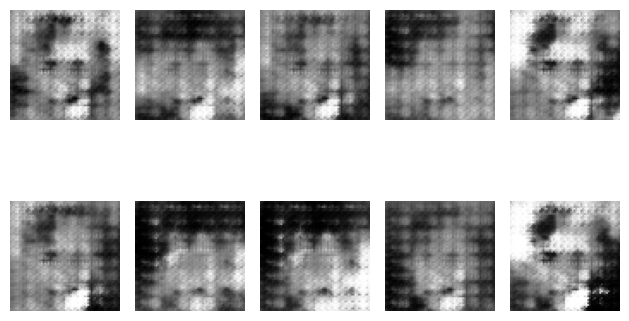

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.9257475733757019 GAN 1.1030728816986084
지금 epoch 몇회냐면 156
1/1 [==============================] - 0s 34ms/step


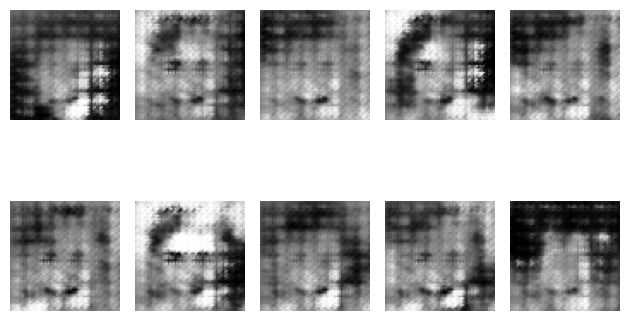

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 0.980687141418457 GAN 1.0830237865447998
지금 epoch 몇회냐면 157
1/1 [==============================] - 0s 30ms/step


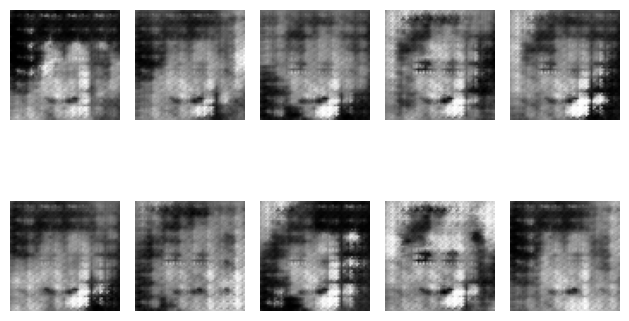

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0675424933433533 GAN 1.1380188465118408
지금 epoch 몇회냐면 158
1/1 [==============================] - 0s 34ms/step


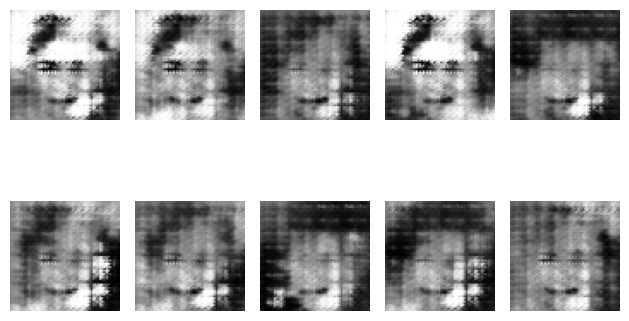

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.1202005743980408 GAN 1.098644495010376
지금 epoch 몇회냐면 159
1/1 [==============================] - 0s 36ms/step


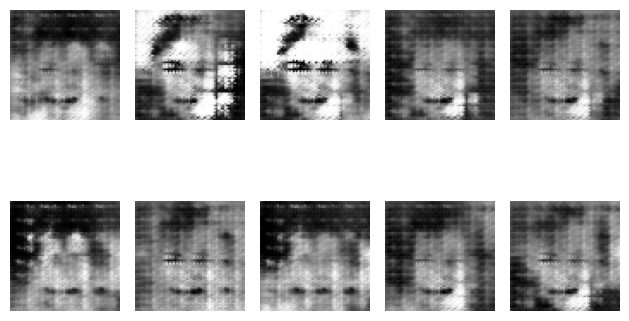

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 0.9461076557636261 GAN 1.2133679389953613
지금 epoch 몇회냐면 160
1/1 [==============================] - 0s 46ms/step


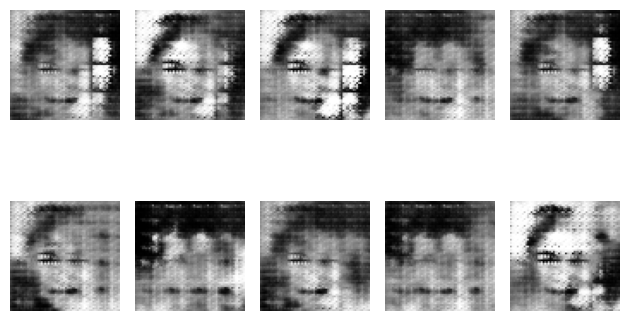

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 0.9304225444793701 GAN 1.251176118850708
지금 epoch 몇회냐면 161
1/1 [==============================] - 0s 38ms/step


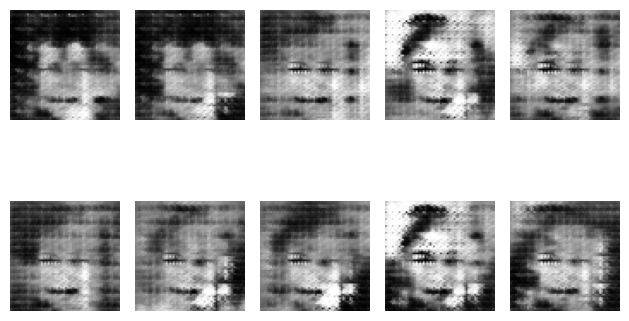

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.994955450296402 GAN 1.187497854232788
지금 epoch 몇회냐면 162
1/1 [==============================] - 0s 70ms/step


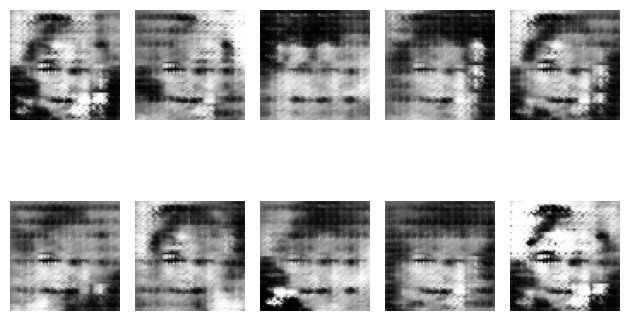

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0164899826049805 GAN 1.2598214149475098
지금 epoch 몇회냐면 163
1/1 [==============================] - 0s 53ms/step


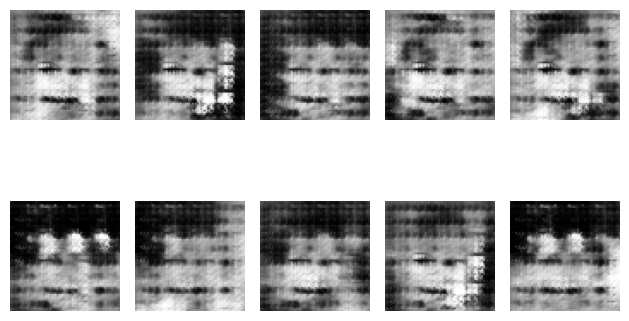

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 7ms/step
이번 epoch의 최종 loss는 Discriminator 0.904455840587616 GAN 1.24265456199646
지금 epoch 몇회냐면 164
1/1 [==============================] - 0s 30ms/step


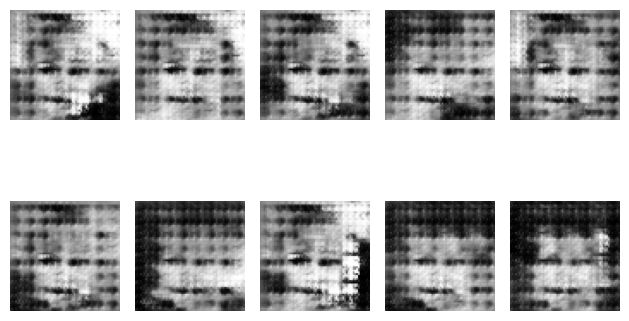

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.0283142924308777 GAN 1.3390448093414307
지금 epoch 몇회냐면 165
1/1 [==============================] - 0s 30ms/step


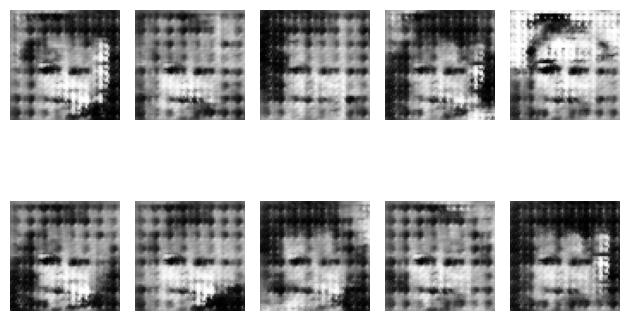

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.0857502818107605 GAN 1.3902391195297241
지금 epoch 몇회냐면 166
1/1 [==============================] - 0s 28ms/step


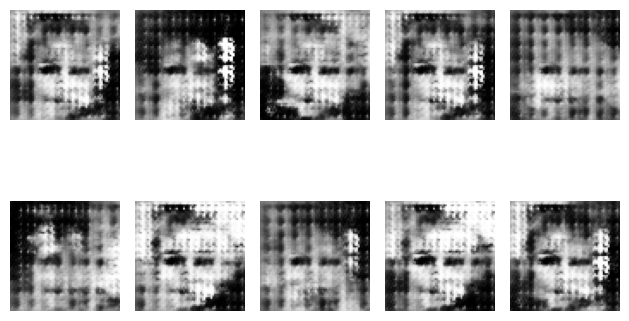

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 0.9940168559551239 GAN 1.5075035095214844
지금 epoch 몇회냐면 167
1/1 [==============================] - 0s 30ms/step


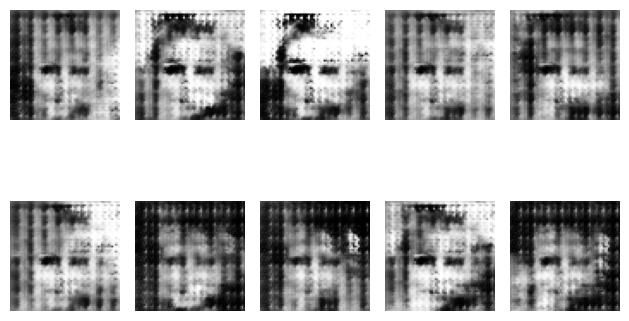

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.8249858319759369 GAN 1.4511032104492188
지금 epoch 몇회냐면 168
1/1 [==============================] - 0s 36ms/step


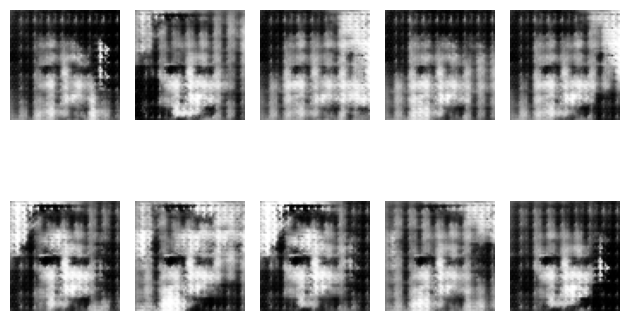

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 8ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.6707260310649872 GAN 1.64601469039917
지금 epoch 몇회냐면 169
1/1 [==============================] - 0s 31ms/step


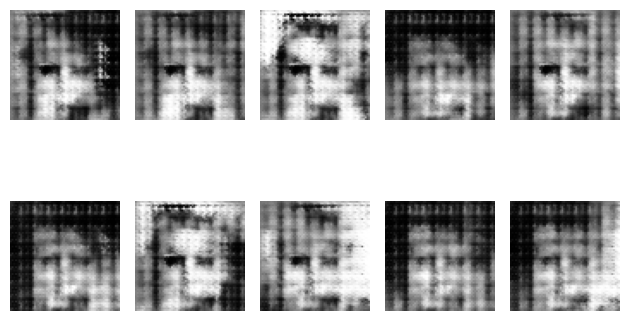

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.6636714935302734 GAN 1.4314955472946167
지금 epoch 몇회냐면 170
1/1 [==============================] - 0s 29ms/step


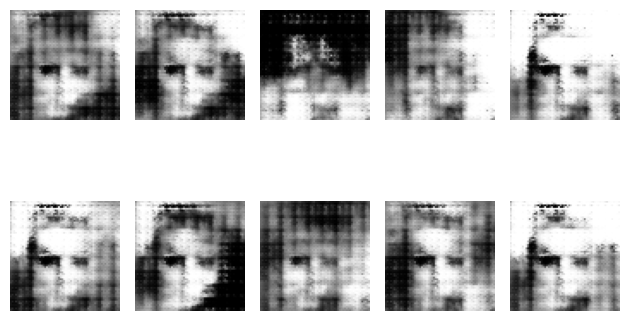

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 7ms/step
이번 epoch의 최종 loss는 Discriminator 0.75166454911232 GAN 1.1420434713363647
지금 epoch 몇회냐면 171
1/1 [==============================] - 0s 60ms/step


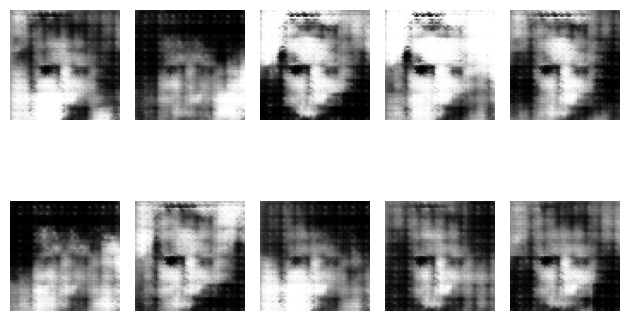

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.9503657817840576 GAN 1.0453219413757324
지금 epoch 몇회냐면 172
1/1 [==============================] - 0s 41ms/step


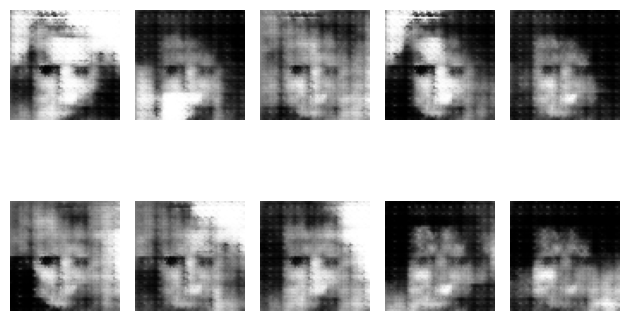

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.1265618801116943 GAN 0.7938984036445618
지금 epoch 몇회냐면 173
1/1 [==============================] - 0s 39ms/step


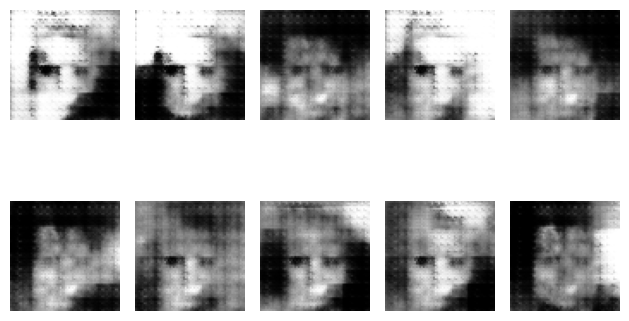

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.20046728849411 GAN 0.6168382167816162
지금 epoch 몇회냐면 174
1/1 [==============================] - 0s 28ms/step


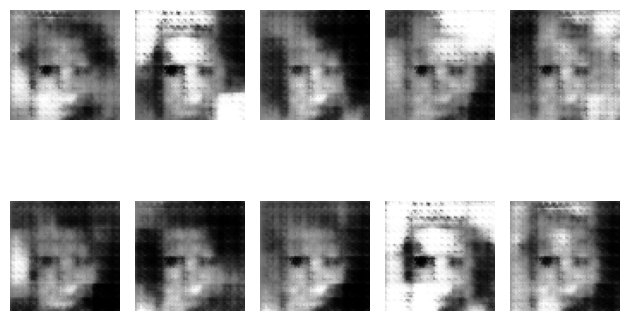

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.1363686323165894 GAN 0.6495894193649292
지금 epoch 몇회냐면 175
1/1 [==============================] - 0s 32ms/step


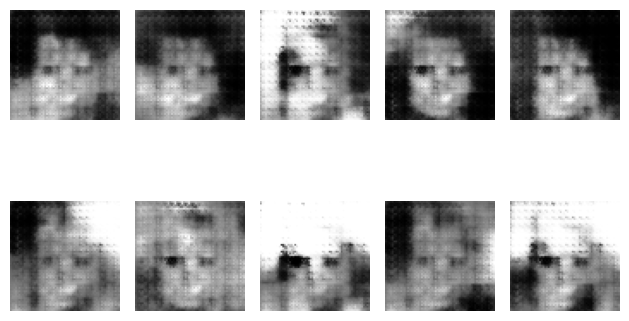

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.2136749625205994 GAN 0.5926458835601807
지금 epoch 몇회냐면 176
1/1 [==============================] - 0s 31ms/step


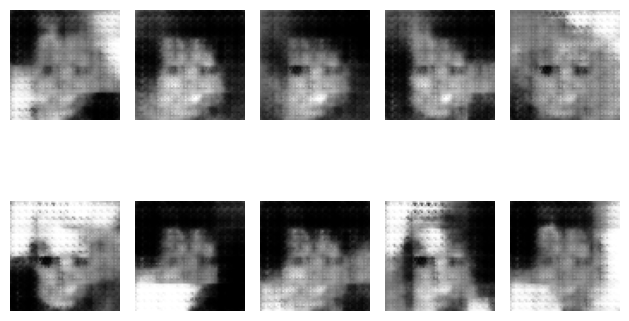

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.085616409778595 GAN 0.8749070167541504
지금 epoch 몇회냐면 177
1/1 [==============================] - 0s 36ms/step


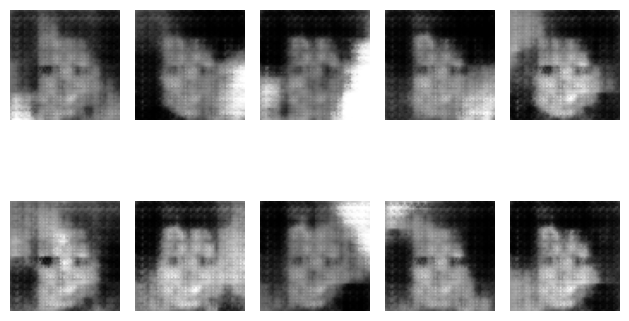

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.01035737991333 GAN 0.8449224233627319
지금 epoch 몇회냐면 178
1/1 [==============================] - 0s 29ms/step


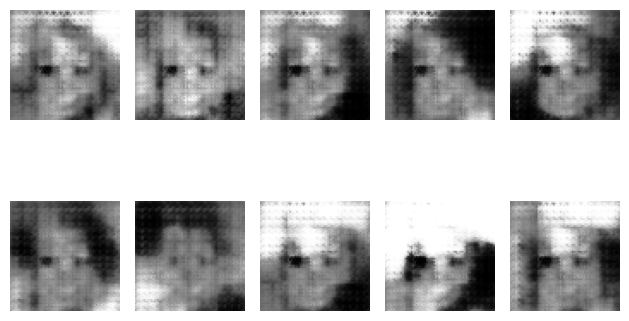

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0577028095722198 GAN 0.8209084868431091
지금 epoch 몇회냐면 179
1/1 [==============================] - 0s 27ms/step


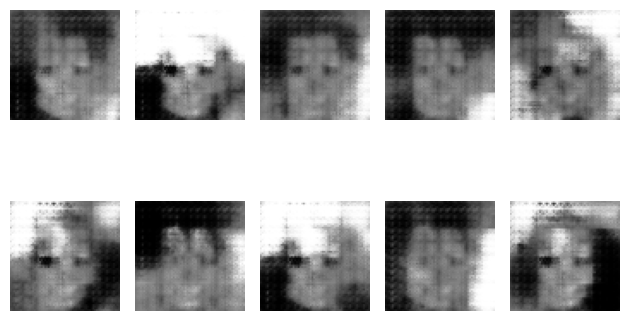

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.9356437623500824 GAN 1.0172622203826904
지금 epoch 몇회냐면 180
1/1 [==============================] - 0s 31ms/step


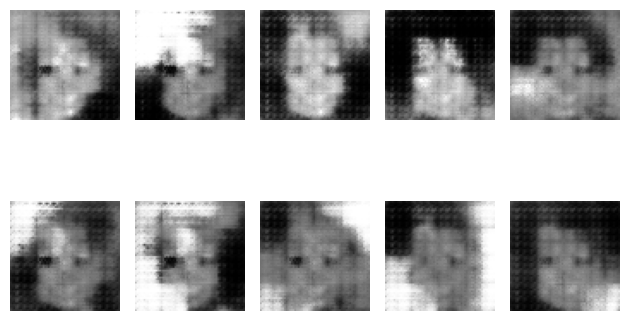

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 0.9669568240642548 GAN 1.0112557411193848
지금 epoch 몇회냐면 181
1/1 [==============================] - 0s 67ms/step


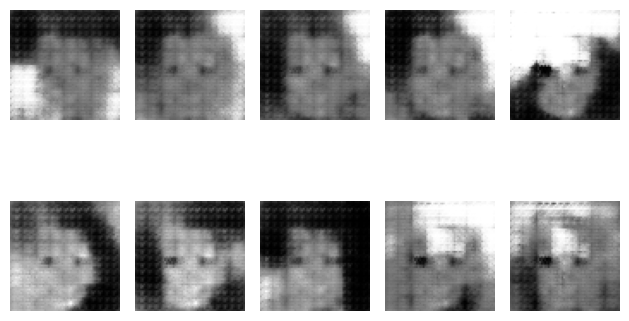

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 0.9241560697555542 GAN 1.1741260290145874
지금 epoch 몇회냐면 182
1/1 [==============================] - 0s 31ms/step


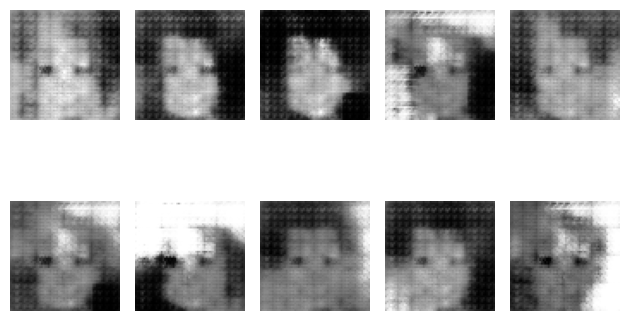

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 8ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.889720618724823 GAN 1.2608511447906494
지금 epoch 몇회냐면 183
1/1 [==============================] - 0s 65ms/step


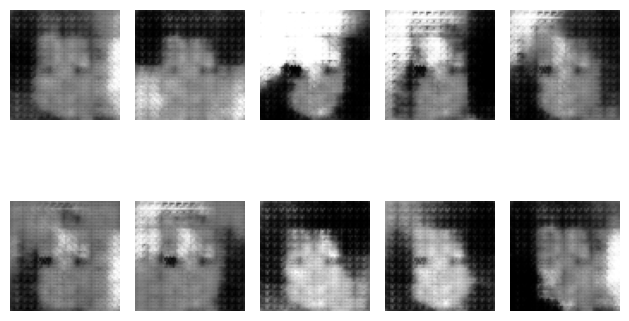

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 0.8365362286567688 GAN 1.3081412315368652
지금 epoch 몇회냐면 184
1/1 [==============================] - 0s 28ms/step


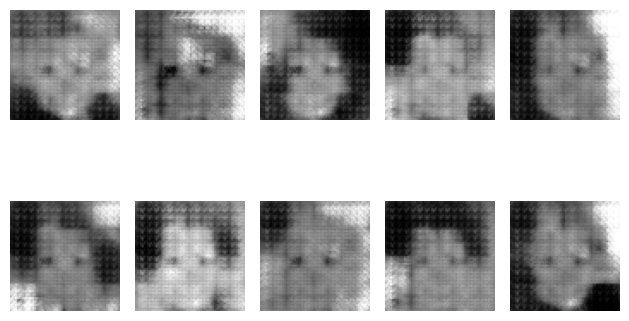

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 0.8734418749809265 GAN 1.1536263227462769
지금 epoch 몇회냐면 185
1/1 [==============================] - 0s 33ms/step


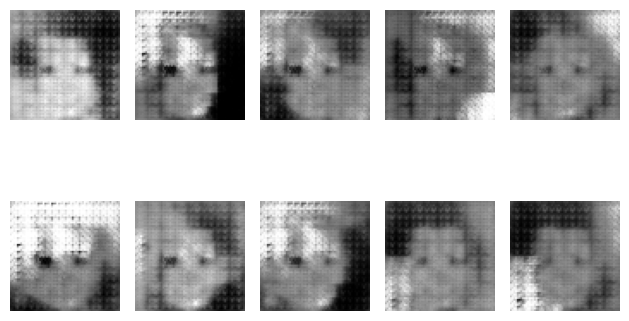

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 0.9244831800460815 GAN 1.2850687503814697
지금 epoch 몇회냐면 186
1/1 [==============================] - 0s 31ms/step


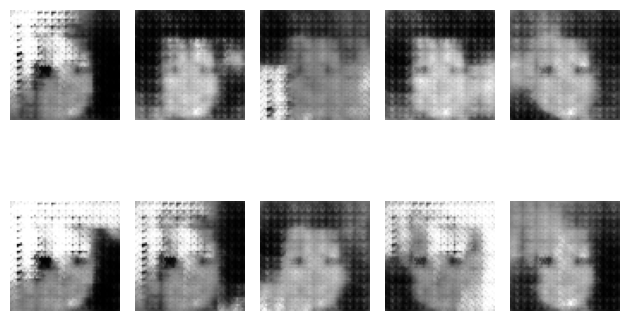

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 0.9976300299167633 GAN 1.1325533390045166
지금 epoch 몇회냐면 187
1/1 [==============================] - 0s 33ms/step


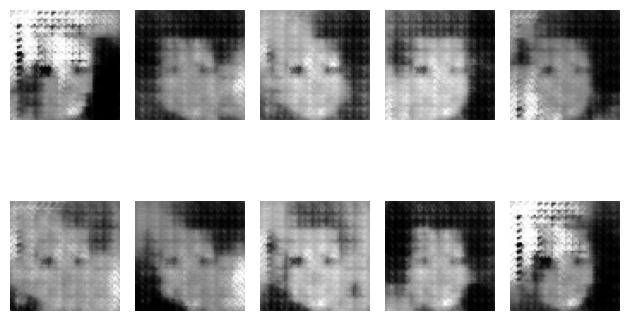

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0909375548362732 GAN 1.2225830554962158
지금 epoch 몇회냐면 188
1/1 [==============================] - 0s 26ms/step


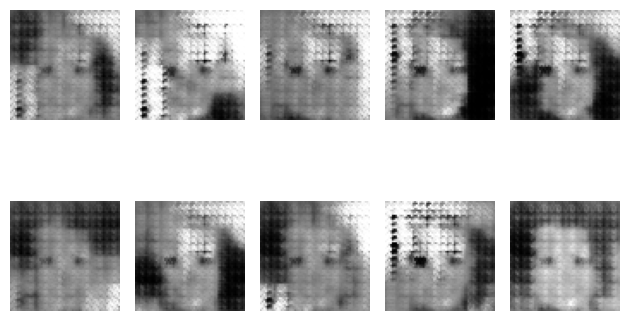

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.0811861157417297 GAN 1.2175978422164917
지금 epoch 몇회냐면 189
1/1 [==============================] - 0s 29ms/step


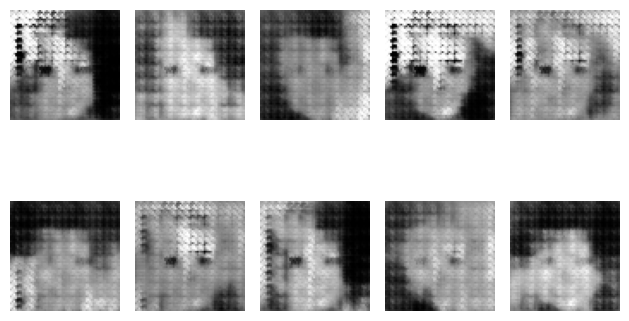

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0850412845611572 GAN 1.267608642578125
지금 epoch 몇회냐면 190
1/1 [==============================] - 0s 37ms/step


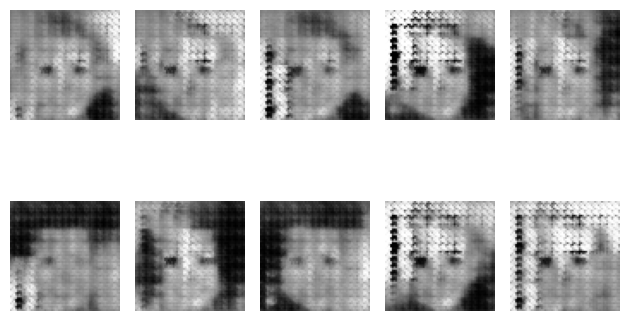

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 7ms/step
이번 epoch의 최종 loss는 Discriminator 0.998395562171936 GAN 1.2731623649597168
지금 epoch 몇회냐면 191
1/1 [==============================] - 0s 37ms/step


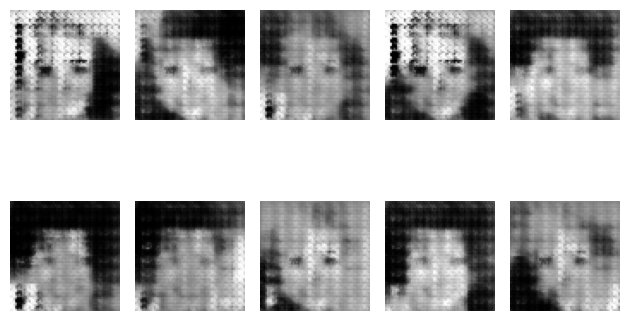

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 7ms/step
이번 epoch의 최종 loss는 Discriminator 1.0639770030975342 GAN 1.300527572631836
지금 epoch 몇회냐면 192
1/1 [==============================] - 0s 31ms/step


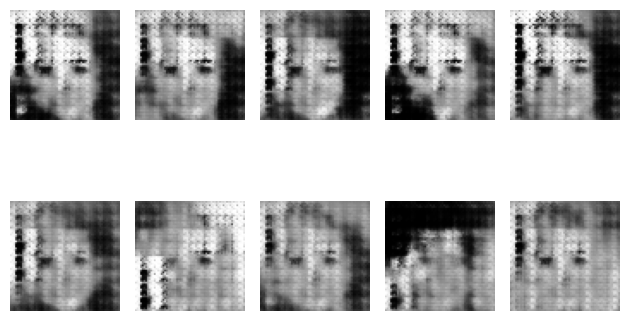

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0491072535514832 GAN 1.2871360778808594
지금 epoch 몇회냐면 193
1/1 [==============================] - 0s 30ms/step


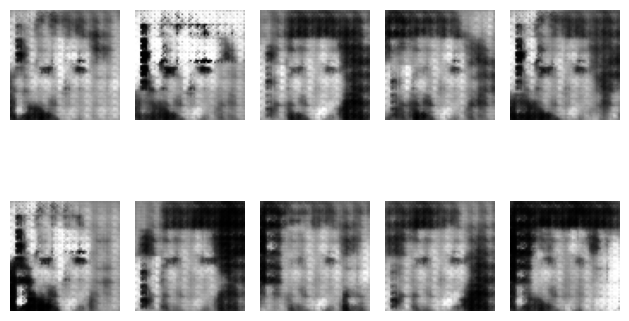

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.1300854086875916 GAN 1.1982425451278687
지금 epoch 몇회냐면 194
1/1 [==============================] - 0s 32ms/step


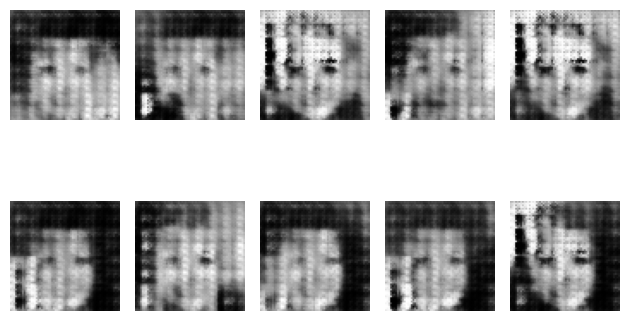

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.1268921494483948 GAN 1.1651365756988525
지금 epoch 몇회냐면 195
1/1 [==============================] - 0s 30ms/step


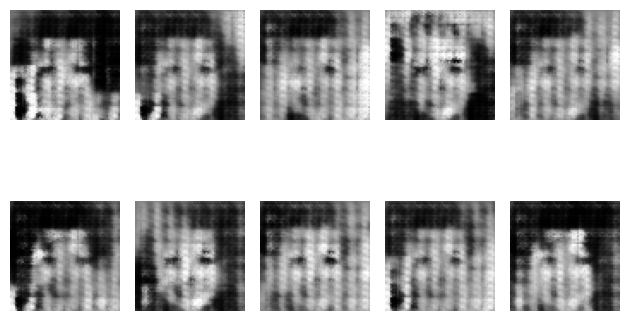

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.2298073768615723 GAN 0.9688136577606201
지금 epoch 몇회냐면 196
1/1 [==============================] - 0s 32ms/step


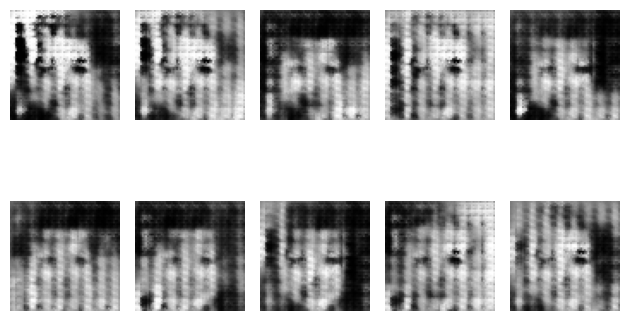

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.269778549671173 GAN 1.042547583580017
지금 epoch 몇회냐면 197
1/1 [==============================] - 0s 28ms/step


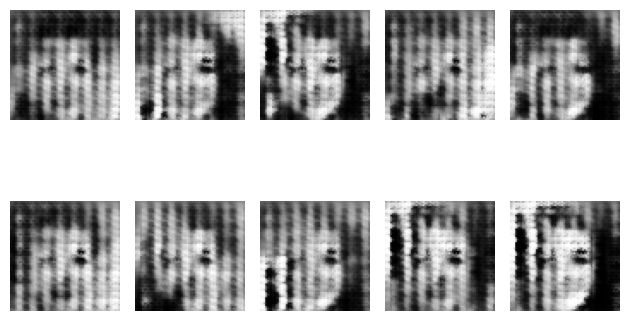

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.0945417881011963 GAN 1.2871159315109253
지금 epoch 몇회냐면 198
1/1 [==============================] - 0s 37ms/step


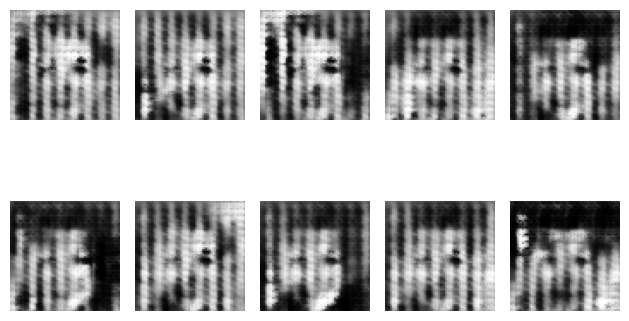

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 0.9722031354904175 GAN 1.6107327938079834
지금 epoch 몇회냐면 199
1/1 [==============================] - 0s 28ms/step


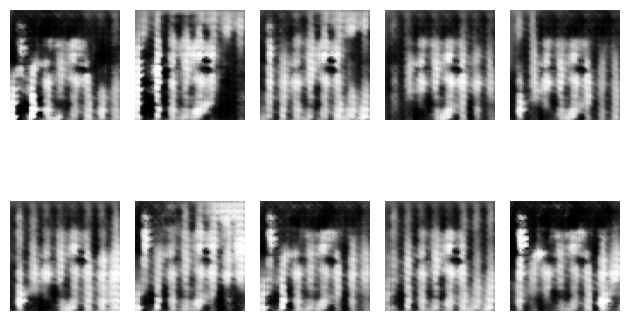

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 0.8988853991031647 GAN 1.786348581314087
지금 epoch 몇회냐면 200
1/1 [==============================] - 0s 44ms/step


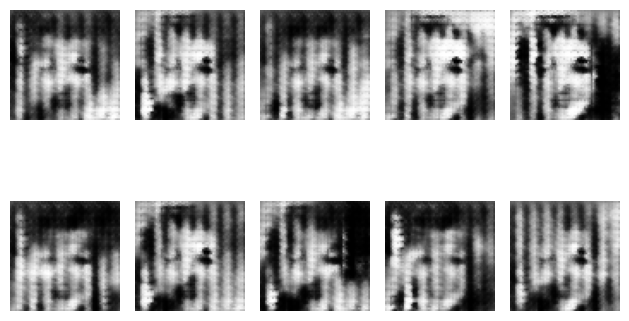

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 0.9680459499359131 GAN 1.7137415409088135
지금 epoch 몇회냐면 201
1/1 [==============================] - 0s 64ms/step


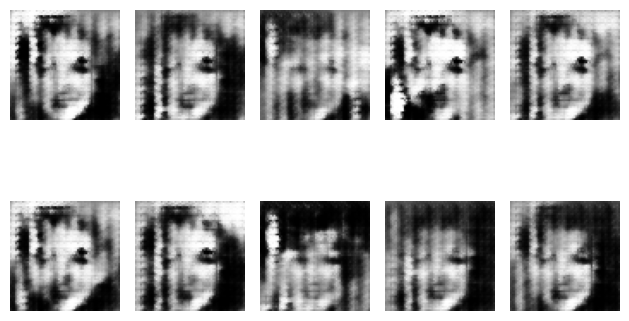

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 7ms/step
이번 epoch의 최종 loss는 Discriminator 1.1330267190933228 GAN 1.455418586730957
지금 epoch 몇회냐면 202
1/1 [==============================] - 0s 48ms/step


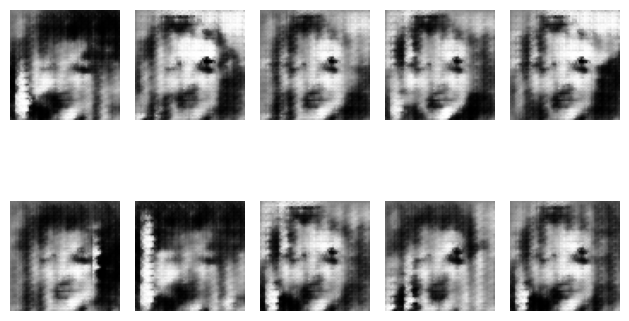

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.3950059413909912 GAN 1.3580726385116577
지금 epoch 몇회냐면 203
1/1 [==============================] - 0s 41ms/step


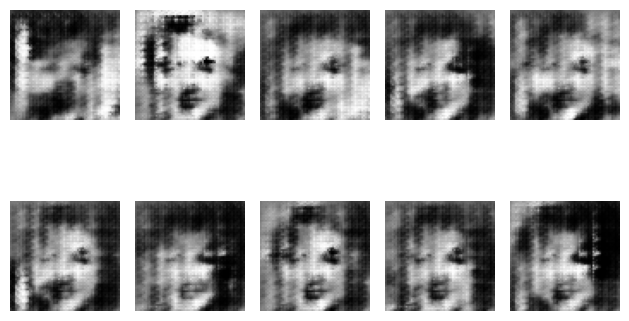

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.3964079022407532 GAN 1.176375389099121
지금 epoch 몇회냐면 204
1/1 [==============================] - 0s 39ms/step


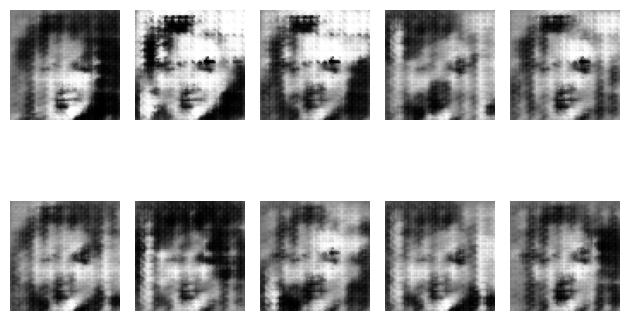

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.3345698714256287 GAN 1.2328975200653076
지금 epoch 몇회냐면 205
1/1 [==============================] - 0s 32ms/step


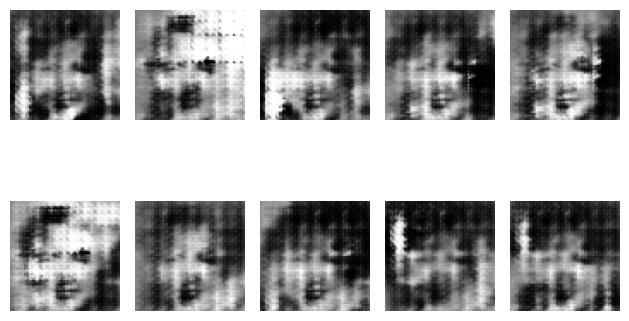

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.3088827729225159 GAN 1.3050627708435059
지금 epoch 몇회냐면 206
1/1 [==============================] - 0s 33ms/step


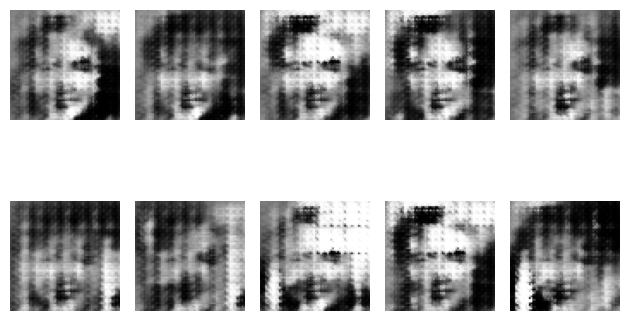

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.0657061338424683 GAN 1.217955470085144
지금 epoch 몇회냐면 207
1/1 [==============================] - 0s 32ms/step


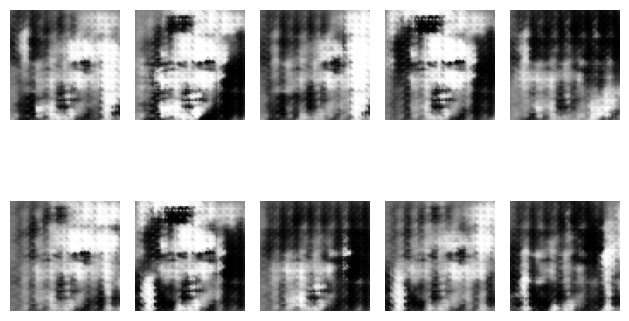

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.1424819231033325 GAN 1.1326172351837158
지금 epoch 몇회냐면 208
1/1 [==============================] - 0s 30ms/step


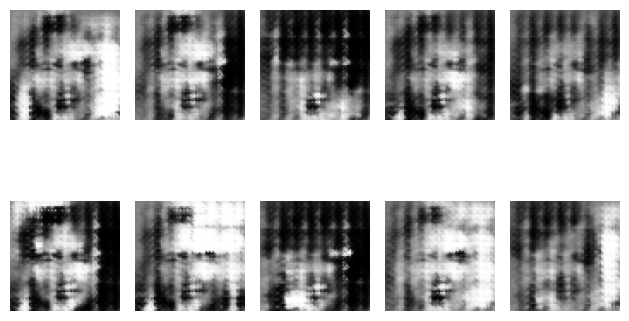

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.064947485923767 GAN 1.1237850189208984
지금 epoch 몇회냐면 209
1/1 [==============================] - 0s 37ms/step


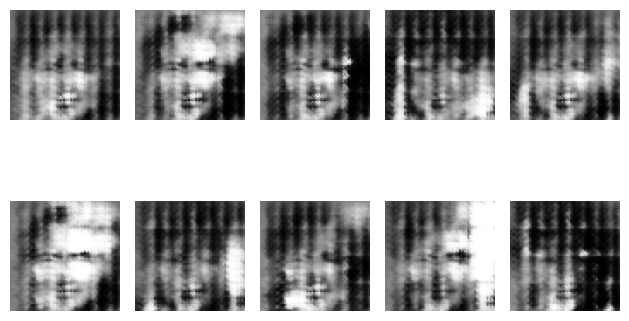

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.1362828314304352 GAN 1.0145037174224854
지금 epoch 몇회냐면 210
1/1 [==============================] - 0s 71ms/step


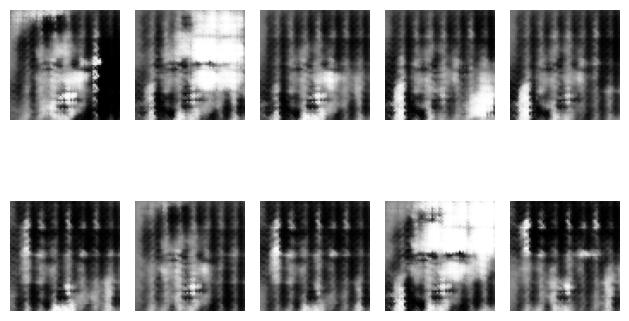

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 0.9992903769016266 GAN 0.9982502460479736
지금 epoch 몇회냐면 211
1/1 [==============================] - 0s 29ms/step


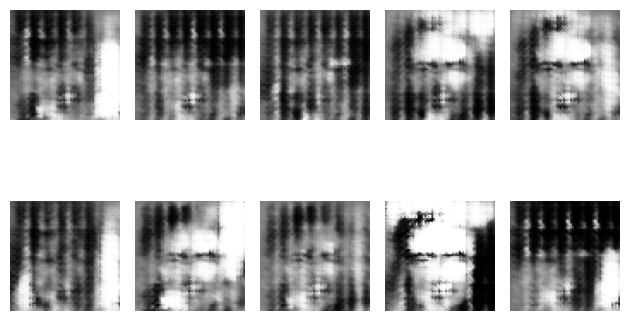

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.8862964808940887 GAN 0.9145019054412842
지금 epoch 몇회냐면 212
1/1 [==============================] - 0s 39ms/step


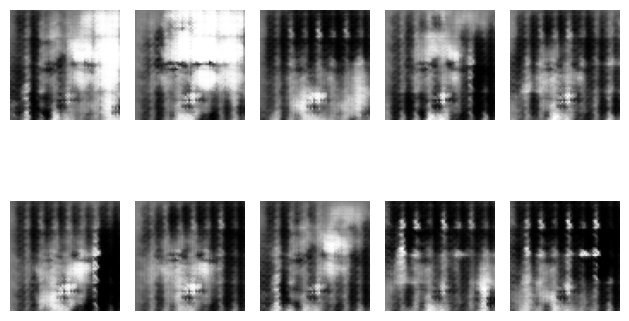

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.875394195318222 GAN 0.8515347838401794
지금 epoch 몇회냐면 213
1/1 [==============================] - 0s 36ms/step


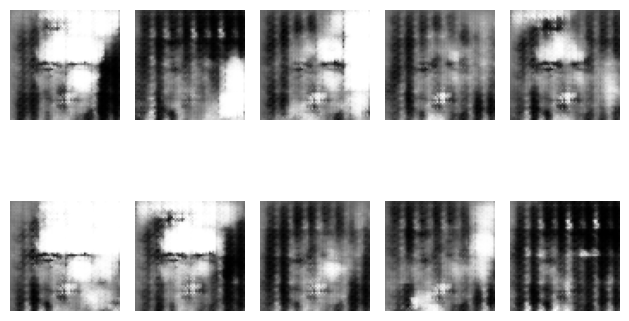

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 0.8313430845737457 GAN 0.7100051641464233
지금 epoch 몇회냐면 214
1/1 [==============================] - 0s 27ms/step


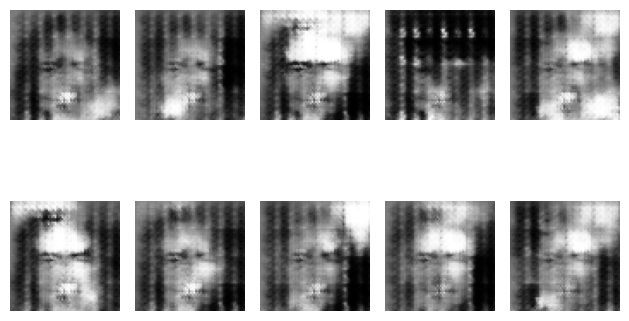

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 0.6965623199939728 GAN 1.0665382146835327
지금 epoch 몇회냐면 215
1/1 [==============================] - 0s 29ms/step


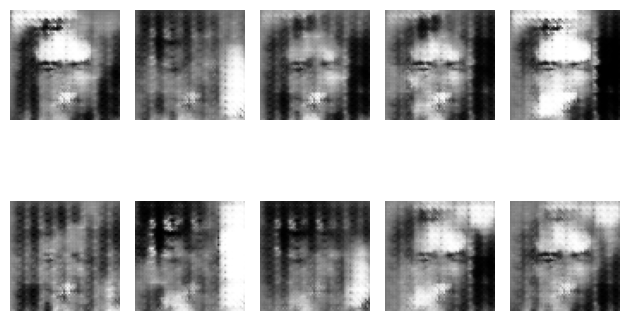

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 8ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.7179468274116516 GAN 1.0203168392181396
지금 epoch 몇회냐면 216
1/1 [==============================] - 0s 44ms/step


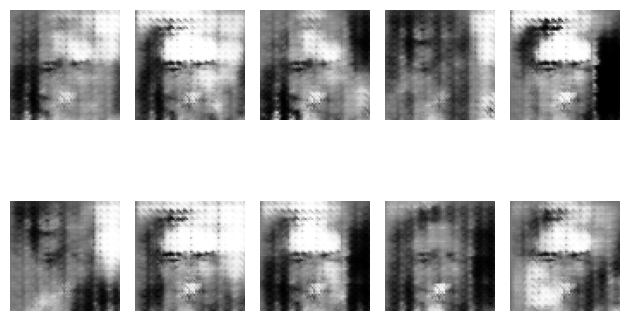

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 0.6904709339141846 GAN 0.8633095026016235
지금 epoch 몇회냐면 217
1/1 [==============================] - 0s 30ms/step


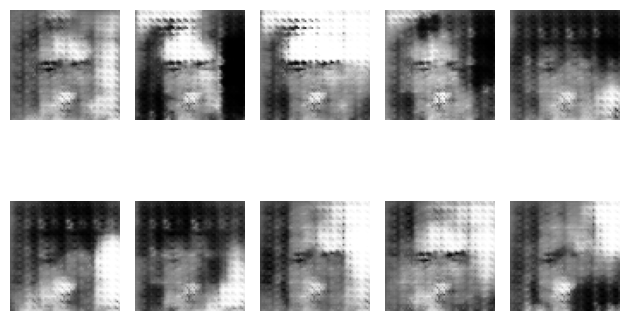

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.8707462847232819 GAN 1.1215698719024658
지금 epoch 몇회냐면 218
1/1 [==============================] - 0s 44ms/step


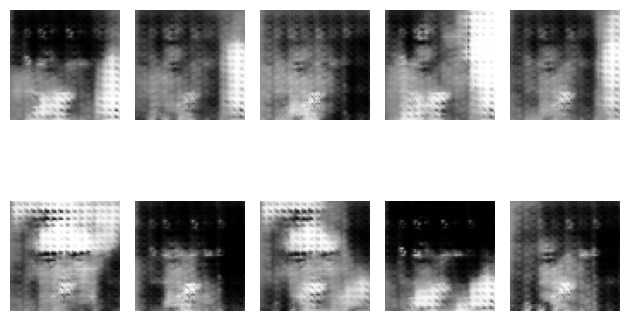

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.8643007874488831 GAN 1.25367271900177
지금 epoch 몇회냐면 219
1/1 [==============================] - 0s 38ms/step


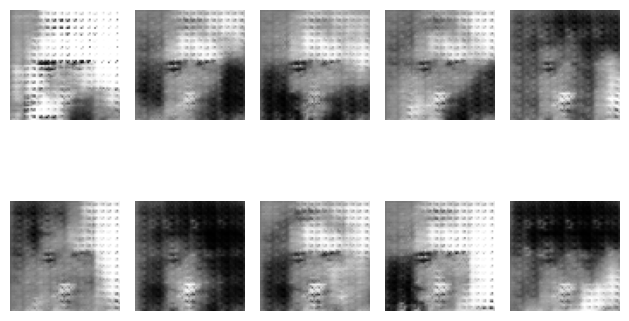

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 8ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 8ms/step
이번 epoch의 최종 loss는 Discriminator 0.7816414833068848 GAN 1.3214221000671387
지금 epoch 몇회냐면 220
1/1 [==============================] - 0s 60ms/step


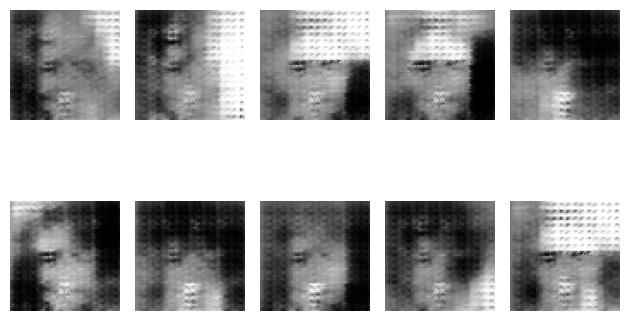

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 0.7677130699157715 GAN 1.2654684782028198
지금 epoch 몇회냐면 221
1/1 [==============================] - 0s 61ms/step


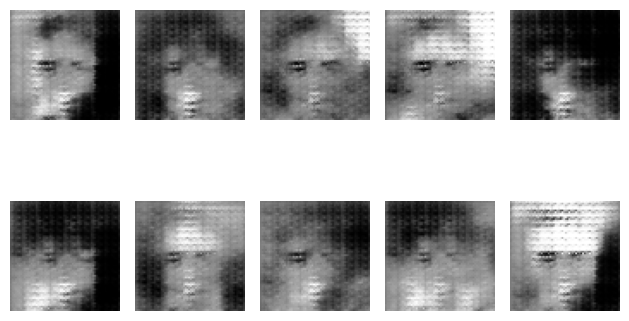

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.7557246088981628 GAN 1.272476077079773
지금 epoch 몇회냐면 222
1/1 [==============================] - 0s 41ms/step


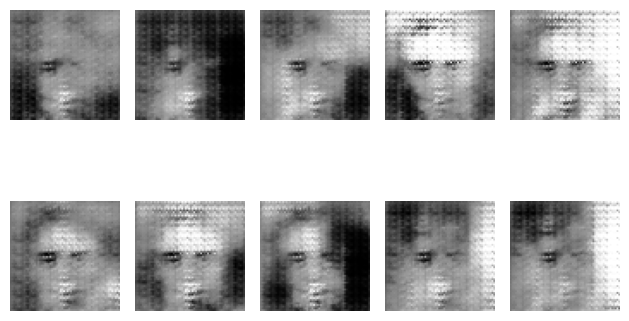

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.8235722184181213 GAN 1.4911144971847534
지금 epoch 몇회냐면 223
1/1 [==============================] - 0s 32ms/step


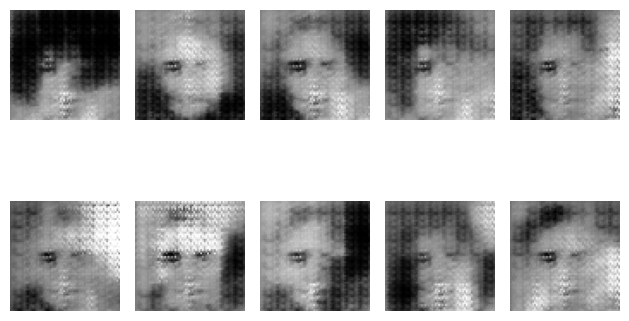

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 0.9668210446834564 GAN 1.4918745756149292
지금 epoch 몇회냐면 224
1/1 [==============================] - 0s 37ms/step


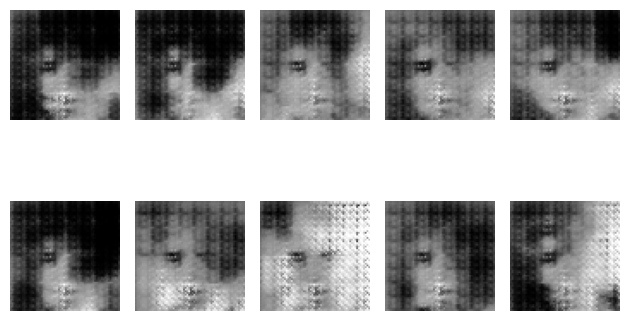

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0175235867500305 GAN 1.4873400926589966
지금 epoch 몇회냐면 225
1/1 [==============================] - 0s 29ms/step


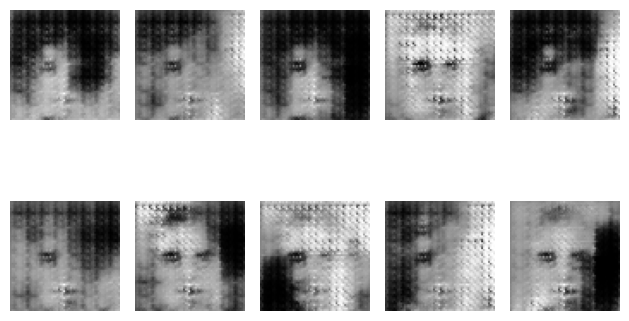

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0268027186393738 GAN 1.4816845655441284
지금 epoch 몇회냐면 226
1/1 [==============================] - 0s 35ms/step


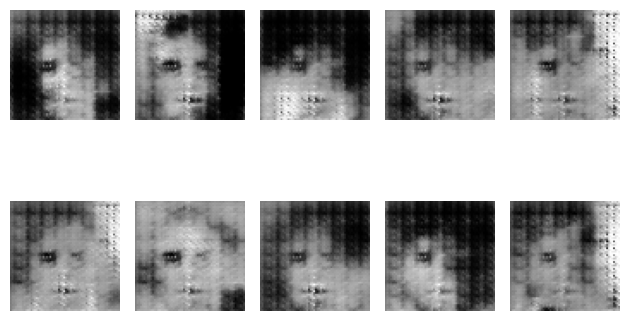

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.1951429843902588 GAN 1.575129747390747
지금 epoch 몇회냐면 227
1/1 [==============================] - 0s 29ms/step


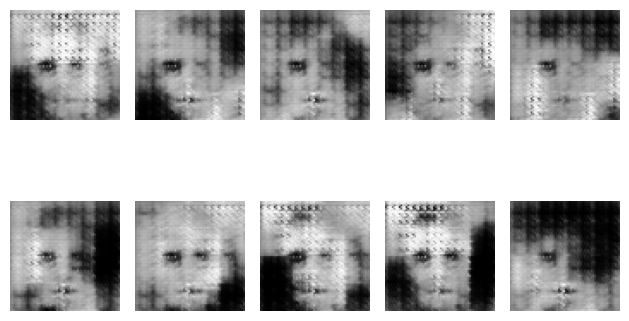

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.1316143870353699 GAN 1.5379931926727295
지금 epoch 몇회냐면 228
1/1 [==============================] - 0s 32ms/step


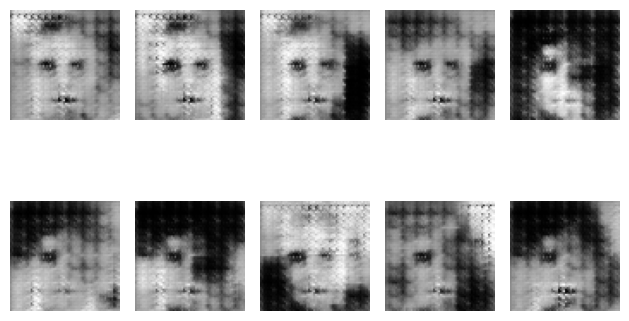

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.070807158946991 GAN 1.37388014793396
지금 epoch 몇회냐면 229
1/1 [==============================] - 0s 61ms/step


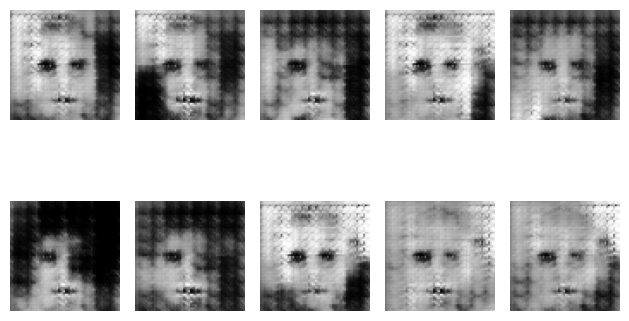

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 7ms/step
이번 epoch의 최종 loss는 Discriminator 0.9814920723438263 GAN 1.4614557027816772
지금 epoch 몇회냐면 230
1/1 [==============================] - 0s 31ms/step


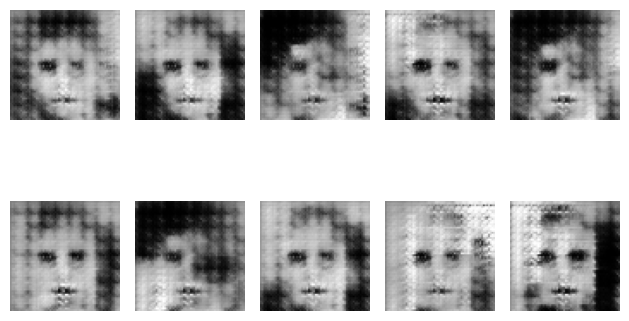

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 0.947486162185669 GAN 1.6112908124923706
지금 epoch 몇회냐면 231
1/1 [==============================] - 0s 50ms/step


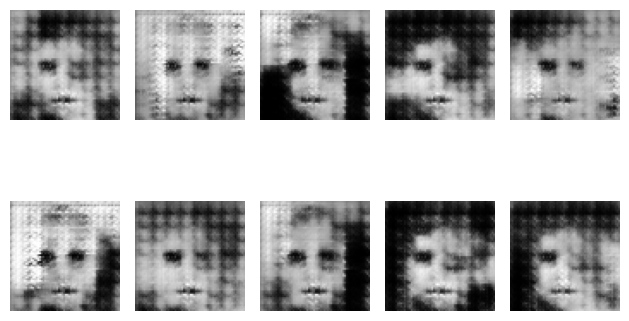

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 8ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 9ms/step
이번 epoch의 최종 loss는 Discriminator 0.8466507196426392 GAN 1.7959967851638794
지금 epoch 몇회냐면 232
1/1 [==============================] - 0s 30ms/step


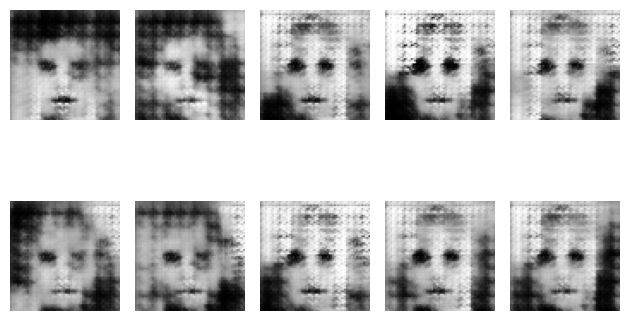

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.8340831398963928 GAN 1.843048095703125
지금 epoch 몇회냐면 233
1/1 [==============================] - 0s 29ms/step


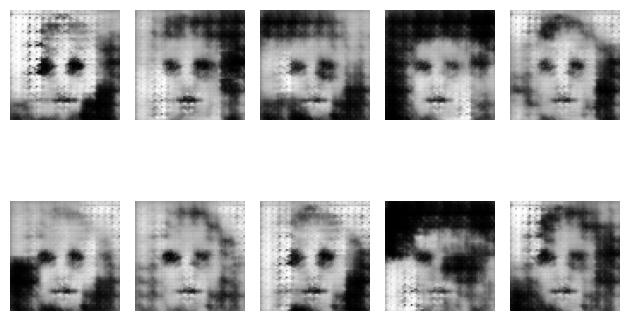

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 0.8090109527111053 GAN 1.8279714584350586
지금 epoch 몇회냐면 234
1/1 [==============================] - 0s 32ms/step


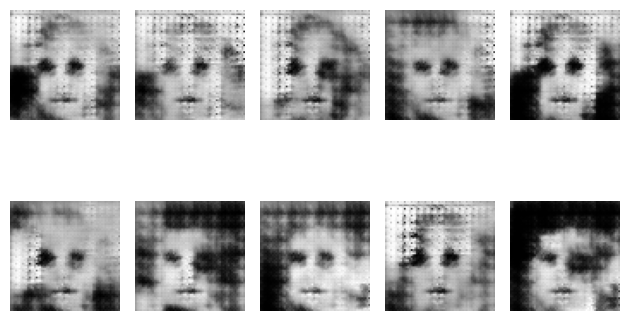

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.000110387802124 GAN 1.5231730937957764
지금 epoch 몇회냐면 235
1/1 [==============================] - 0s 33ms/step


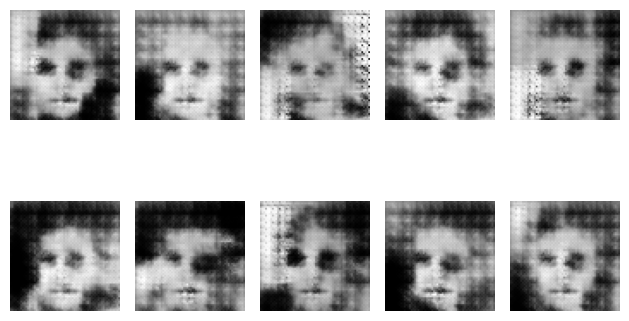

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 8ms/step
이번 epoch의 최종 loss는 Discriminator 1.1299800276756287 GAN 1.544892430305481
지금 epoch 몇회냐면 236
1/1 [==============================] - 0s 41ms/step


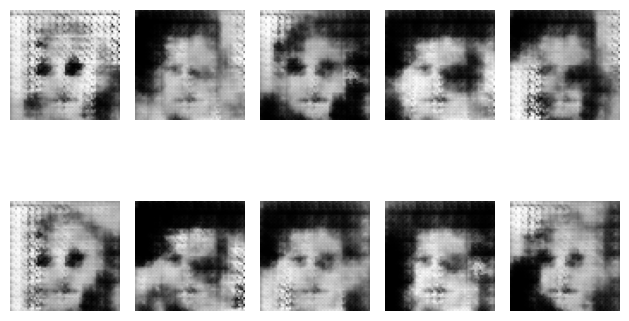

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.047827124595642 GAN 1.564353346824646
지금 epoch 몇회냐면 237
1/1 [==============================] - 0s 35ms/step


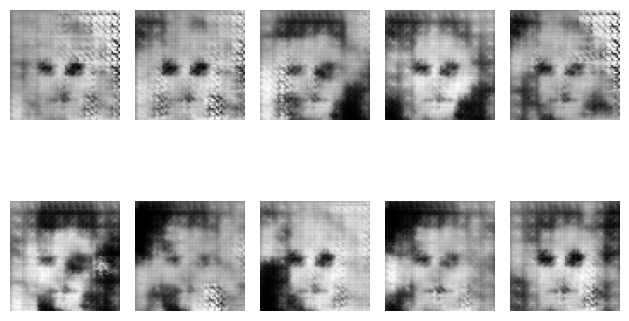

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.1293847560882568 GAN 1.5126454830169678
지금 epoch 몇회냐면 238
1/1 [==============================] - 0s 38ms/step


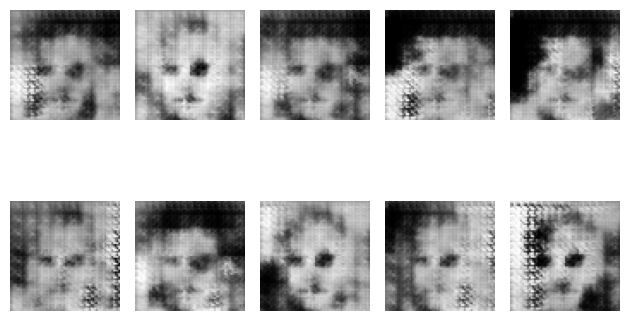

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.2002771496772766 GAN 1.2898969650268555
지금 epoch 몇회냐면 239
1/1 [==============================] - 0s 38ms/step


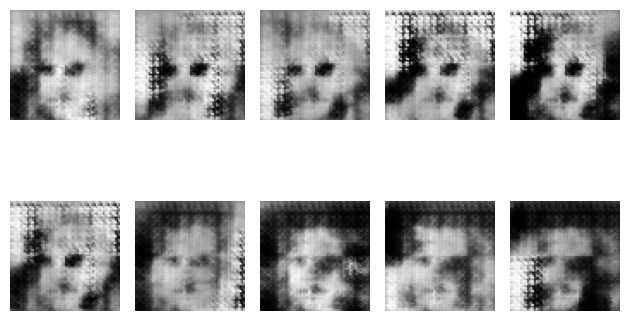

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 8ms/step
이번 epoch의 최종 loss는 Discriminator 1.1222718358039856 GAN 1.1523902416229248
지금 epoch 몇회냐면 240
1/1 [==============================] - 0s 53ms/step


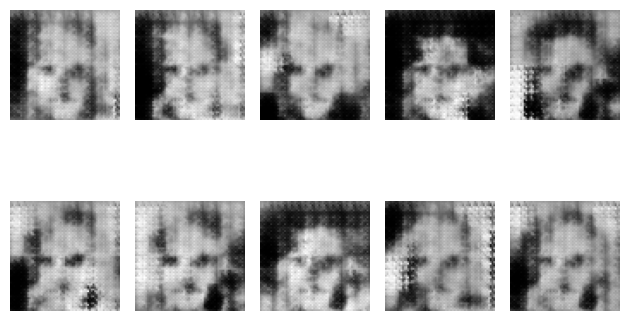

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 7ms/step
이번 epoch의 최종 loss는 Discriminator 1.0001976490020752 GAN 1.4189879894256592
지금 epoch 몇회냐면 241
1/1 [==============================] - 0s 52ms/step


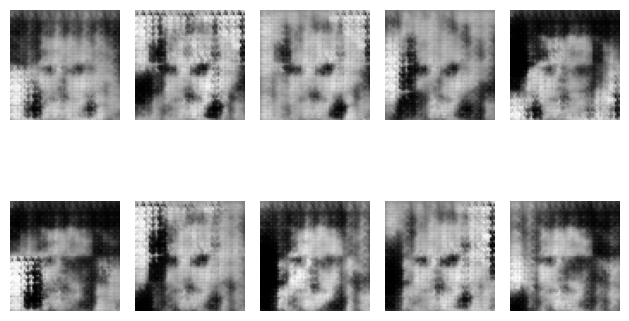

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0348548293113708 GAN 1.272040843963623
지금 epoch 몇회냐면 242
1/1 [==============================] - 0s 26ms/step


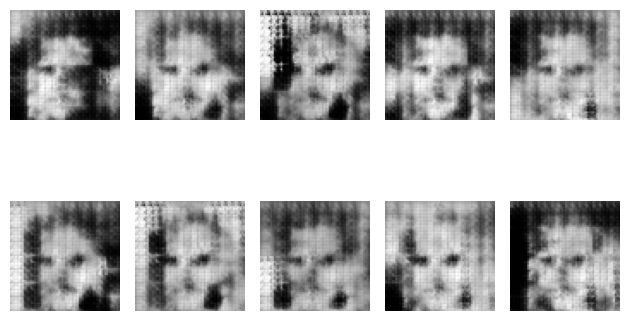

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0875068306922913 GAN 1.3182642459869385
지금 epoch 몇회냐면 243
1/1 [==============================] - 0s 37ms/step


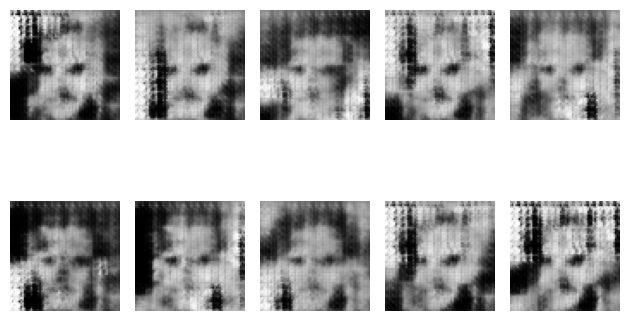

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.021486908197403 GAN 1.218696117401123
지금 epoch 몇회냐면 244
1/1 [==============================] - 0s 29ms/step


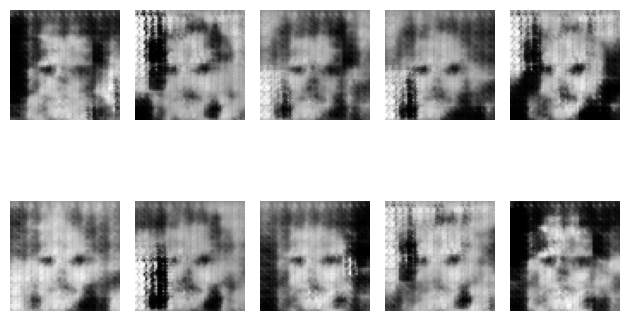

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.1480905413627625 GAN 1.0569407939910889
지금 epoch 몇회냐면 245
1/1 [==============================] - 0s 30ms/step


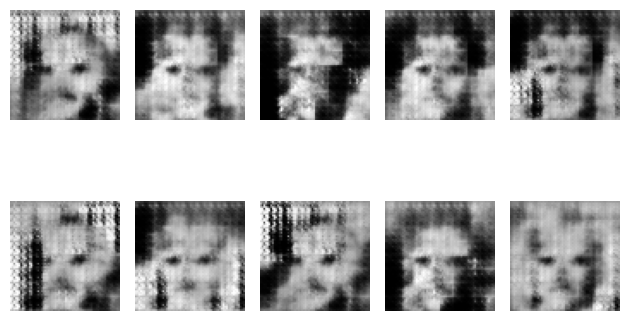

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0962032675743103 GAN 1.0681716203689575
지금 epoch 몇회냐면 246
1/1 [==============================] - 0s 37ms/step


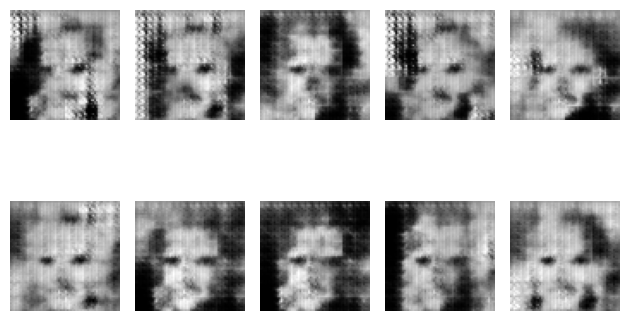

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0676898956298828 GAN 1.12185537815094
지금 epoch 몇회냐면 247
1/1 [==============================] - 0s 33ms/step


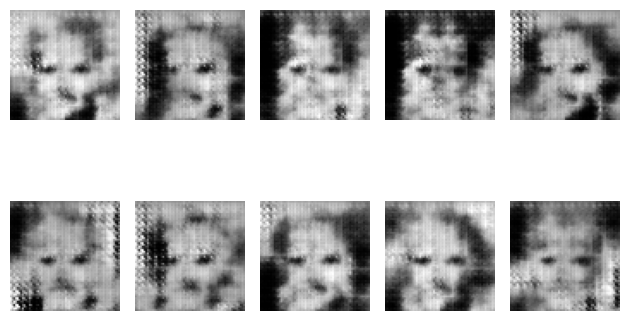

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 7ms/step
이번 epoch의 최종 loss는 Discriminator 1.0766545534133911 GAN 1.149084448814392
지금 epoch 몇회냐면 248
1/1 [==============================] - 0s 37ms/step


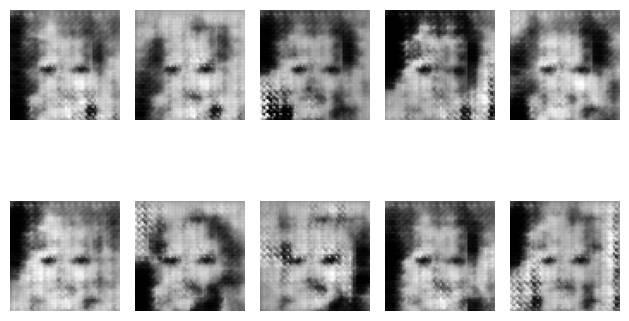

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 7ms/step
이번 epoch의 최종 loss는 Discriminator 1.1374422907829285 GAN 1.229013204574585
지금 epoch 몇회냐면 249
1/1 [==============================] - 0s 74ms/step


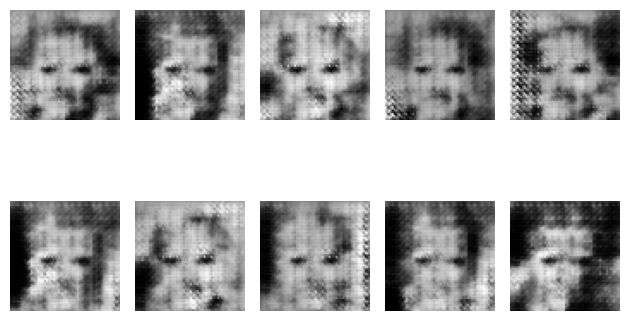

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.9734174907207489 GAN 1.4351435899734497
지금 epoch 몇회냐면 250
1/1 [==============================] - 0s 54ms/step


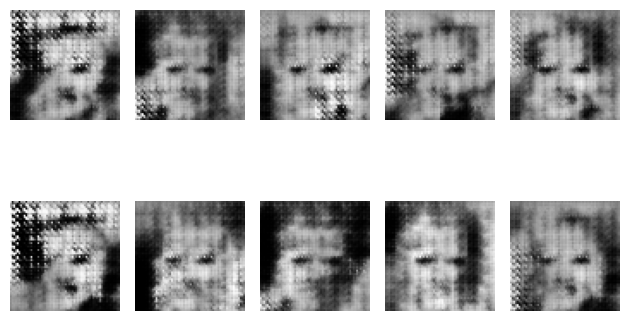

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.8980975151062012 GAN 1.3472232818603516
지금 epoch 몇회냐면 251
1/1 [==============================] - 0s 32ms/step


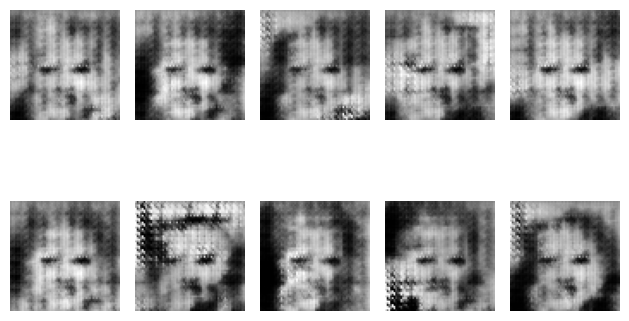

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 0.9524094462394714 GAN 1.2749857902526855
지금 epoch 몇회냐면 252
1/1 [==============================] - 0s 29ms/step


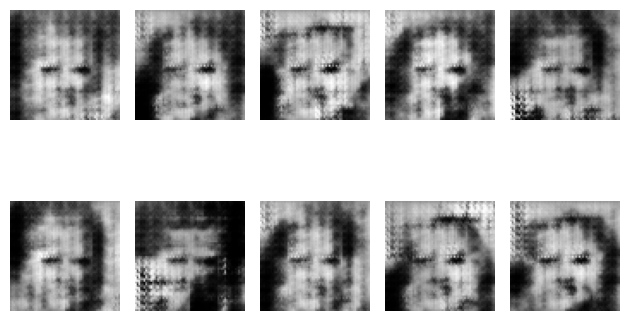

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.006332904100418 GAN 1.2198973894119263
지금 epoch 몇회냐면 253
1/1 [==============================] - 0s 35ms/step


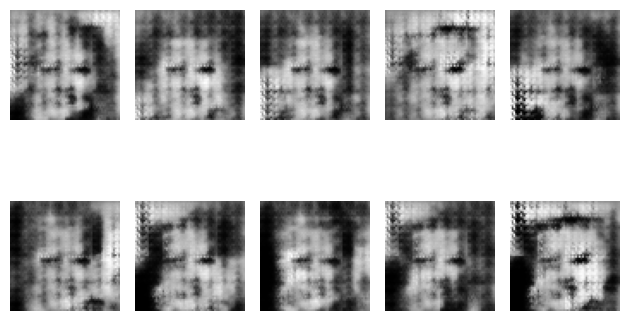

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 0.934203028678894 GAN 1.371812343597412
지금 epoch 몇회냐면 254
1/1 [==============================] - 0s 38ms/step


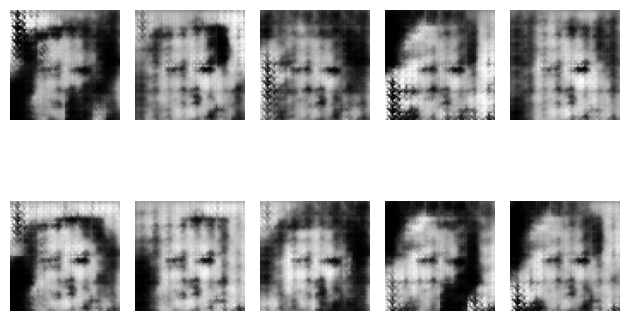

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 0.8070569634437561 GAN 1.6246381998062134
지금 epoch 몇회냐면 255
1/1 [==============================] - 0s 43ms/step


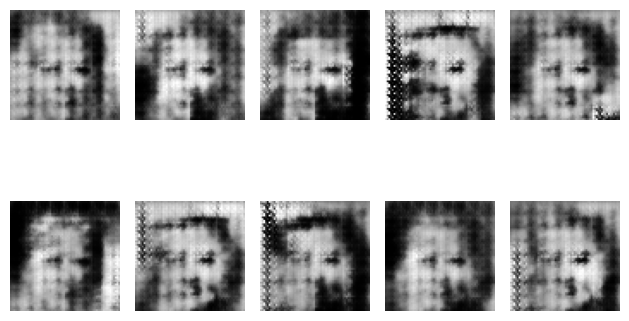

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.8360287845134735 GAN 1.5740165710449219
지금 epoch 몇회냐면 256
1/1 [==============================] - 0s 29ms/step


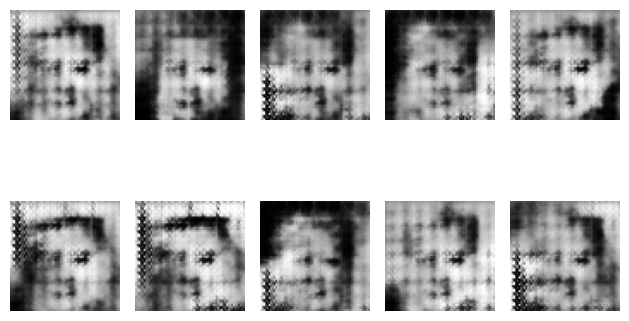

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0957142412662506 GAN 1.2310162782669067
지금 epoch 몇회냐면 257
1/1 [==============================] - 0s 47ms/step


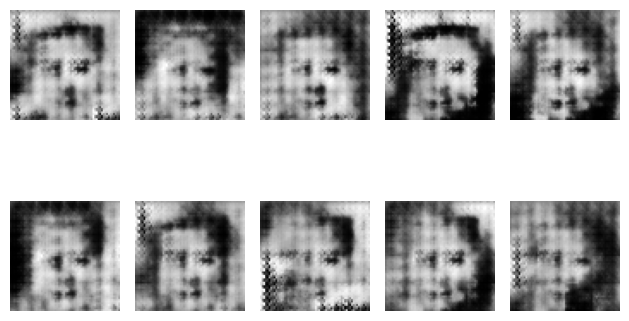

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.2142651677131653 GAN 1.3175833225250244
지금 epoch 몇회냐면 258
1/1 [==============================] - 0s 44ms/step


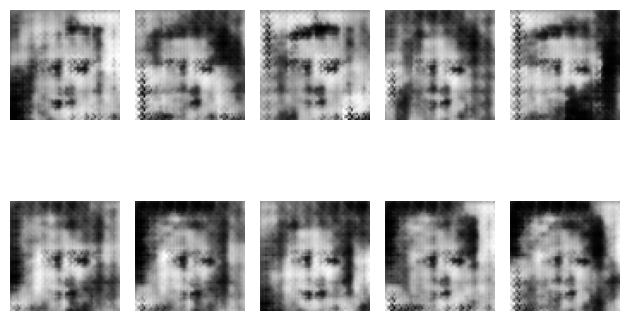

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.2784141898155212 GAN 1.202678918838501
지금 epoch 몇회냐면 259
1/1 [==============================] - 0s 42ms/step


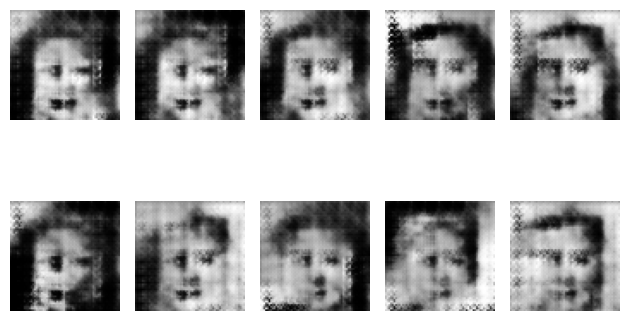

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.5549681186676025 GAN 1.19472074508667
지금 epoch 몇회냐면 260
1/1 [==============================] - 0s 28ms/step


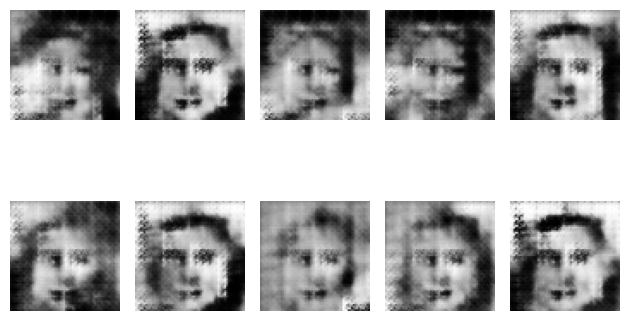

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.7353549003601074 GAN 1.1023480892181396
지금 epoch 몇회냐면 261
1/1 [==============================] - 0s 32ms/step


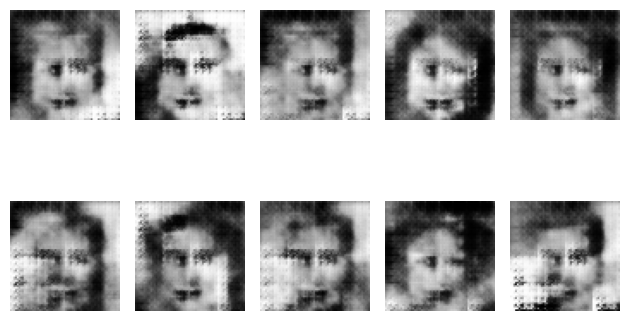

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.4852963089942932 GAN 1.0281333923339844
지금 epoch 몇회냐면 262
1/1 [==============================] - 0s 30ms/step


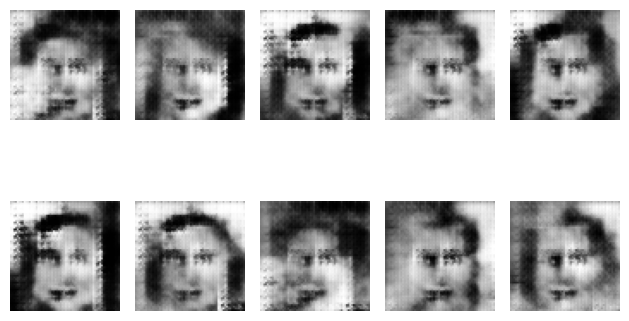

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.406593918800354 GAN 0.9710091948509216
지금 epoch 몇회냐면 263
1/1 [==============================] - 0s 29ms/step


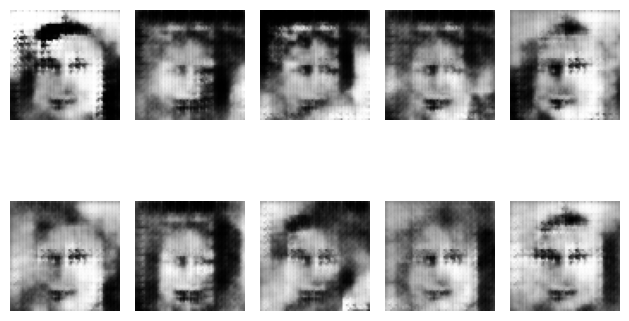

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.2213491201400757 GAN 1.1330714225769043
지금 epoch 몇회냐면 264
1/1 [==============================] - 0s 31ms/step


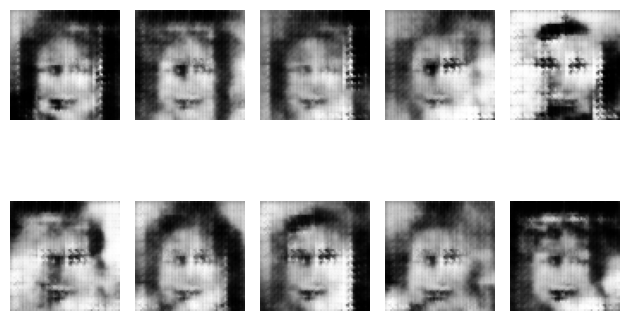

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0905693769454956 GAN 1.246534824371338
지금 epoch 몇회냐면 265
1/1 [==============================] - 0s 34ms/step


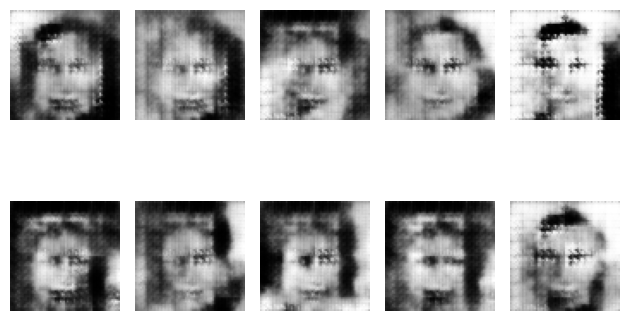

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.1710716485977173 GAN 1.336573839187622
지금 epoch 몇회냐면 266
1/1 [==============================] - 0s 31ms/step


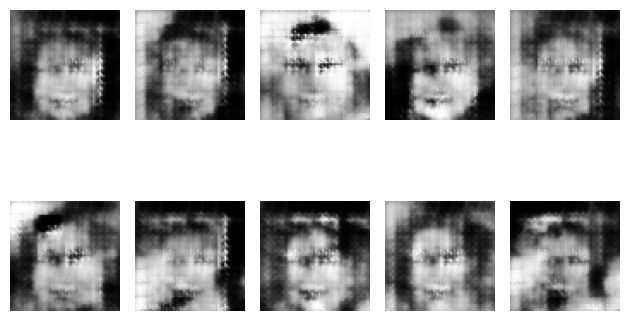

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.2024725675582886 GAN 1.1389676332473755
지금 epoch 몇회냐면 267
1/1 [==============================] - 0s 32ms/step


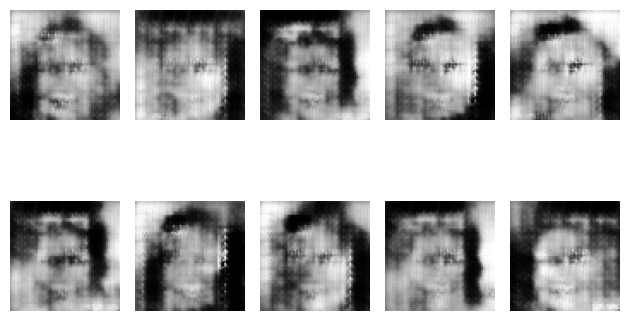

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.250635802745819 GAN 1.0644557476043701
지금 epoch 몇회냐면 268
1/1 [==============================] - 0s 44ms/step


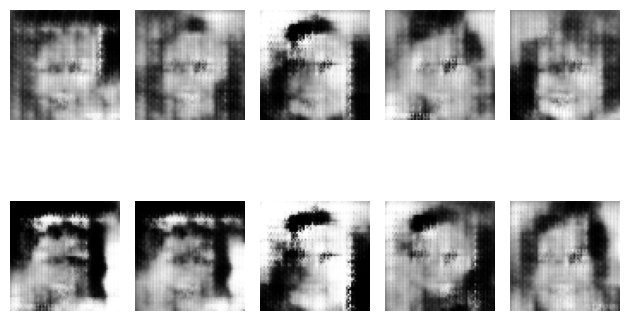

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.2636322975158691 GAN 1.3037464618682861
지금 epoch 몇회냐면 269
1/1 [==============================] - 0s 37ms/step


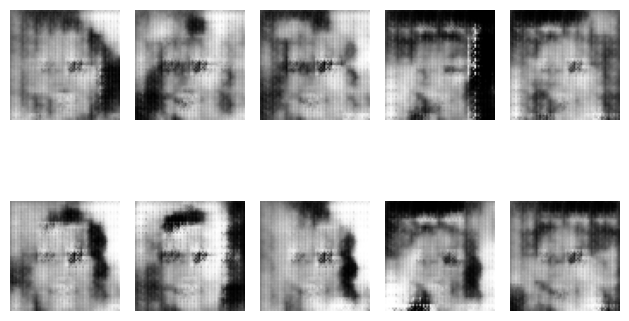

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.2363238334655762 GAN 1.2062103748321533
지금 epoch 몇회냐면 270
1/1 [==============================] - 0s 37ms/step


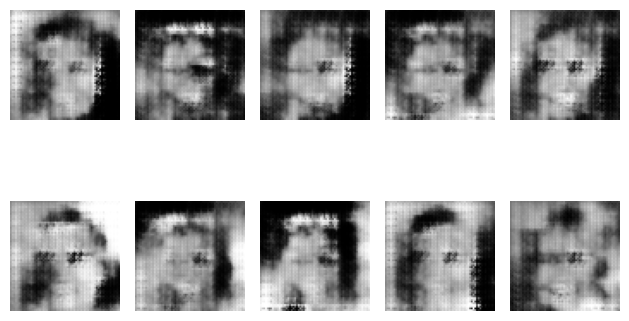

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.3479350805282593 GAN 1.1233056783676147
지금 epoch 몇회냐면 271
1/1 [==============================] - 0s 31ms/step


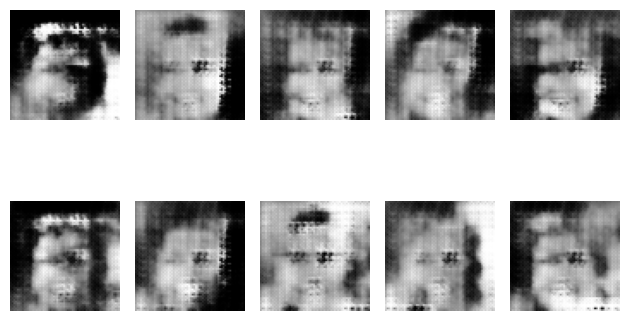

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.203404188156128 GAN 1.180718183517456
지금 epoch 몇회냐면 272
1/1 [==============================] - 0s 27ms/step


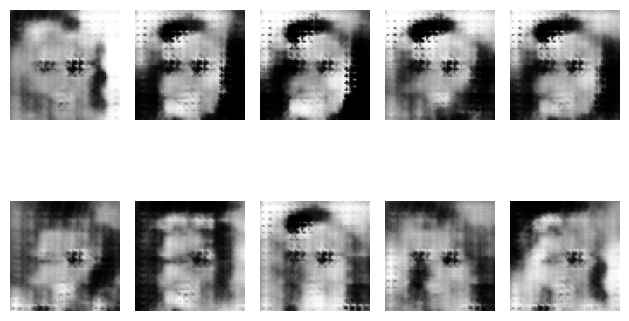

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0796270966529846 GAN 1.2305558919906616
지금 epoch 몇회냐면 273
1/1 [==============================] - 0s 30ms/step


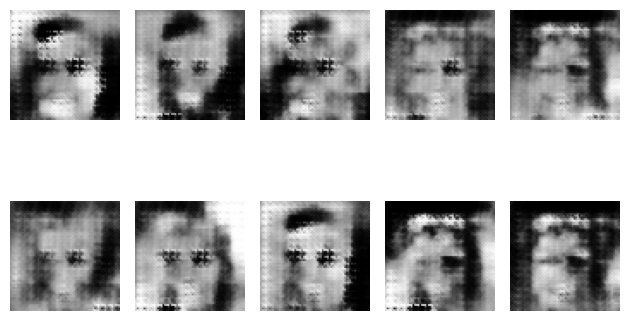

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 0.8923770785331726 GAN 1.271772027015686
지금 epoch 몇회냐면 274
1/1 [==============================] - 0s 30ms/step


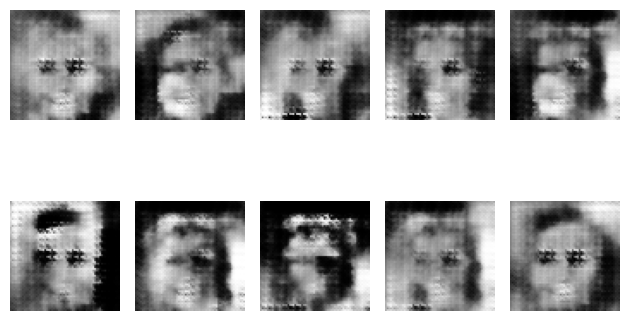

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 0.8736038208007812 GAN 1.3726780414581299
지금 epoch 몇회냐면 275
1/1 [==============================] - 0s 31ms/step


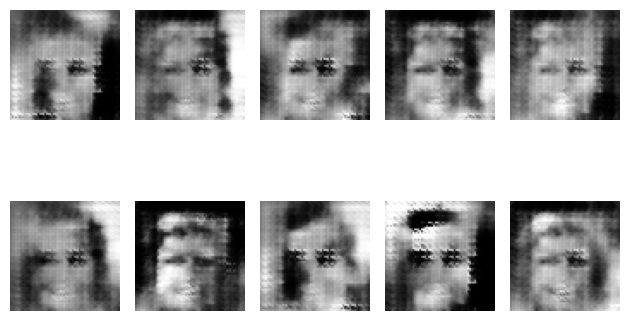

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.8279402852058411 GAN 1.3091531991958618
지금 epoch 몇회냐면 276
1/1 [==============================] - 0s 31ms/step


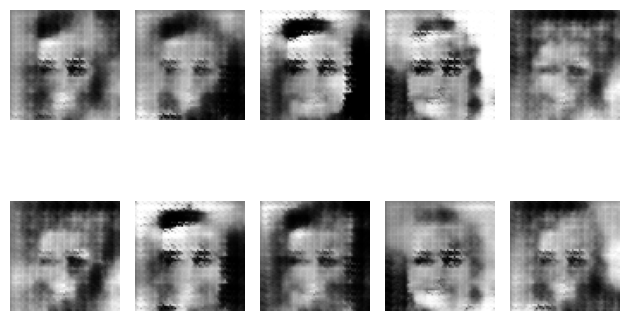

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.0270679295063019 GAN 1.2471489906311035
지금 epoch 몇회냐면 277
1/1 [==============================] - 0s 32ms/step


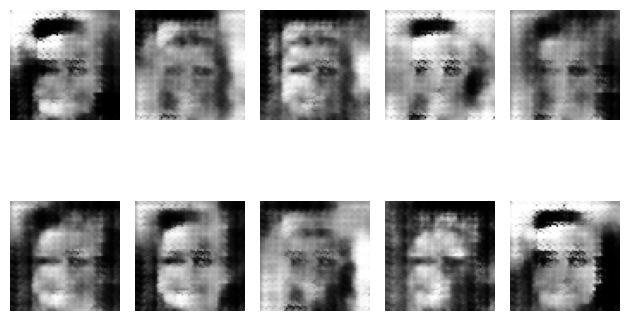

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.1422003507614136 GAN 1.0518028736114502
지금 epoch 몇회냐면 278
1/1 [==============================] - 0s 52ms/step


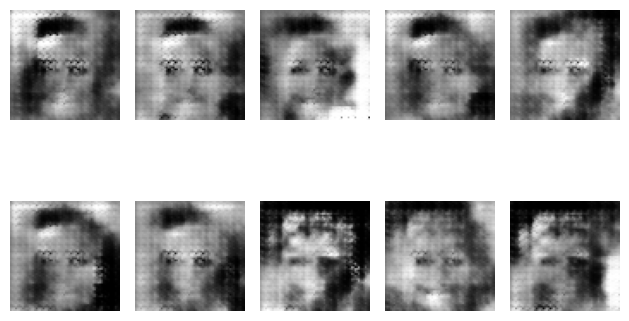

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 8ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.1719002723693848 GAN 1.176213026046753
지금 epoch 몇회냐면 279
1/1 [==============================] - 0s 53ms/step


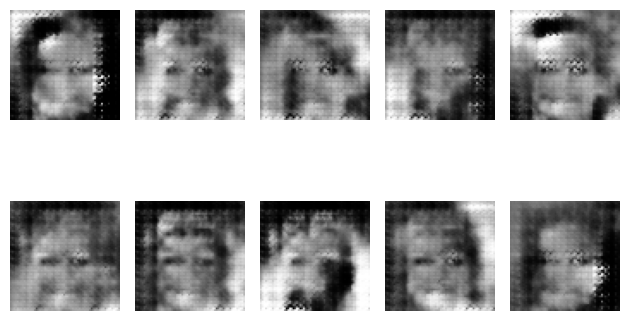

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.2652000188827515 GAN 0.9633545875549316
지금 epoch 몇회냐면 280
1/1 [==============================] - 0s 30ms/step


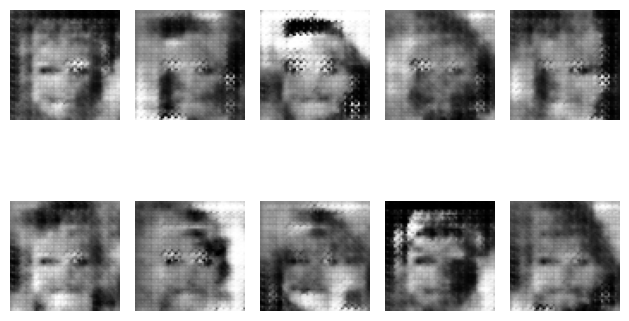

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.1499332189559937 GAN 1.2162513732910156
지금 epoch 몇회냐면 281
1/1 [==============================] - 0s 37ms/step


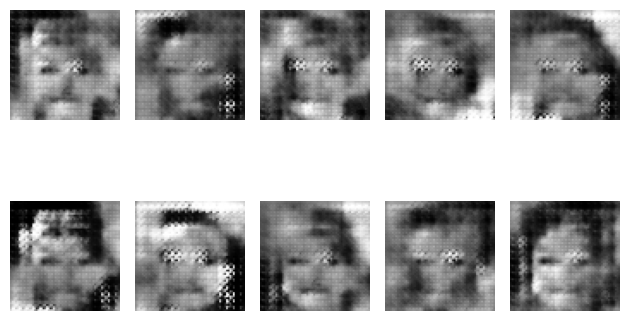

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.0964763760566711 GAN 1.4930822849273682
지금 epoch 몇회냐면 282
1/1 [==============================] - 0s 28ms/step


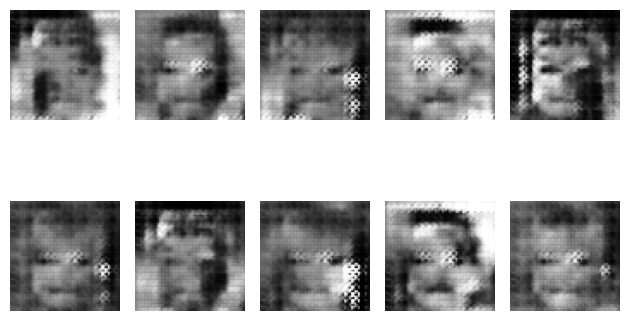

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0542899370193481 GAN 1.2174807786941528
지금 epoch 몇회냐면 283
1/1 [==============================] - 0s 33ms/step


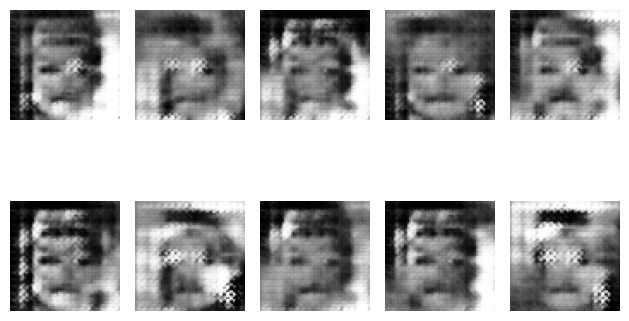

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.0113117694854736 GAN 1.230109453201294
지금 epoch 몇회냐면 284
1/1 [==============================] - 0s 31ms/step


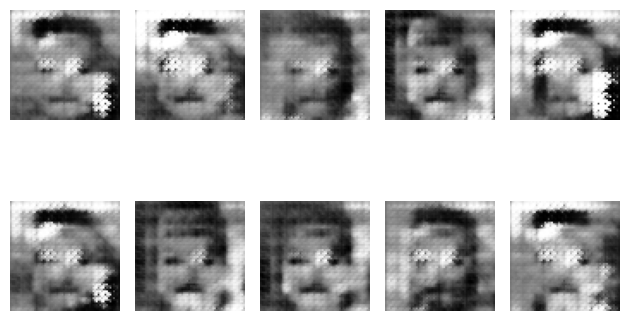

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.9901784062385559 GAN 1.2619585990905762
지금 epoch 몇회냐면 285
1/1 [==============================] - 0s 36ms/step


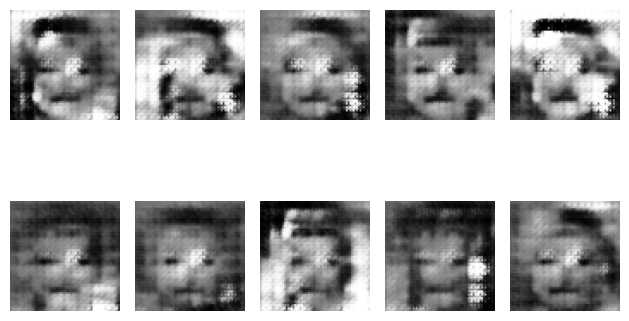

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 0.9550526142120361 GAN 1.1195194721221924
지금 epoch 몇회냐면 286
1/1 [==============================] - 0s 66ms/step


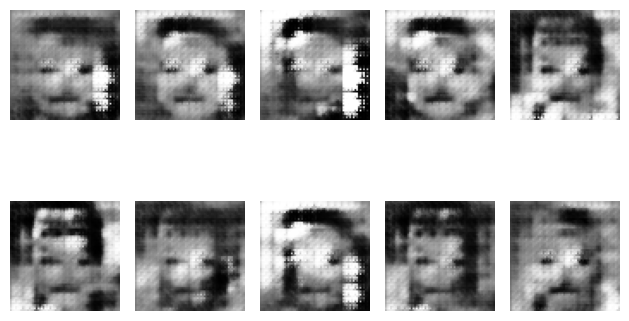

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 8ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.2209466695785522 GAN 1.1715744733810425
지금 epoch 몇회냐면 287
1/1 [==============================] - 0s 66ms/step


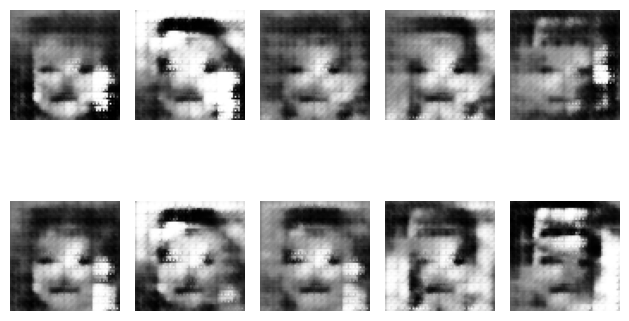

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 8ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 7ms/step
이번 epoch의 최종 loss는 Discriminator 1.2855323553085327 GAN 1.0894312858581543
지금 epoch 몇회냐면 288
1/1 [==============================] - 0s 71ms/step


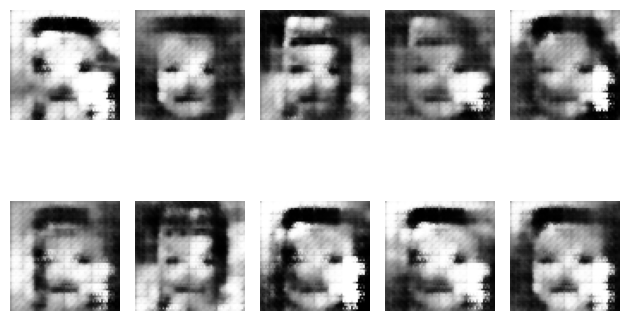

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.3147127628326416 GAN 1.1145060062408447
지금 epoch 몇회냐면 289
1/1 [==============================] - 0s 28ms/step


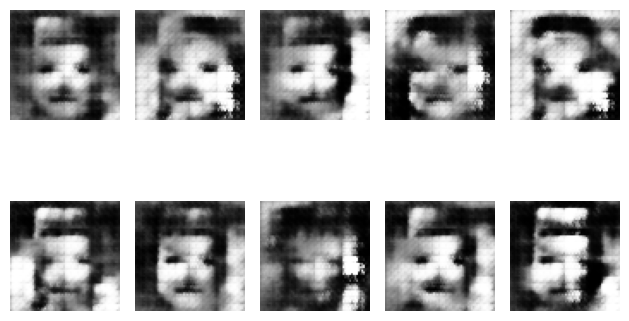

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.219964623451233 GAN 1.1596490144729614
지금 epoch 몇회냐면 290
1/1 [==============================] - 0s 32ms/step


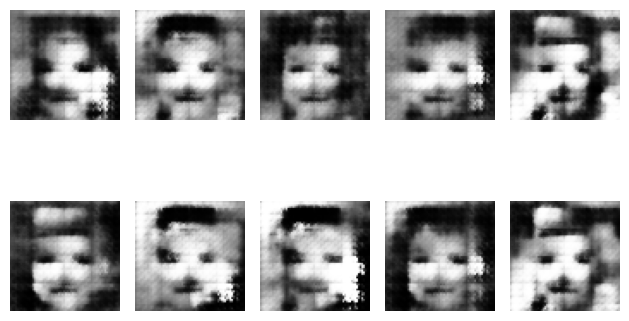

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 1.1068686842918396 GAN 1.1416760683059692
지금 epoch 몇회냐면 291
1/1 [==============================] - 0s 33ms/step


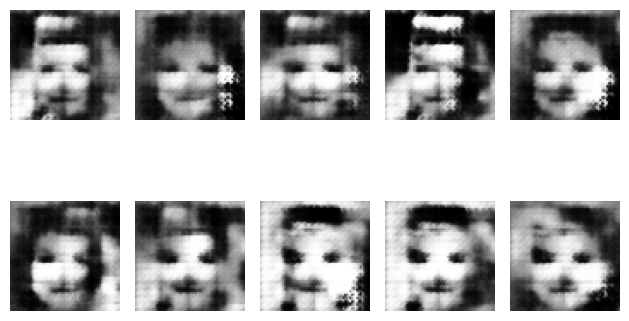

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.9633312225341797 GAN 1.6915600299835205
지금 epoch 몇회냐면 292
1/1 [==============================] - 0s 30ms/step


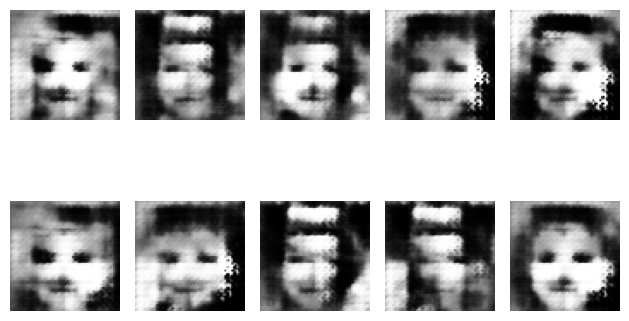

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.8862769305706024 GAN 1.5142405033111572
지금 epoch 몇회냐면 293
1/1 [==============================] - 0s 27ms/step


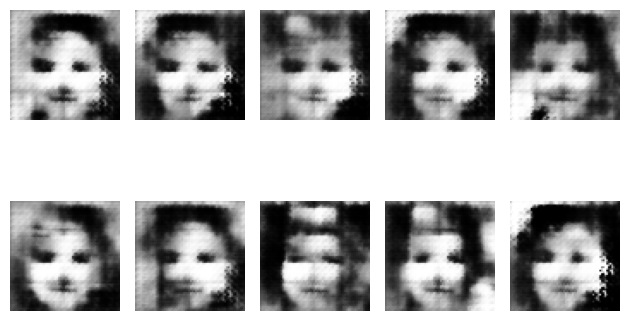

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 5ms/step
이번 epoch의 최종 loss는 Discriminator 0.8707339763641357 GAN 1.5540302991867065
지금 epoch 몇회냐면 294
1/1 [==============================] - 0s 38ms/step


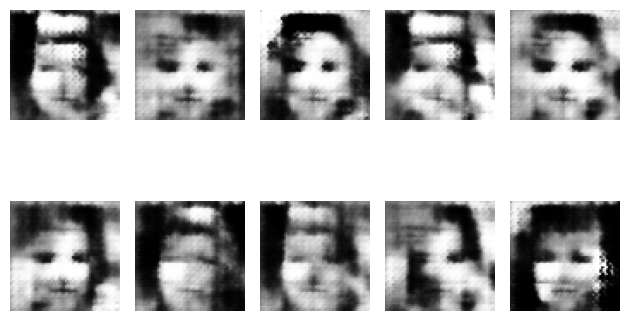

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 0.9297984540462494 GAN 1.4643536806106567
지금 epoch 몇회냐면 295
1/1 [==============================] - 0s 65ms/step


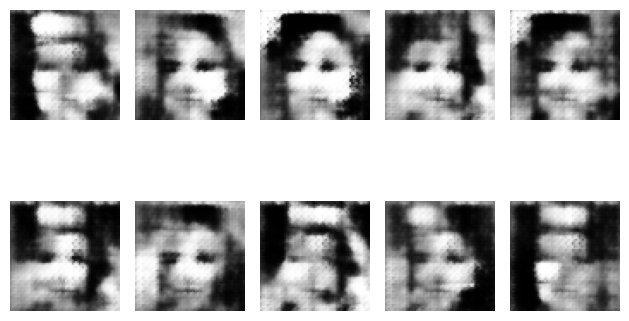

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 0.9194974601268768 GAN 1.503022313117981
지금 epoch 몇회냐면 296
1/1 [==============================] - 0s 56ms/step


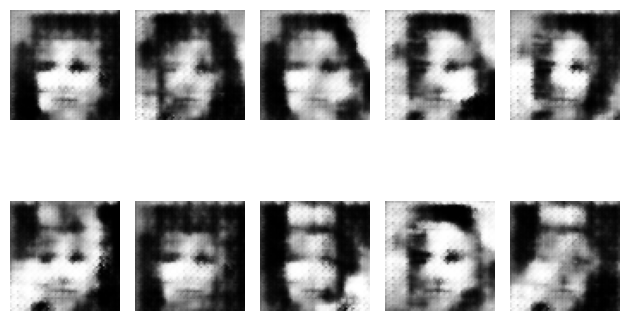

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 9ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 6ms/step
이번 epoch의 최종 loss는 Discriminator 1.0277802646160126 GAN 1.384047031402588
지금 epoch 몇회냐면 297
1/1 [==============================] - 0s 34ms/step


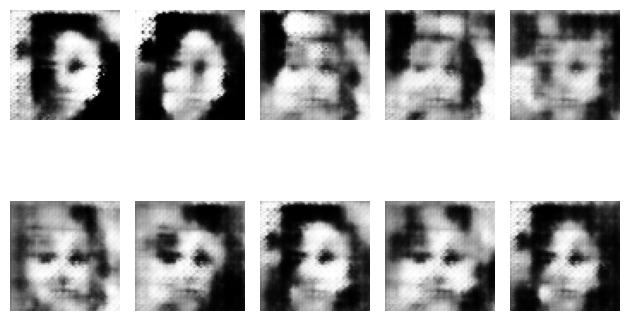

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 7ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.0781209468841553 GAN 1.206315040588379
지금 epoch 몇회냐면 298
1/1 [==============================] - 0s 43ms/step


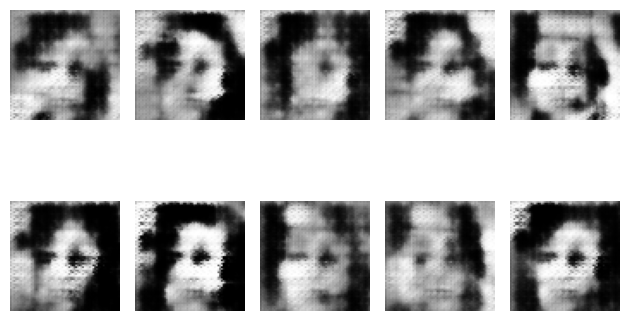

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 6ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.096237301826477 GAN 0.994329571723938
지금 epoch 몇회냐면 299
1/1 [==============================] - 0s 49ms/step


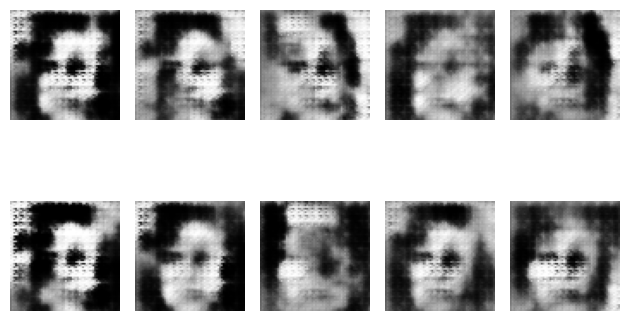

지금 epoch 몇회냐면 0
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 100
4/4 [==============================] - 0s 4ms/step
지금 epoch 몇회냐면 200
4/4 [==============================] - 0s 5ms/step
지금 epoch 몇회냐면 300
4/4 [==============================] - 0s 4ms/step
이번 epoch의 최종 loss는 Discriminator 1.0358571410179138 GAN 0.7052897214889526


In [ ]:
X데이터 = images

for j in range(300):
  # 5만장을 다 사용하는 것이 1 epoch
  # epoch 여러번 돌리기
  print(f'지금 epoch 몇회냐면 {j}')
  predict_pic()
  # f : 글자 중간 {변수} 넣기
  for i in range(50000//128):
    if i % 100 == 0:
      print(f'지금 epoch 몇회냐면 {i}')
    # 이미지 5만장 소진하기
    # discriminator 트레이닝
    # discriminator.train_on_batch(진짜사진 128장, 1로 마킹한 정답들) 형태
    # discriminator.train_on_batch(진짜사진 128장, 0로 마킹한 정답들) 형태
    # 이미지를 넣으면 1 or 0을 출력하는 트레이닝
      진짜사진들 = X데이터[i*128 : (i+1)*128]
      마킹한정답들1 = np.ones(shape = (128,1))
      loss1 = discriminator.train_on_batch(진짜사진들, 마킹한정답들1)

      랜덤숫자 = np.random.uniform(-1, 1, size = (128, 100))
      가짜사진들 = generator.predict(랜덤숫자)
      마킹한정답들0 = np.zeros(shape = (128,1))
      loss2 = discriminator.train_on_batch(가짜사진들, 마킹한정답들0)

      # 진짜사진만 먼저 트레이닝하면 편향이 존재할 것 같으므로
      # generator 트레이닝
      랜덤숫자 = np.random.uniform(-1, 1, size = (128, 100))
      마킹한정답들1 = np.ones(shape = (128,1))
      loss3 = GAN.train_on_batch(랜덤숫자, 마킹한정답들1)

  print(f'이번 epoch의 최종 loss는 Discriminator {loss1+loss2} GAN {loss3}')